# Milo analysis comparing cell abundances across organs in adult gut
Krzysztof Polanski

In [1]:
import scanpy as sc
import numpy as np

import milopy
import milopy.core as milo

Repeat `N1` but only on adult cells. Also group the organs a little differently, with MLN being its own thing, and add covariates to the milo.

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_healthy.no_doublets.annot_all_levels.updated_donorID.20230126.h5ad')
adata = adata[~adata.obs.age_unified.isin([
 '9-12',
 '6-13_first_trimester',
 '4-7',
 '14-20_second_trimester',
 '23-31_preterm'])].copy()
adata.shape

(682040, 36601)

Correct number of cells, continuing. Amanda code to collapse the organ annotation.

In [3]:
#group organs x7 with MLN (mesenteric lymph node) separate this time
adata.obs['organ_groups'] = (
    adata.obs["organ_unified"]
    .map(lambda x: {
        'gingival mucosa':'Oral_mucosa',
 'stomach':'Stomach',
 'duodenum':'Small_intestine',
 'ileum':'Small_intestine',
 'salivary gland':'Salivary_gland',
 'caecum':'Large_intestine',
 'colon':'Large_intestine',
 'MLN':'MLN',
 'ascending colon':'Large_intestine',
 'transverse':'Large_intestine',
 'descending colon':'Large_intestine',
 'sigmoid colon':'Large_intestine',
 'rectum':'Large_intestine',
 'appendix':'Large_intestine',
 'jejunum':'Small_intestine',
 'oesophagus':'Oesophagus',
 'small intestine':'Small_intestine',
 'intestine':'Small_intestine',
 'periodontium':'Oral_mucosa',
 'buccal mucosa':'Oral_mucosa'
                   }.get(x, x))
    .astype("category")
)

In [4]:
adata.obs['organ_groups'].value_counts()

Large_intestine    196043
Stomach            127639
Small_intestine    119108
Oesophagus         112268
Oral_mucosa         73512
MLN                 29376
Salivary_gland      24094
Name: organ_groups, dtype: int64

Amanda code to fix up the annotation a bit.

In [5]:
#update fine_annot
adata.obs['fine_annot'] = (adata.obs['fine_annot']
        .map(lambda x:{'TA':'TA_cycling',
                       'BEST4':'BEST4_enterocyte_colonocyte',
                      'DSC_MUC17':'DCS_MUC17',
                      'DSC_MUC17':'DCS_MUC17_cycling',
                      'MUC6':'Mucous_gland_neck',
                      'MUC5AC':'Surface_foveolar',
                      'Late_colonocyte':'Mature_colonocyte'}.get(x,x)).astype('category'))

Prepare for milo. Generate a neighbourhood, keeping the neighbour count in line with the 50 in the tutorial. Fix scVI coordinates - their current data type upsets milo.

In [6]:
sc.pp.neighbors(adata, use_rep = "X_scvi", n_neighbors = 50, key_added="scvi")
#this is a data frame and milo minds that
adata.obsm['X_scvi'] = adata.obsm['X_scvi'].values.copy()

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Alright, run the thing!

In [7]:
milo.make_nhoods(adata, neighbors_key="scvi")

Cool. Onward!

(array([3.200e+01, 8.800e+01, 1.450e+02, 3.000e+02, 4.380e+02, 8.960e+02,
        8.110e+02, 9.940e+02, 1.127e+03, 1.204e+03, 1.357e+03, 2.341e+03,
        1.573e+03, 1.657e+03, 1.782e+03, 1.789e+03, 1.777e+03, 2.684e+03,
        1.834e+03, 1.792e+03, 1.744e+03, 1.732e+03, 1.662e+03, 2.425e+03,
        1.497e+03, 1.432e+03, 1.319e+03, 1.343e+03, 1.229e+03, 1.801e+03,
        1.076e+03, 9.690e+02, 9.720e+02, 8.660e+02, 8.110e+02, 1.138e+03,
        6.790e+02, 6.570e+02, 5.880e+02, 5.160e+02, 4.900e+02, 6.730e+02,
        4.130e+02, 3.770e+02, 3.320e+02, 3.160e+02, 3.070e+02, 3.830e+02,
        2.070e+02, 2.090e+02, 1.850e+02, 1.730e+02, 2.340e+02, 1.380e+02,
        1.220e+02, 1.200e+02, 9.400e+01, 8.600e+01, 1.180e+02, 5.800e+01,
        7.800e+01, 5.100e+01, 4.200e+01, 5.400e+01, 5.100e+01, 3.300e+01,
        2.300e+01, 2.900e+01, 2.400e+01, 1.800e+01, 3.100e+01, 1.700e+01,
        1.200e+01, 1.200e+01, 9.000e+00, 1.000e+01, 9.000e+00, 9.000e+00,
        7.000e+00, 7.000e+00, 7.000e+0

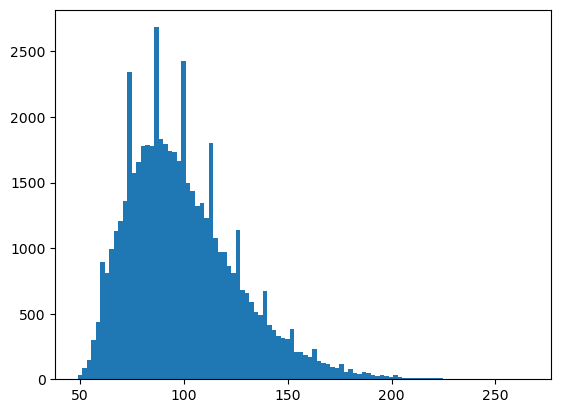

In [8]:
import matplotlib.pyplot as plt

nhood_size = np.array(adata.obsm["nhoods"].sum(0)).ravel()
plt.hist(nhood_size, bins=100)

Milo plot prep.

Churn the milos like in `N1`. SI first.

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/rpy2/robjects/vectors.py:1010: UserWarning: R object inheriting from "POSIXct" but without attribute "tzone".
  warnings.warn('R object inheriting from "POSIXct" but without '
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/pandas/core/arrays/datetimes.py:2236: PytzUsageWarning: The zone attribute is specific to pytz's interface; please migrate to a new time zone provider. For more details on how to do so, see https://pytz-deprecation-shim.readthedocs.io/en/latest/migration.html
  values, tz_parsed = conversion.datetime_to_datetime64(data.ravel("K"))
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning:

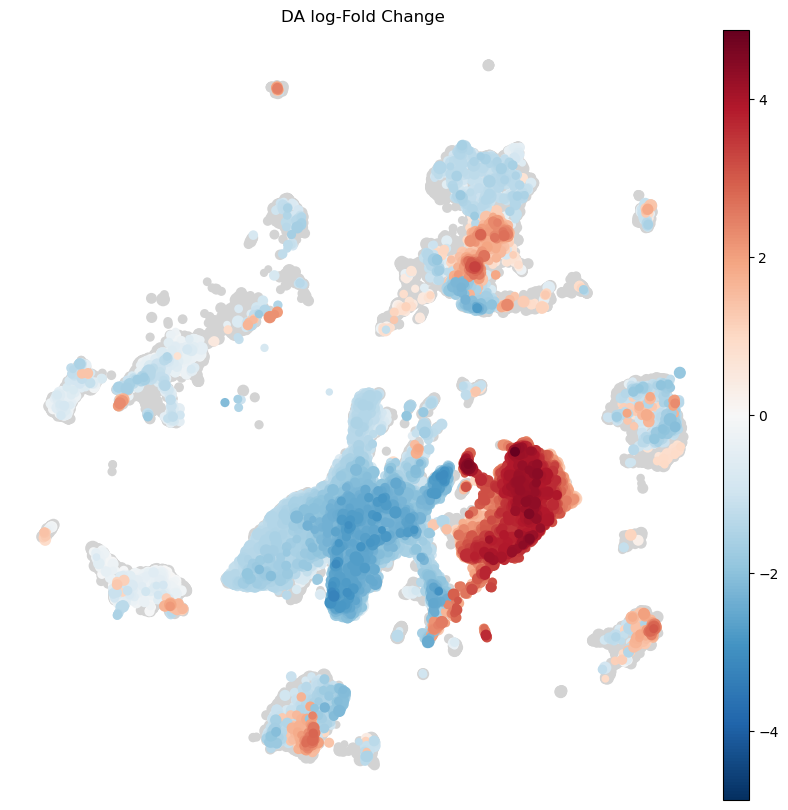

In [10]:
#make 1 vs all categories for running milo
adata.obs['SI_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 'Stomach':"rest",
 #'Small_intestine':'rest',
 'Salivary_gland':'rest',
 'Large_intestine':'rest',
 'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ SI_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='SI_vs_allSmall_intestine-SI_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


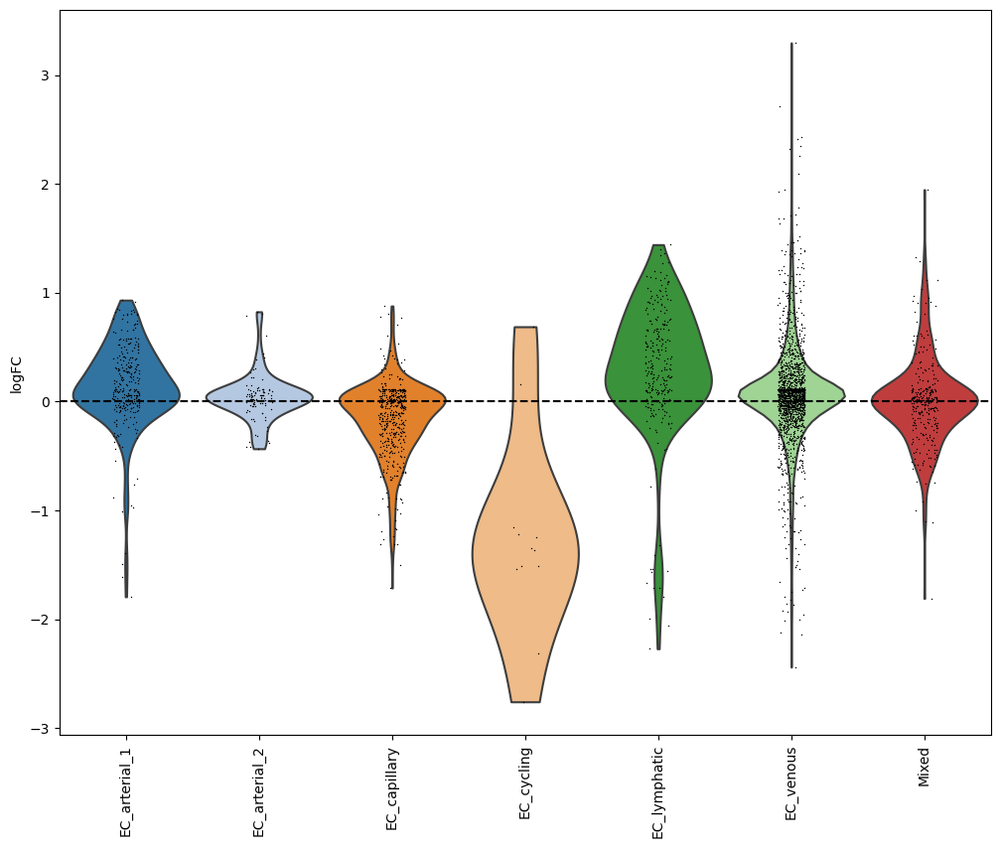

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


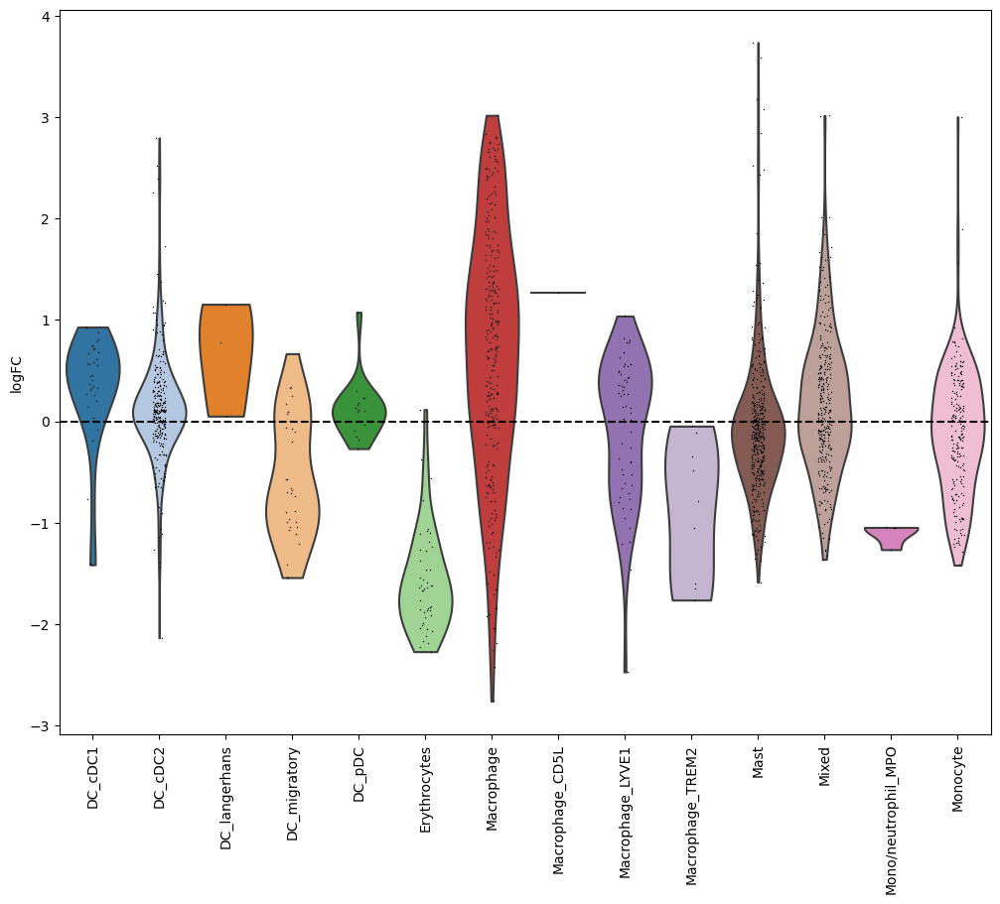

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


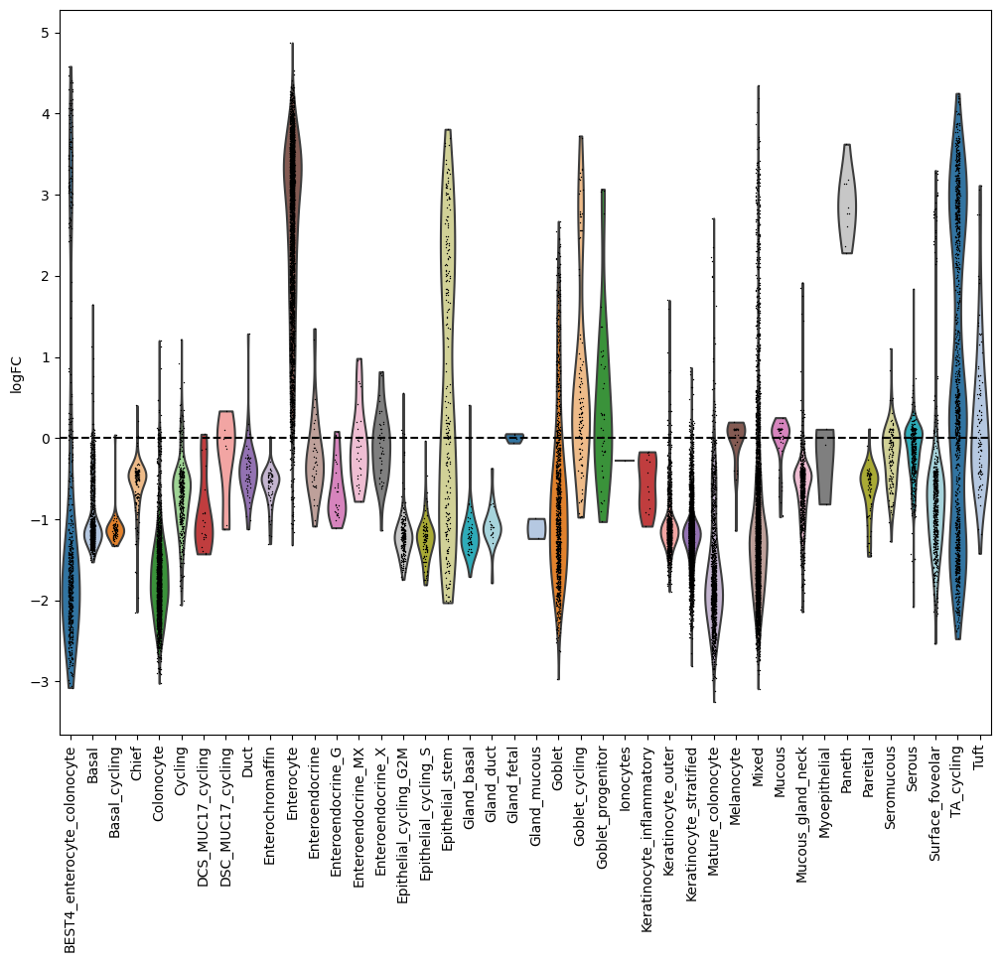

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


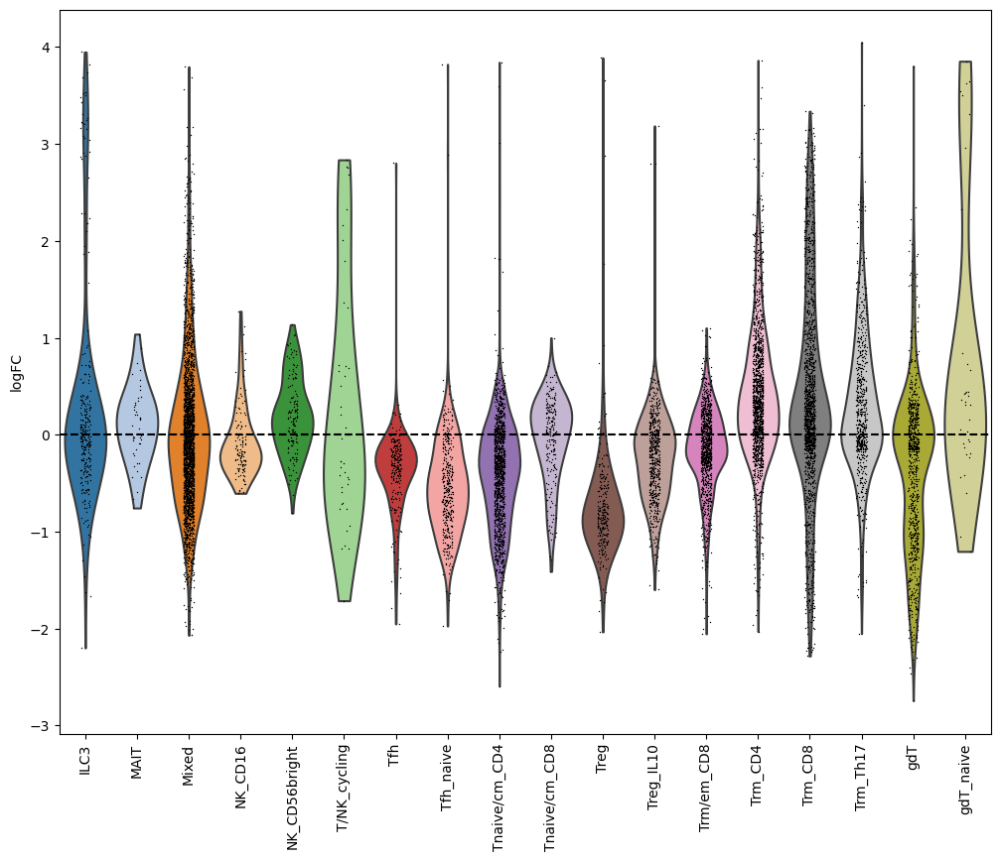

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


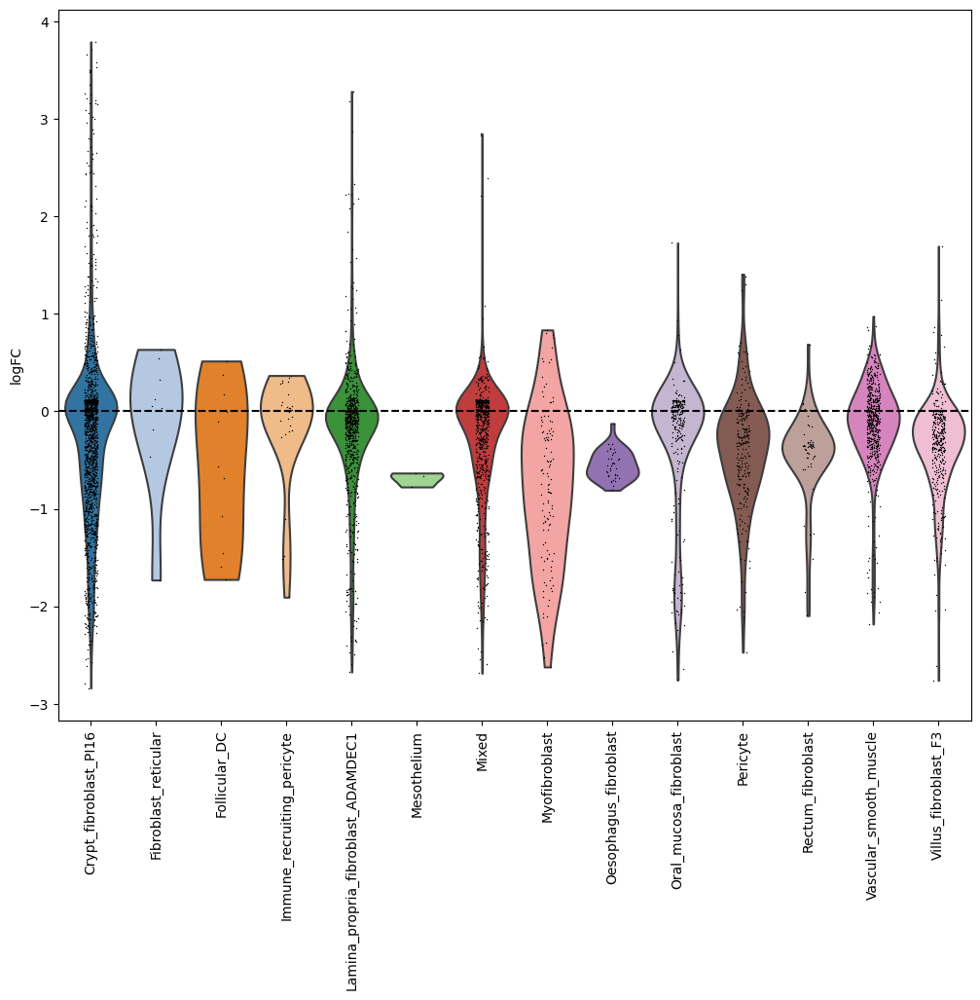

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


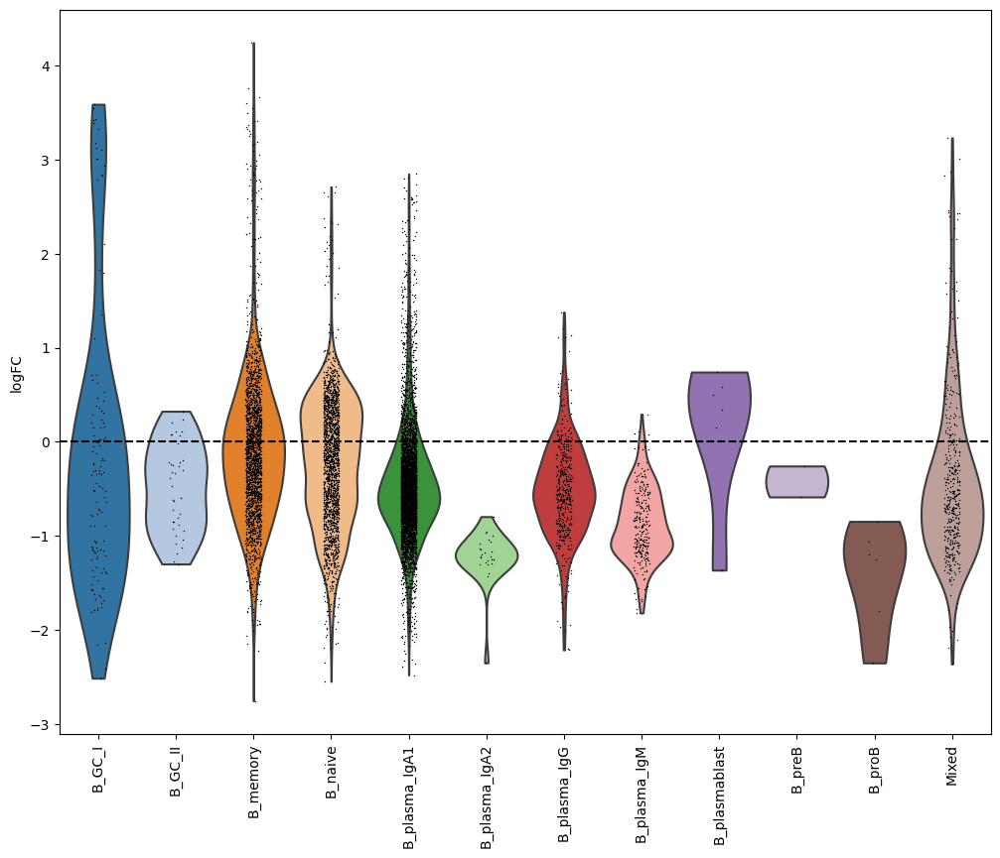

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


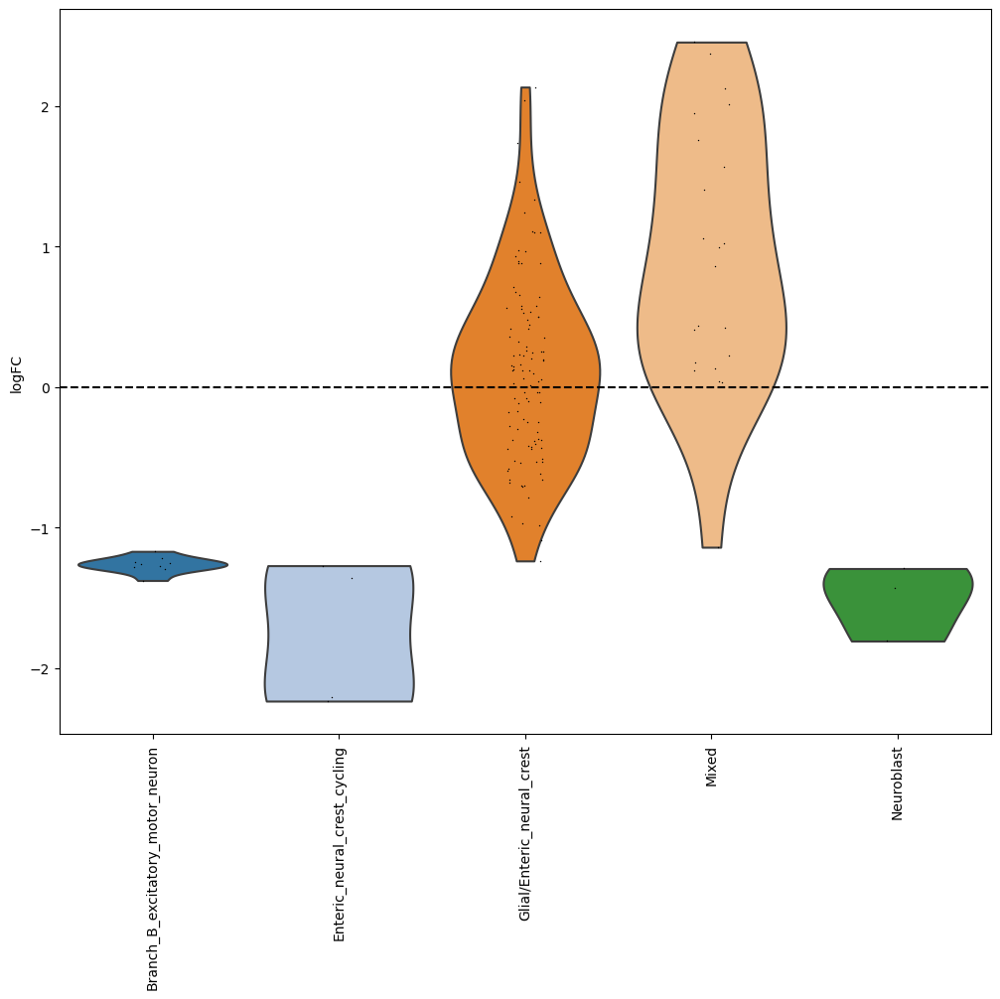

In [11]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

Of note, this `.tolist()` stuff is no longer necessary if the newest milopy were to be installed from GitHub, I PR'd in a fix that does this at the time the data is saved to the object.

In [12]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_SI'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Alright, next comparison! LI!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


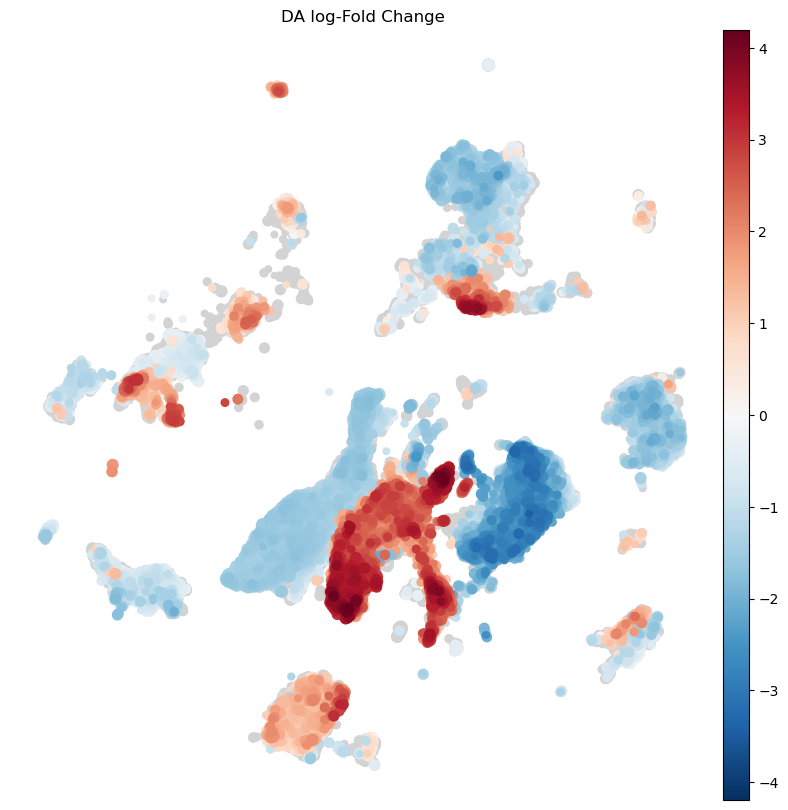

In [13]:
adata.obs['LI_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 'Stomach':"rest",
 'Small_intestine':'rest',
 'Salivary_gland':'rest',
 #'Large_intestine':'rest',
 'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ LI_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='LI_vs_allLarge_intestine-LI_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


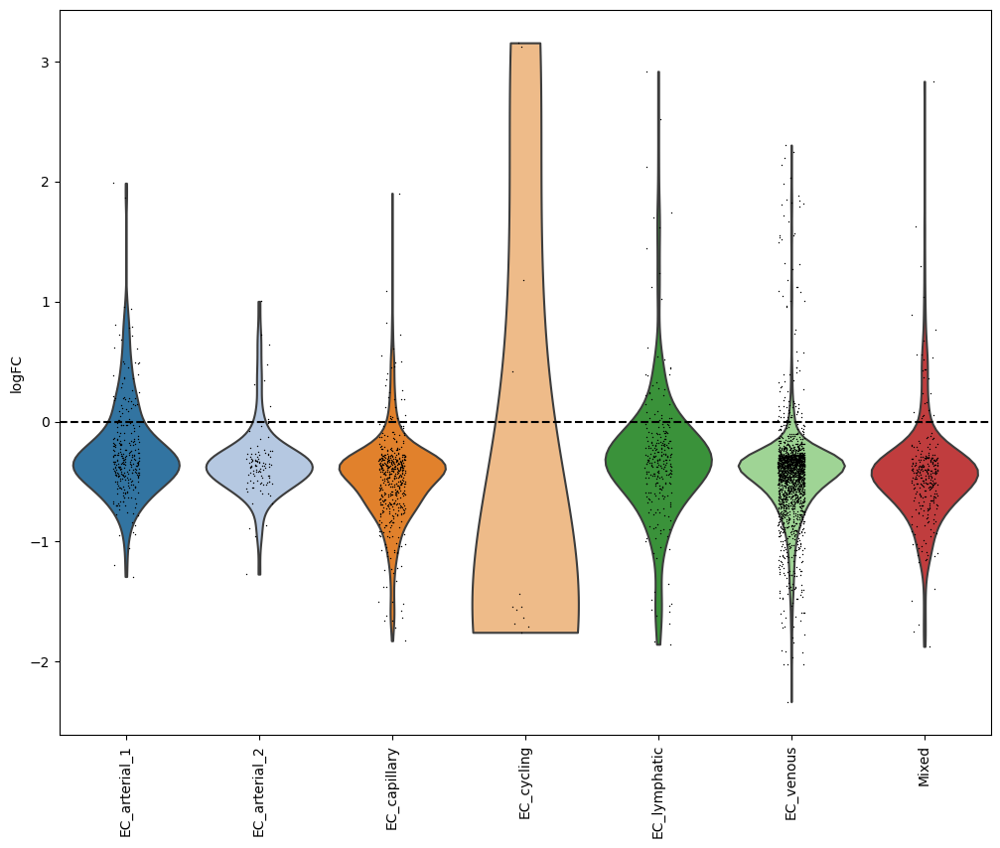

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


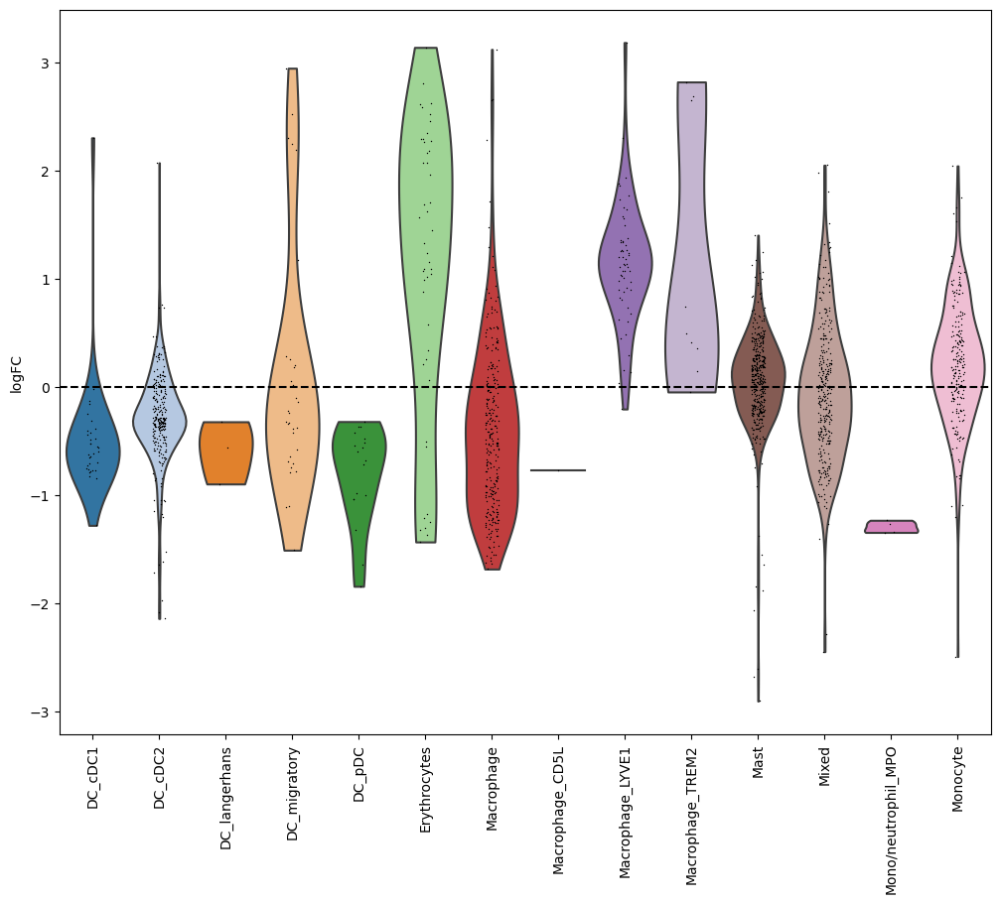

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


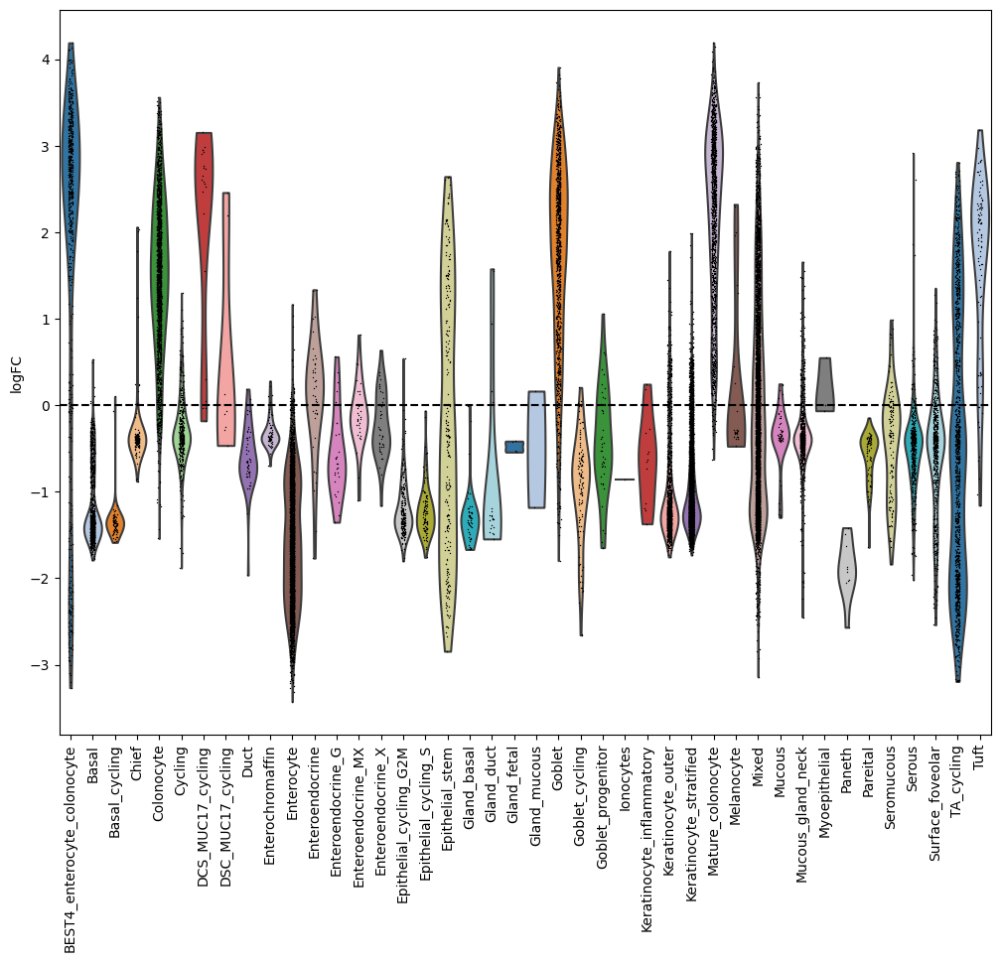

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


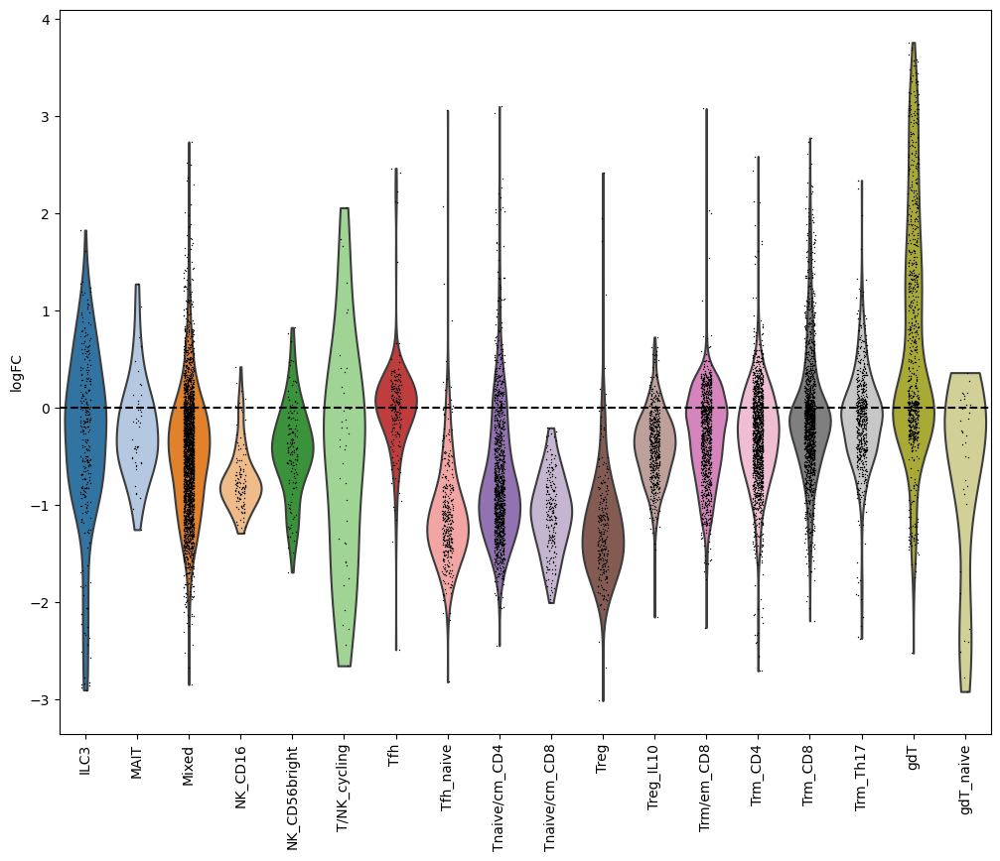

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


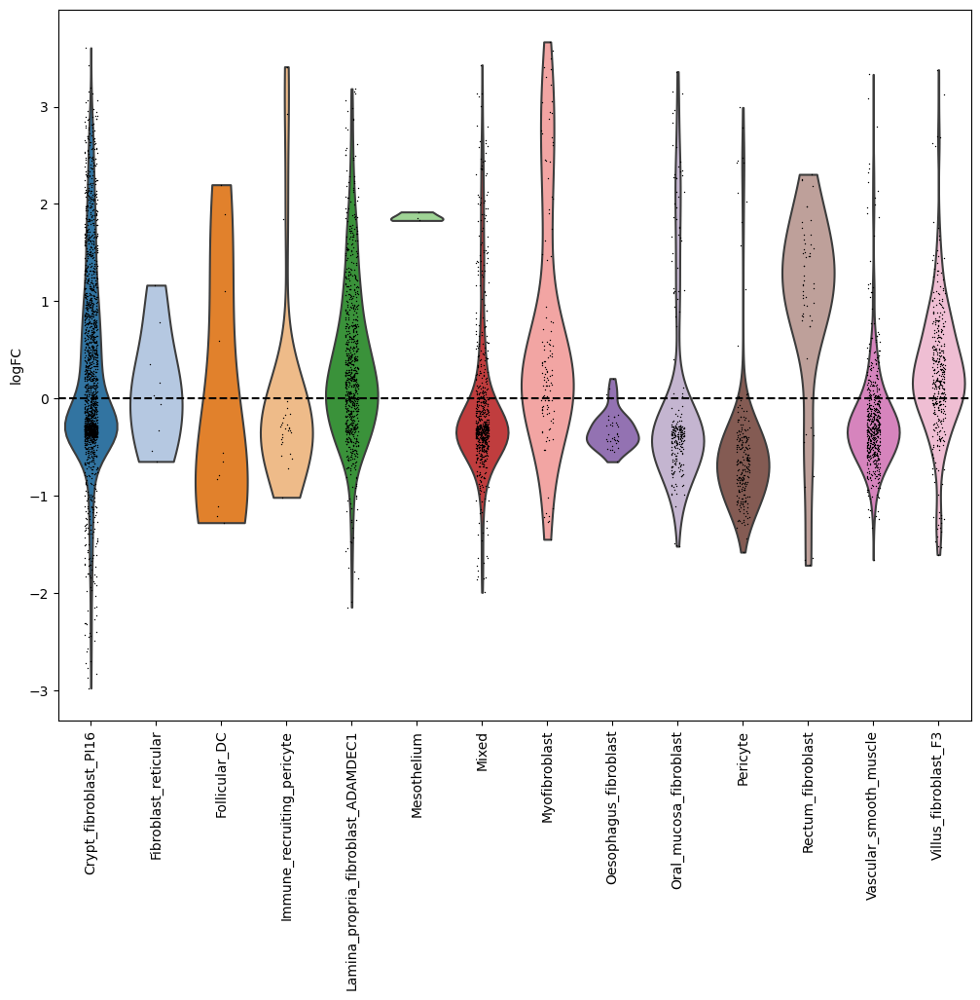

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


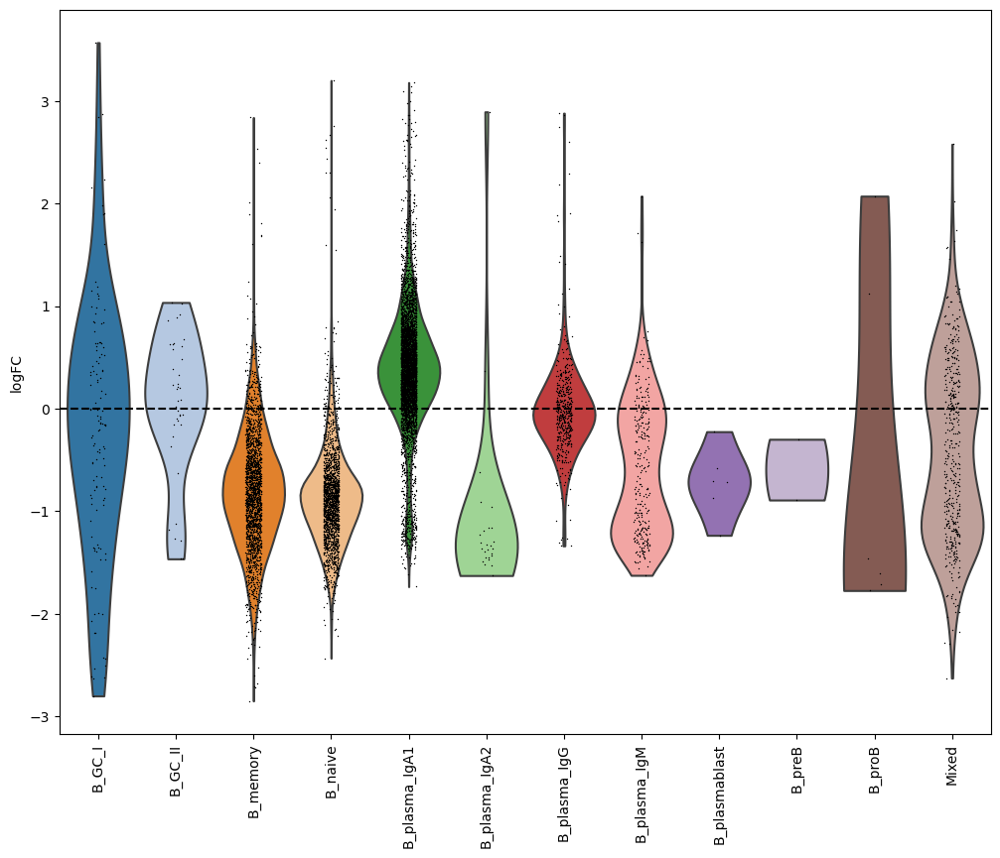

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


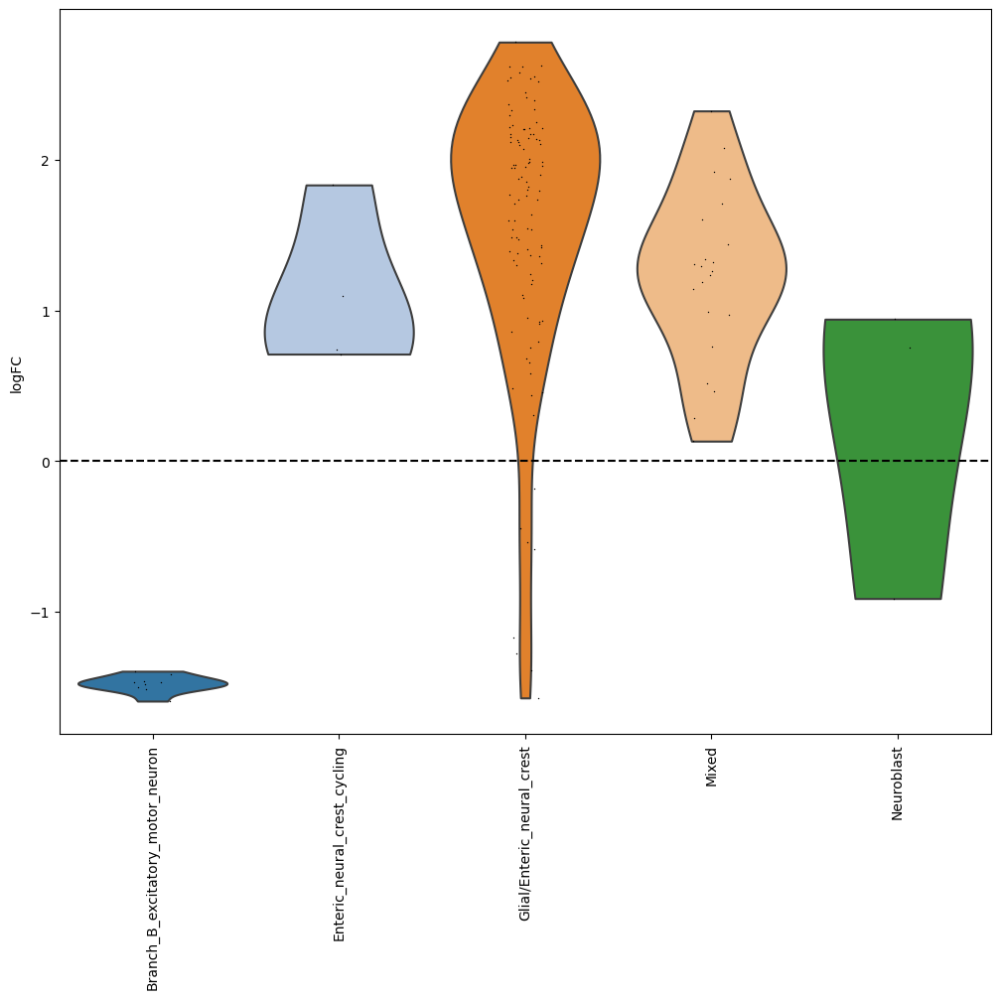

In [14]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [15]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_LI'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Next! Stomach!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


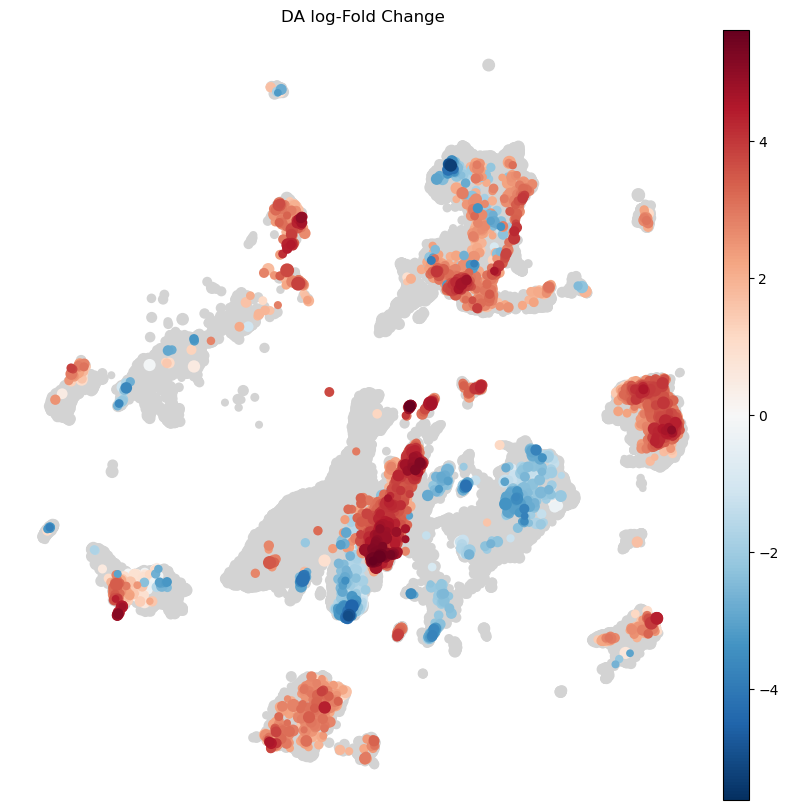

In [16]:
adata.obs['stomach_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 #'Stomach':"rest",
 'Small_intestine':'rest',
 'Salivary_gland':'rest',
 'Large_intestine':'rest',
 'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ stomach_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='stomach_vs_allStomach-stomach_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


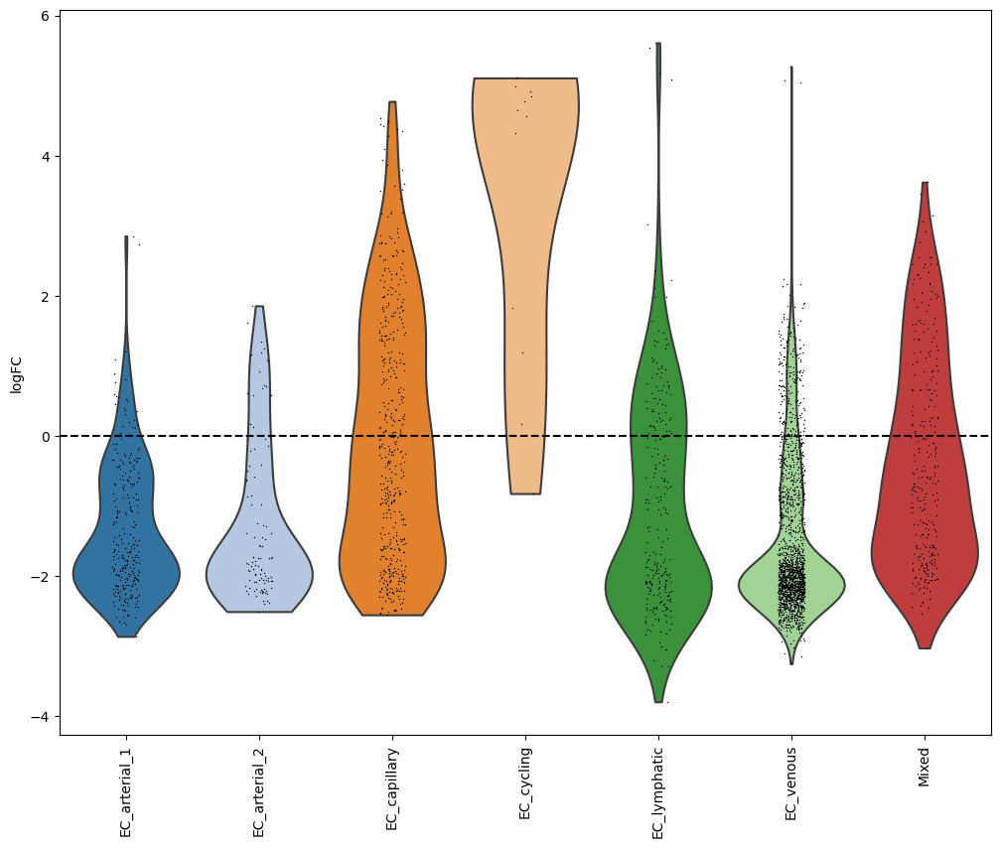

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


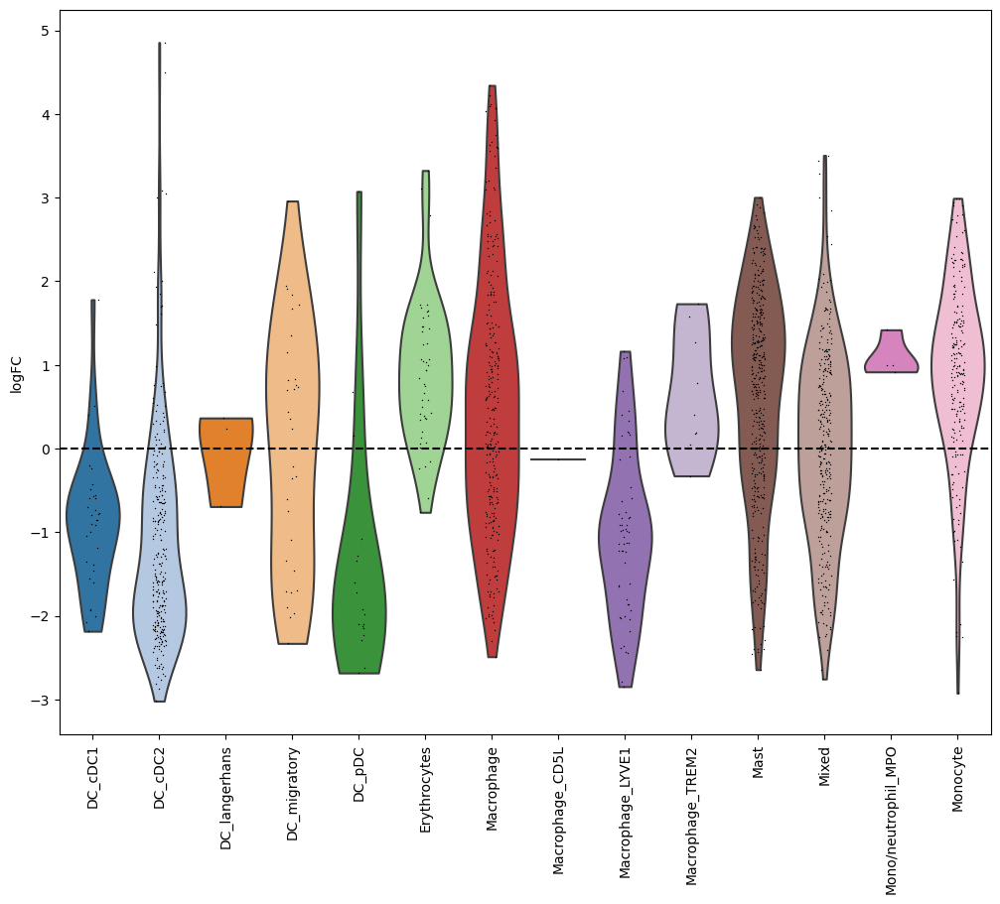

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


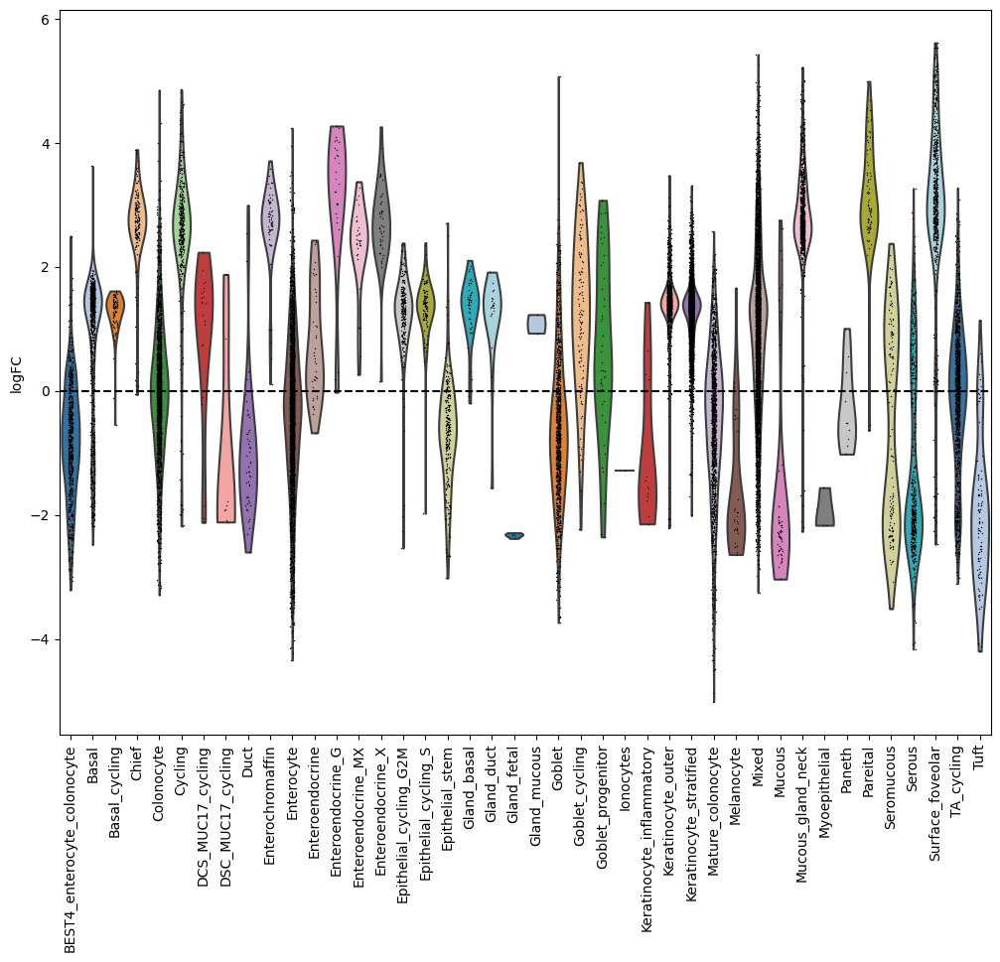

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


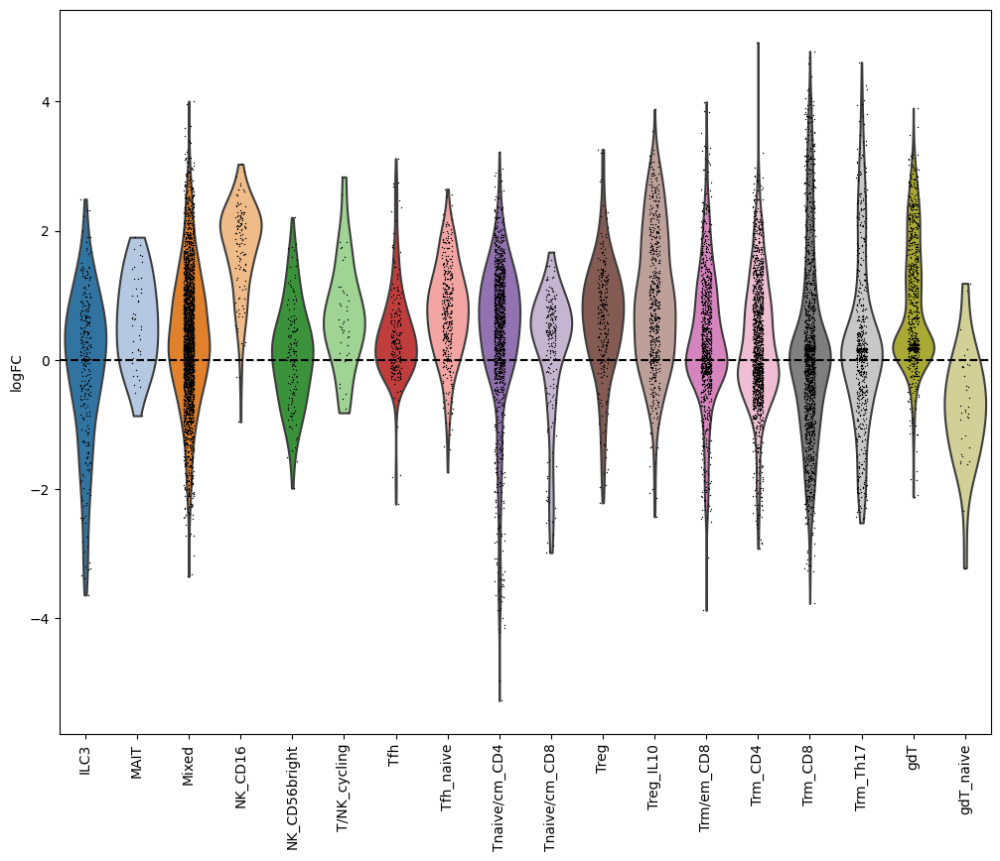

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


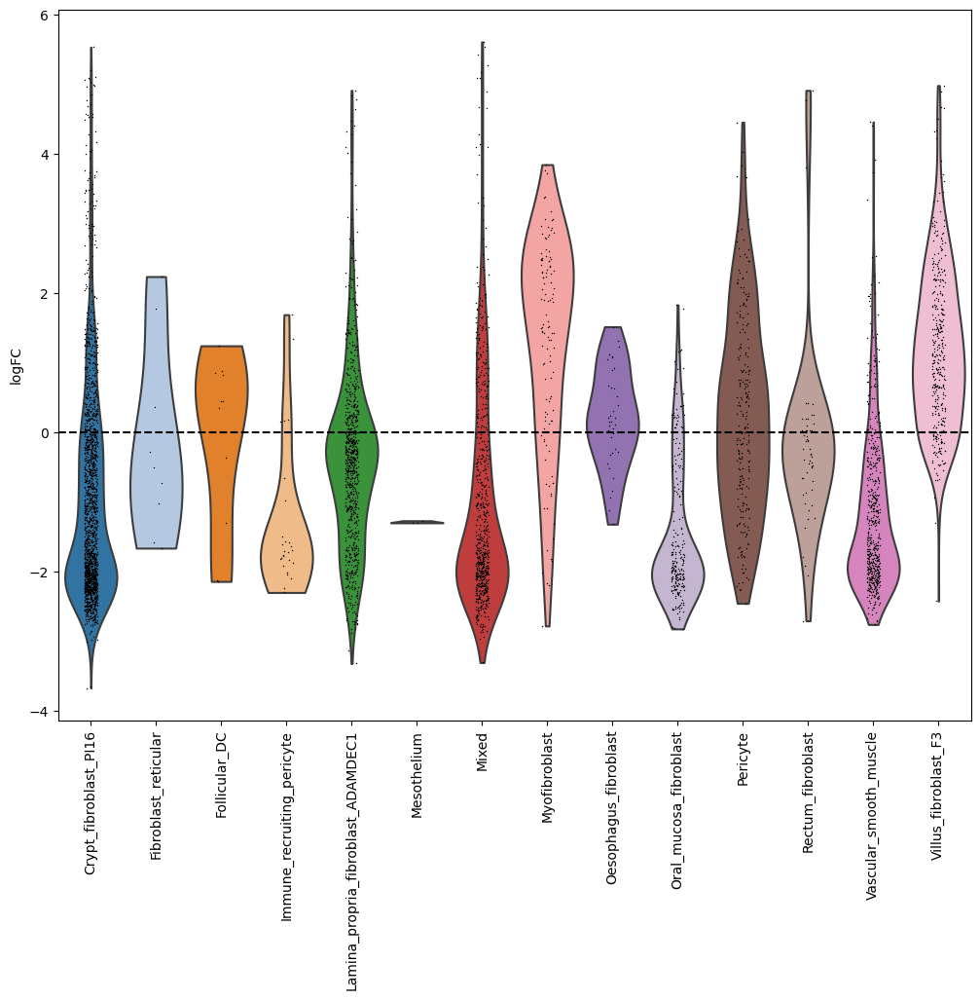

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


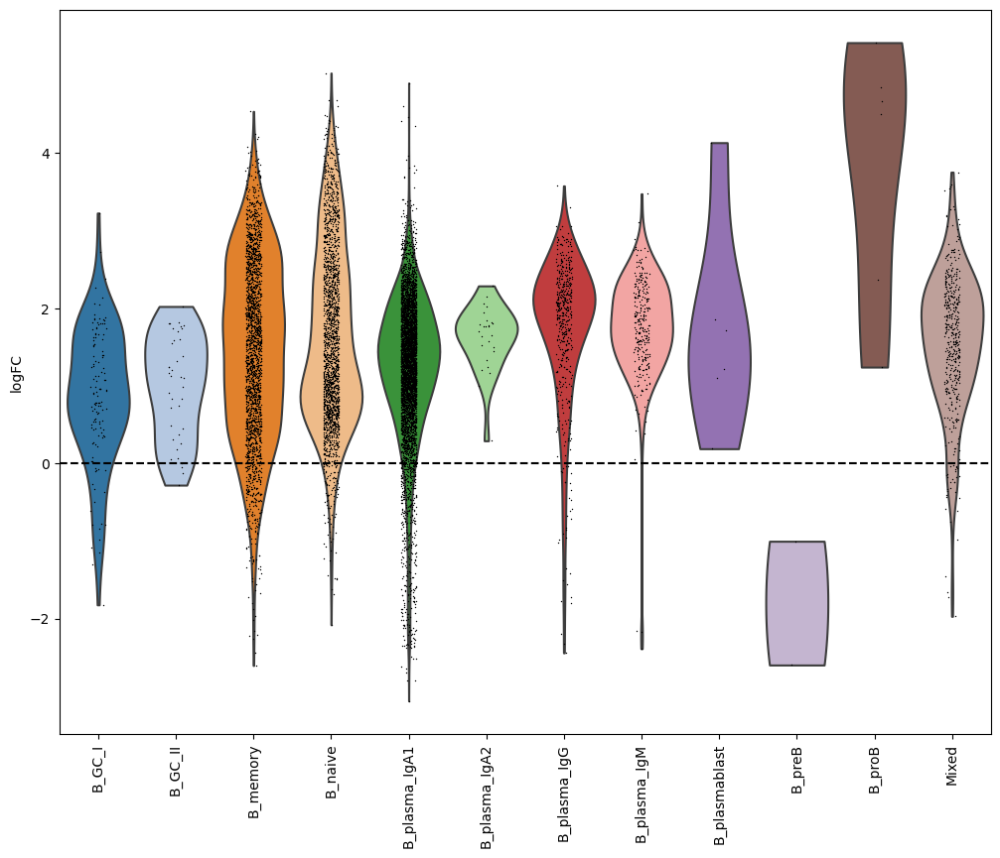

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


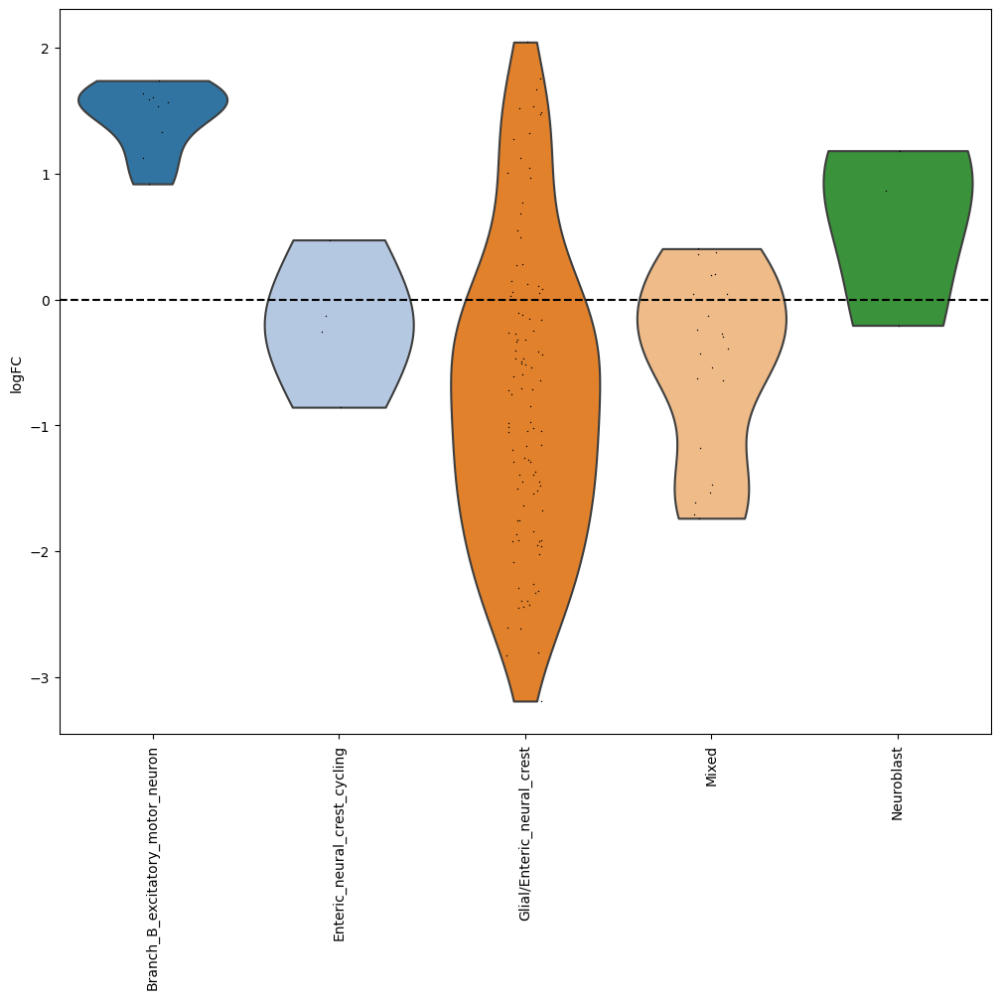

In [17]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [18]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_stomach'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Next! Oesophagus!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


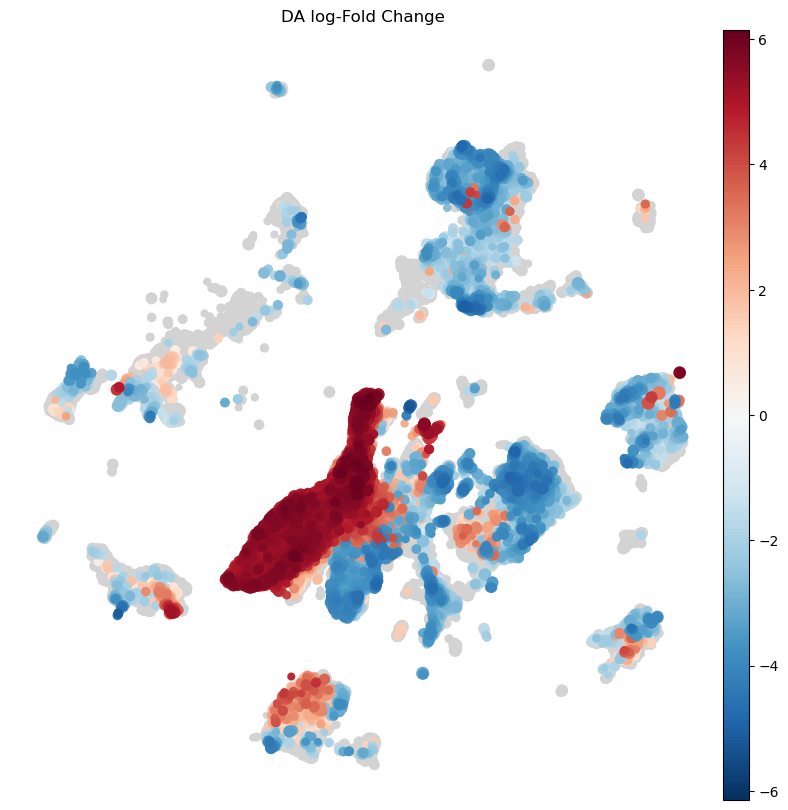

In [19]:
adata.obs['oesophagus_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 'Stomach':"rest",
 'Small_intestine':'rest',
 'Salivary_gland':'rest',
 'Large_intestine':'rest',
 'MLN':'rest',
 #'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ oesophagus_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='oesophagus_vs_allOesophagus-oesophagus_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


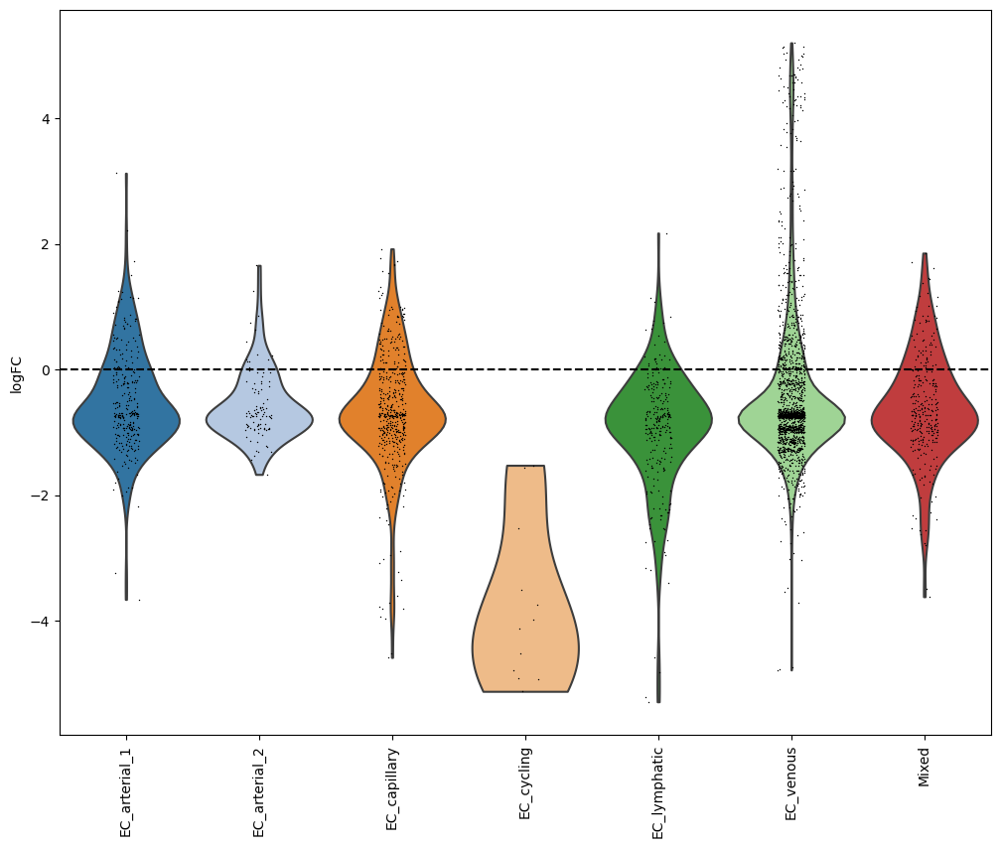

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


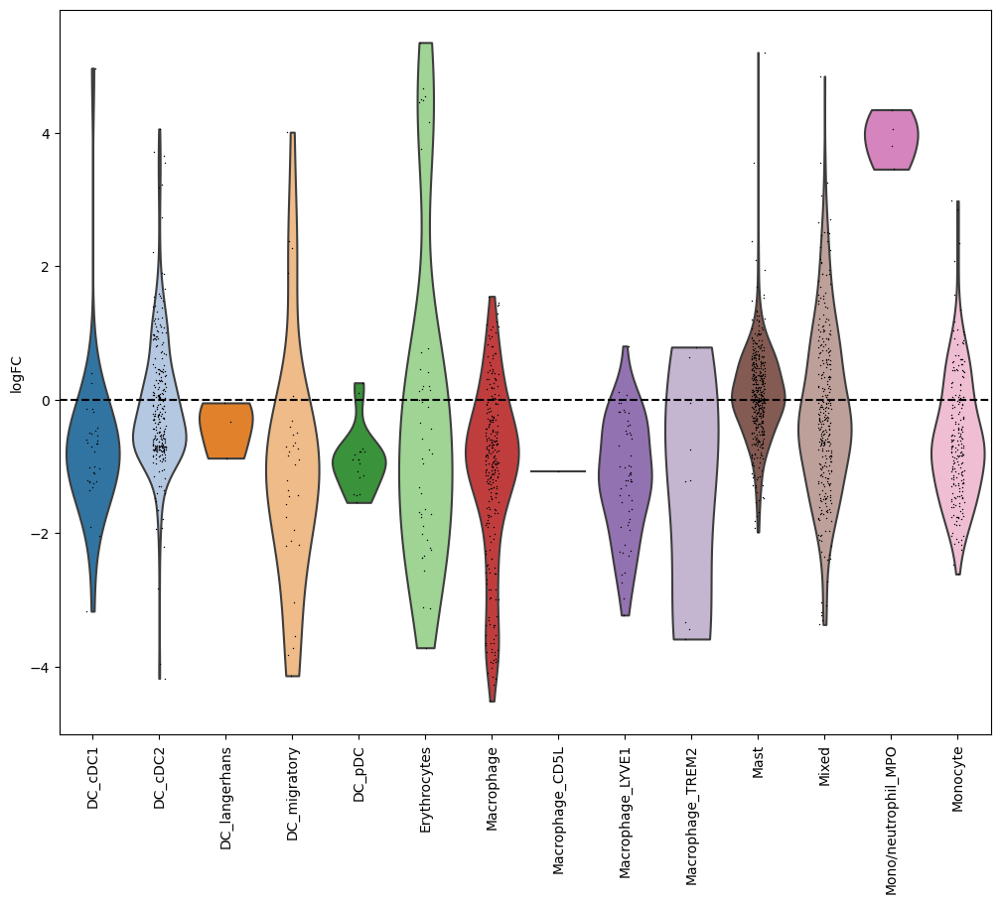

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


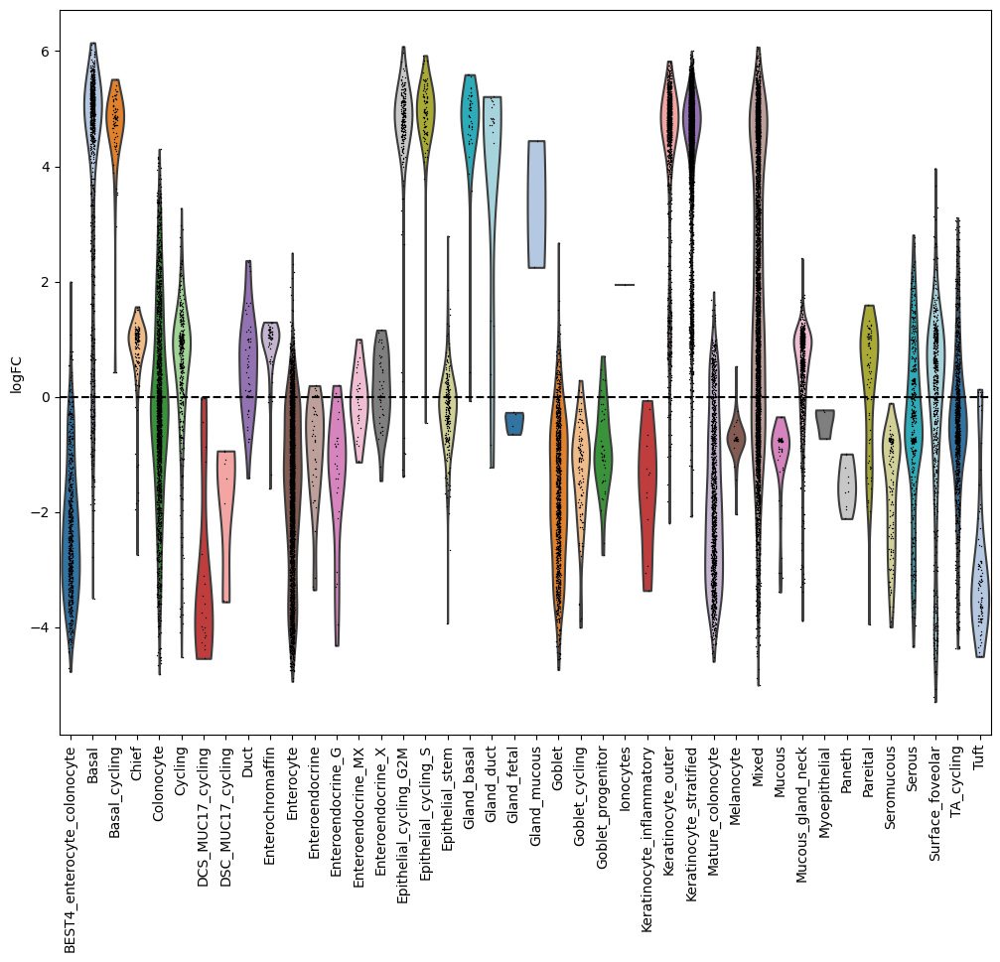

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


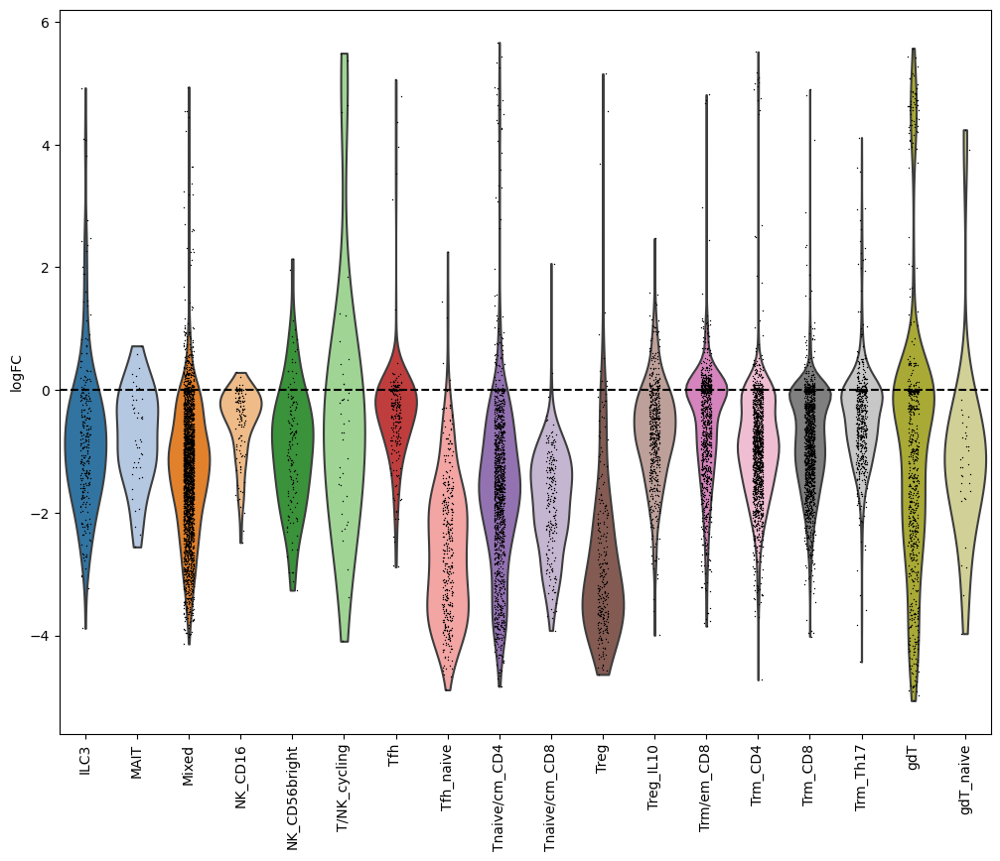

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


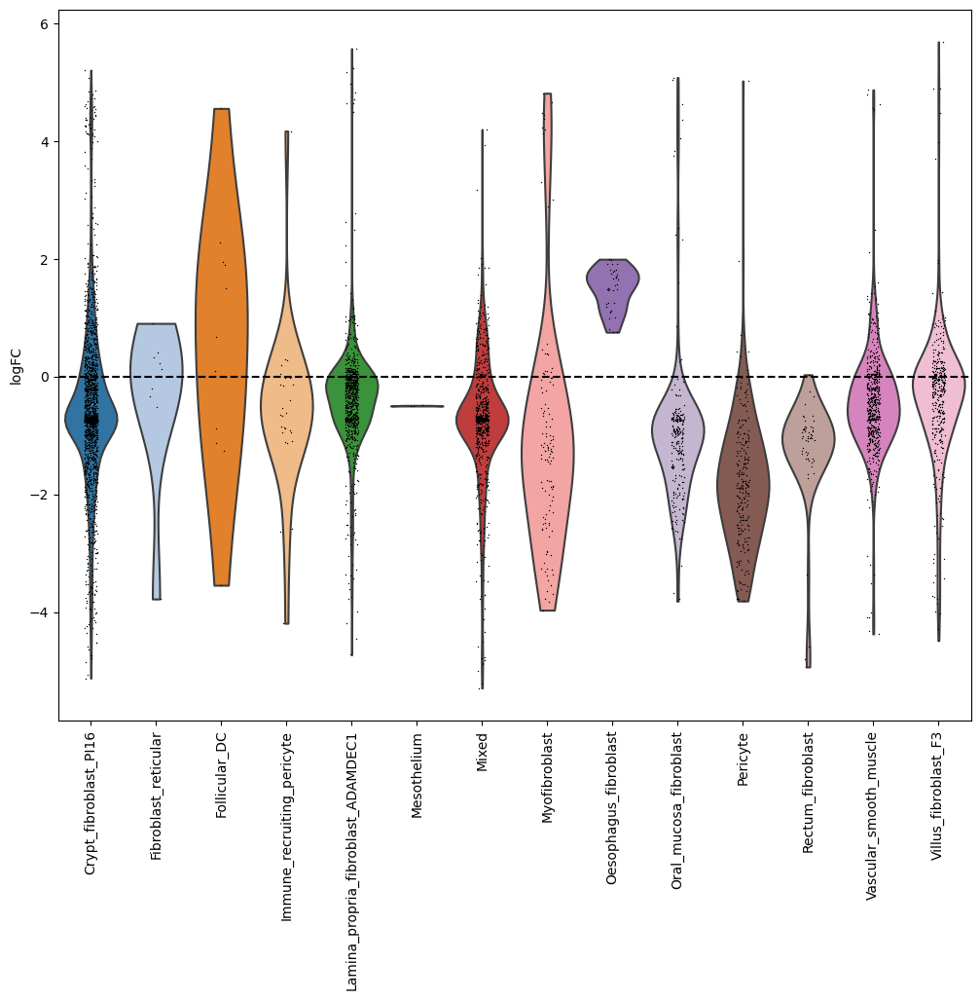

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


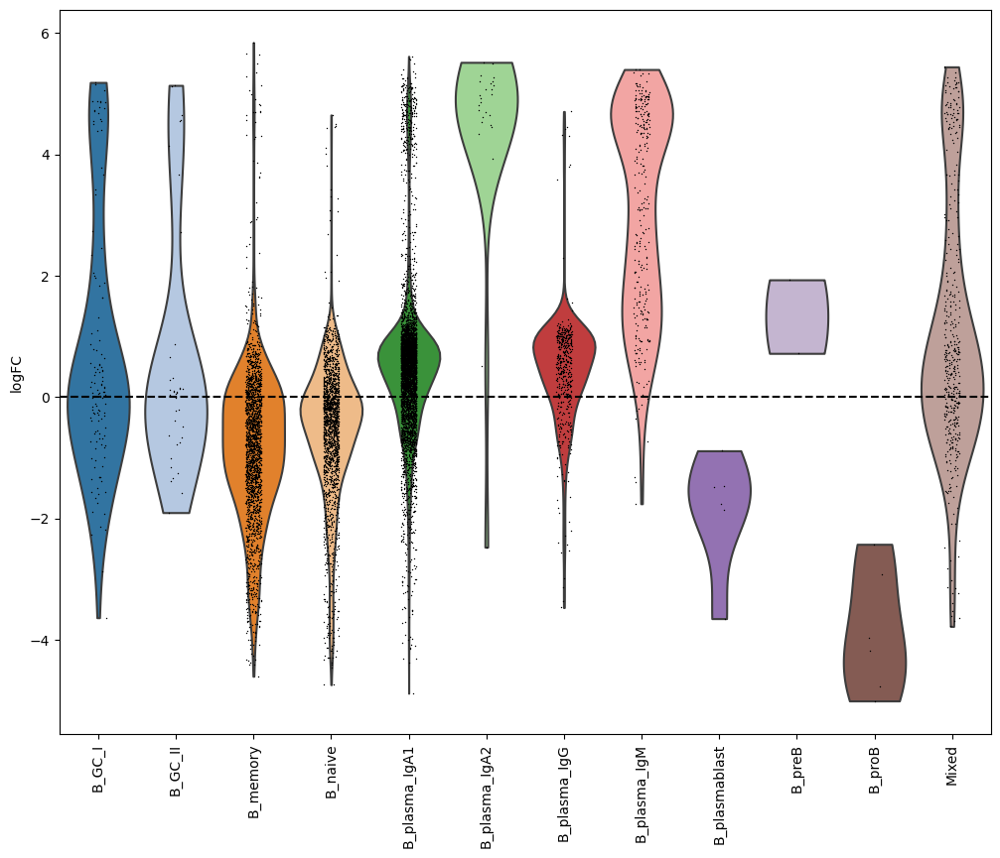

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


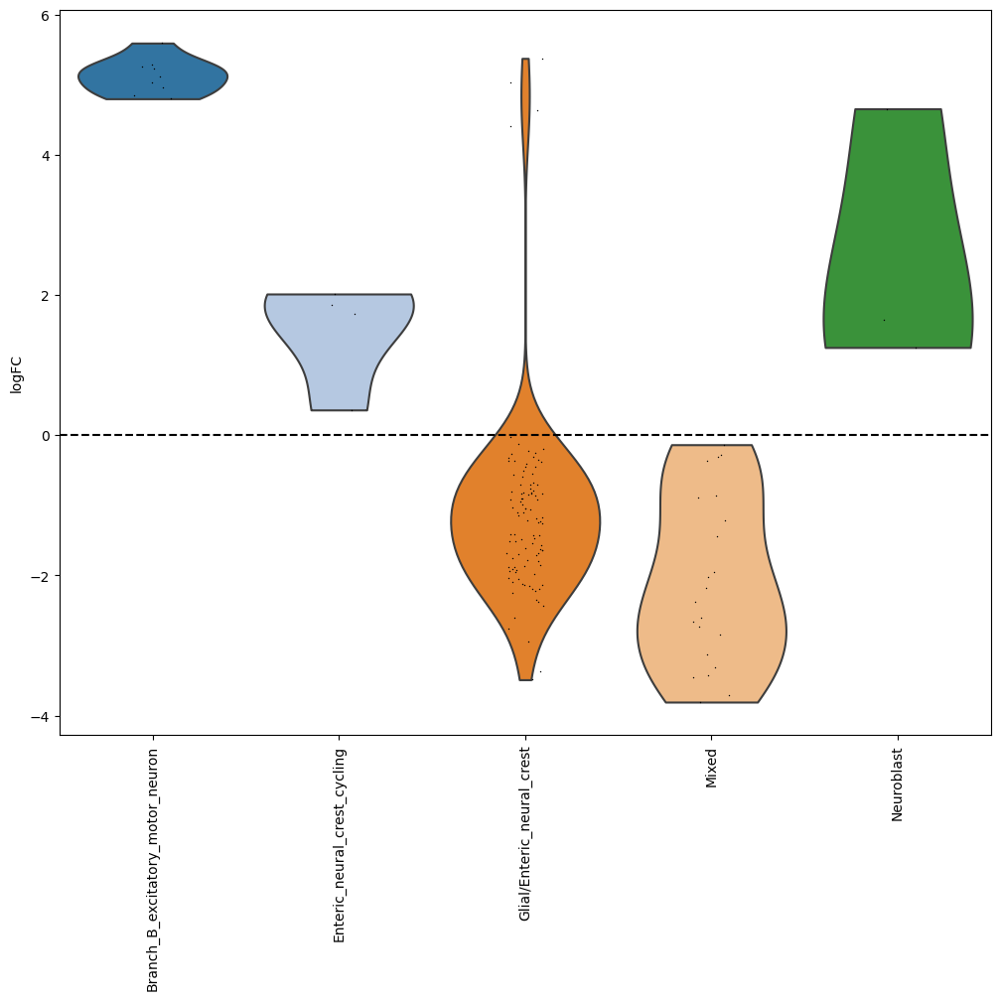

In [20]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [21]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_oesophagus'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Next! Salivary!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


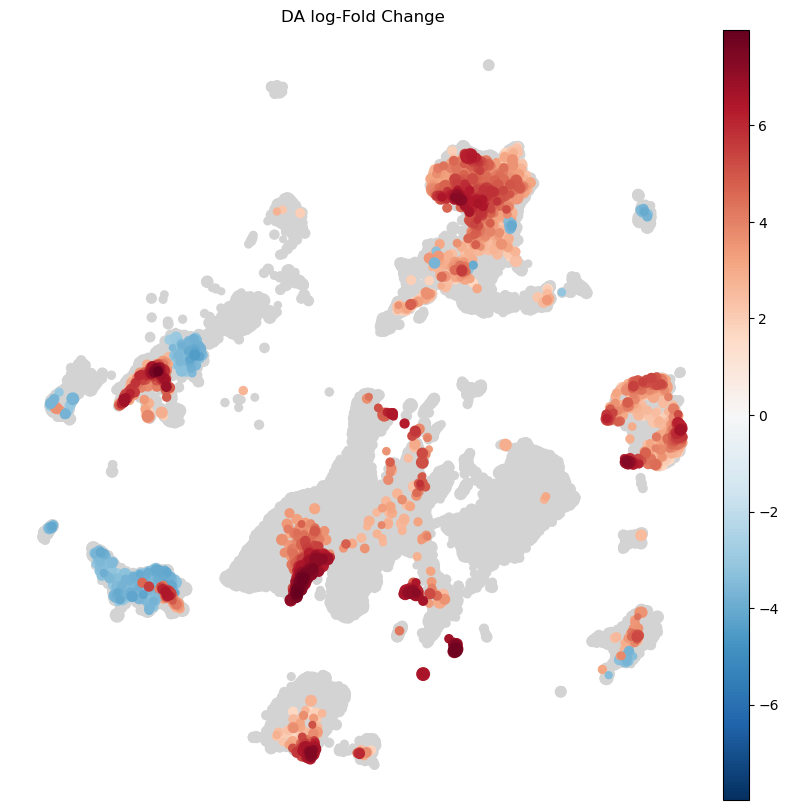

In [22]:
adata.obs['salivary_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 'Stomach':"rest",
 'Small_intestine':'rest',
 #'Salivary_gland':'rest',
 'Large_intestine':'rest',
 'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ salivary_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='salivary_vs_allSalivary_gland-salivary_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


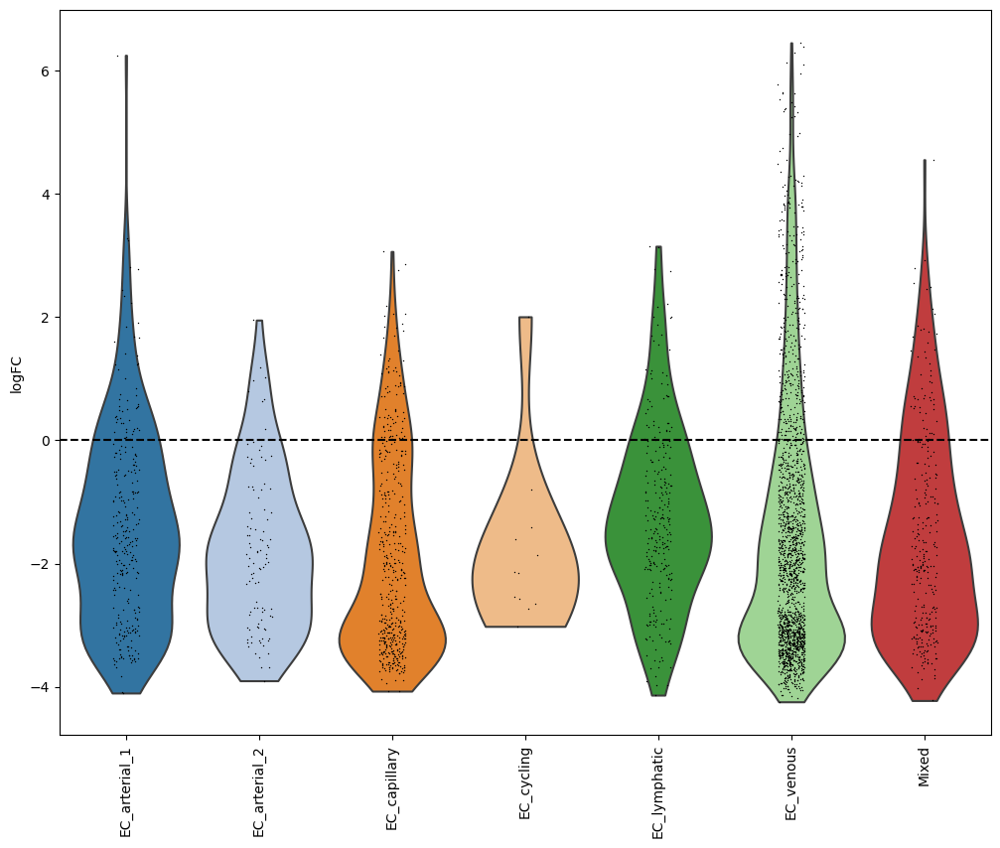

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


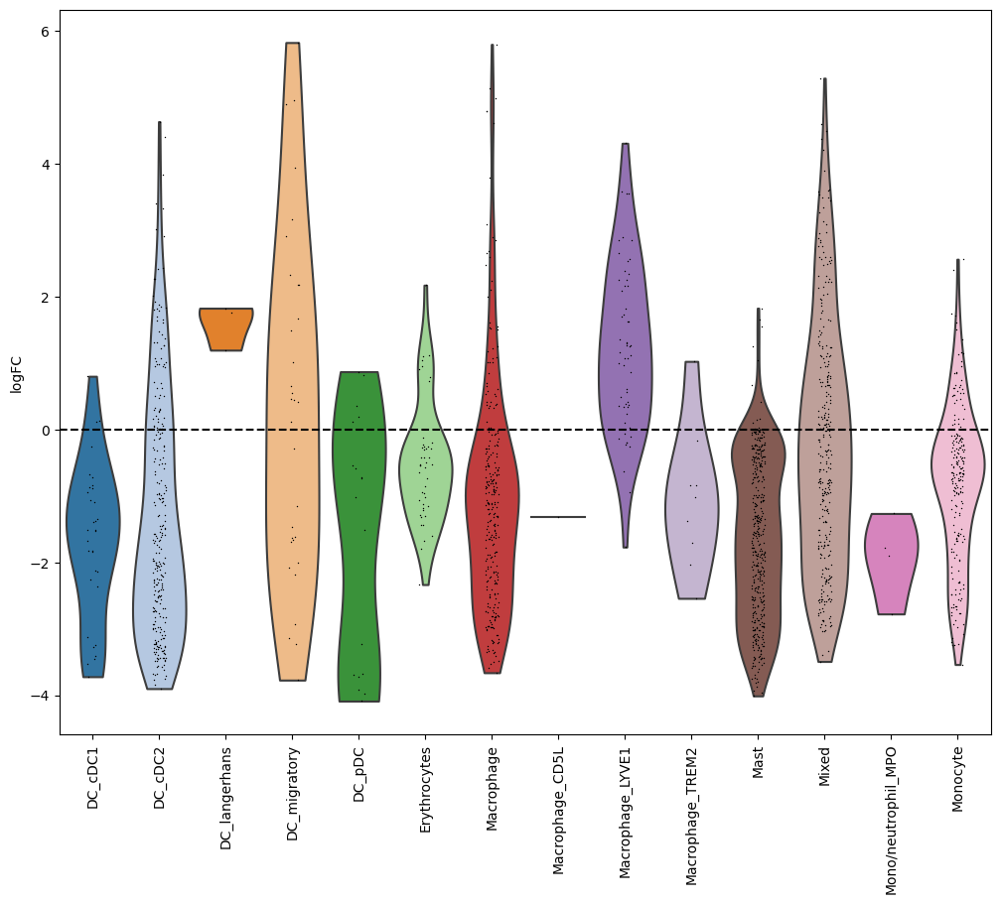

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


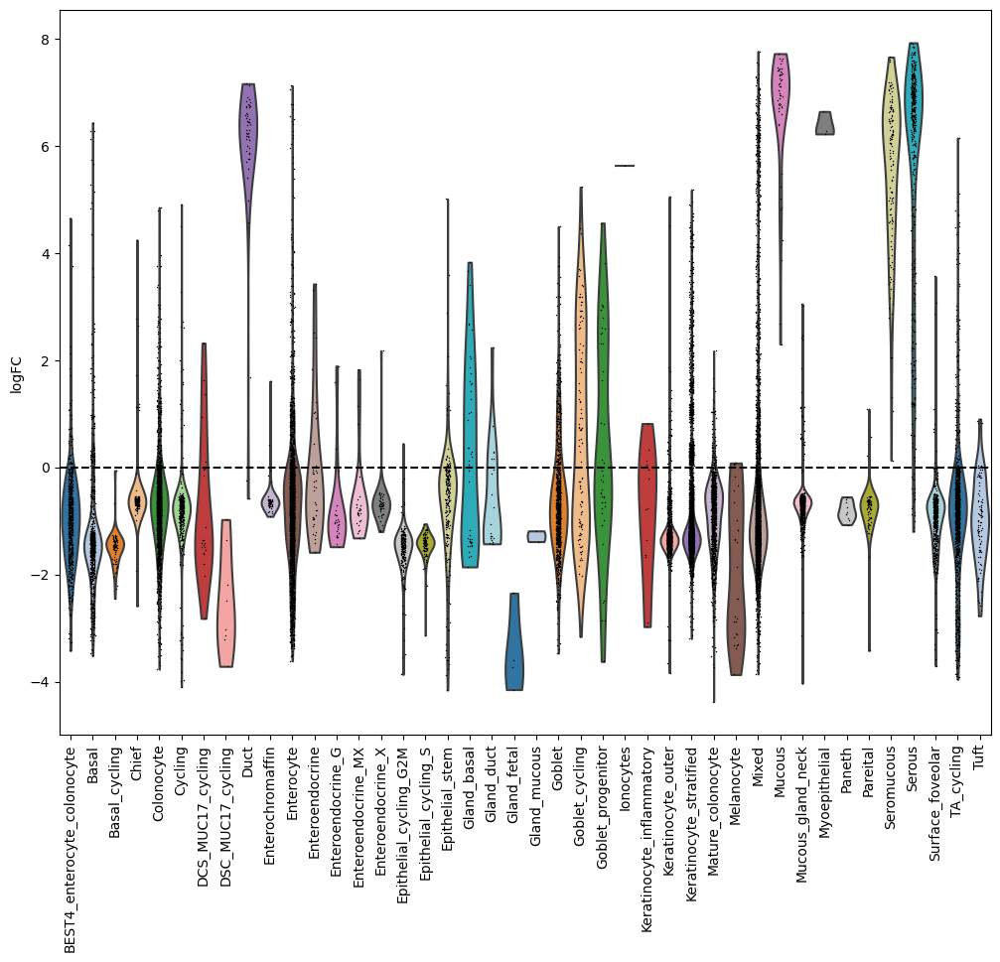

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


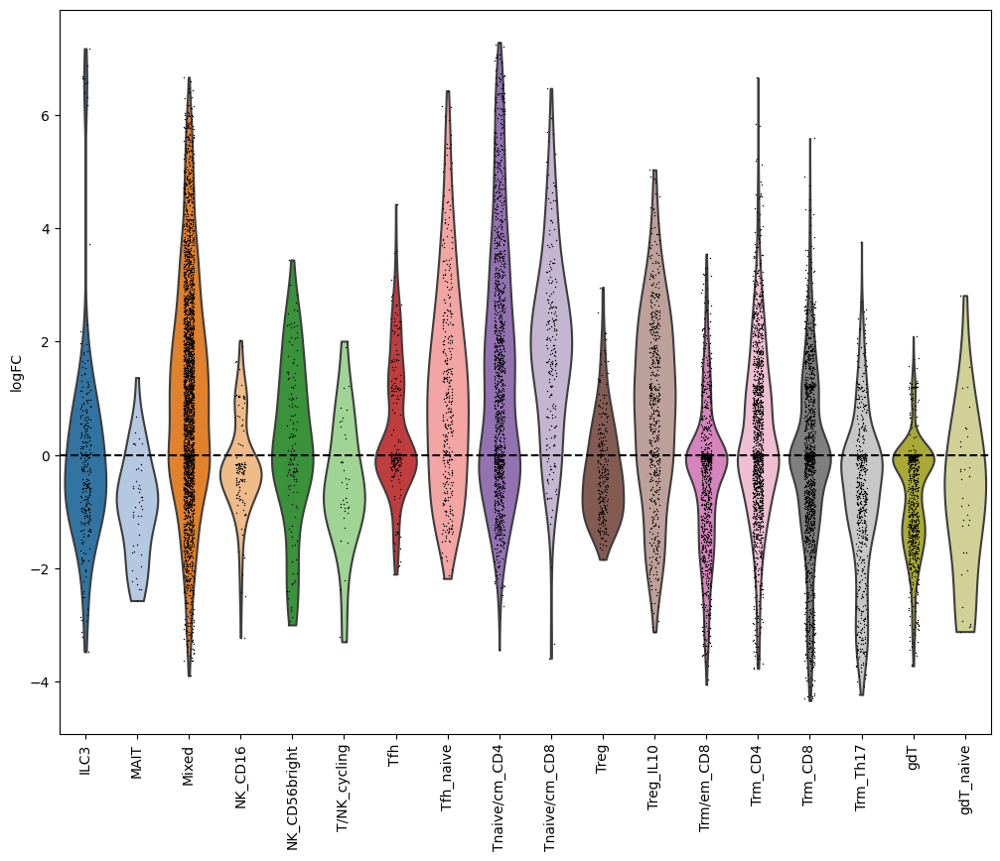

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


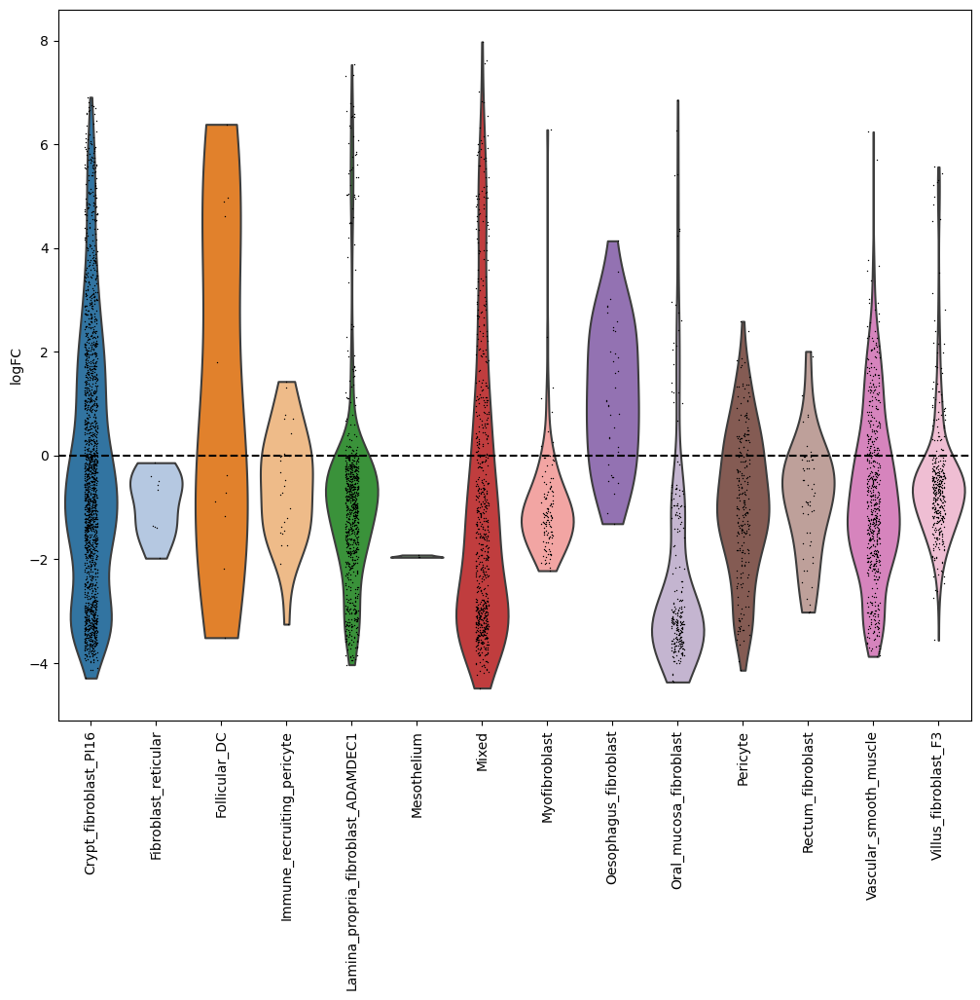

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


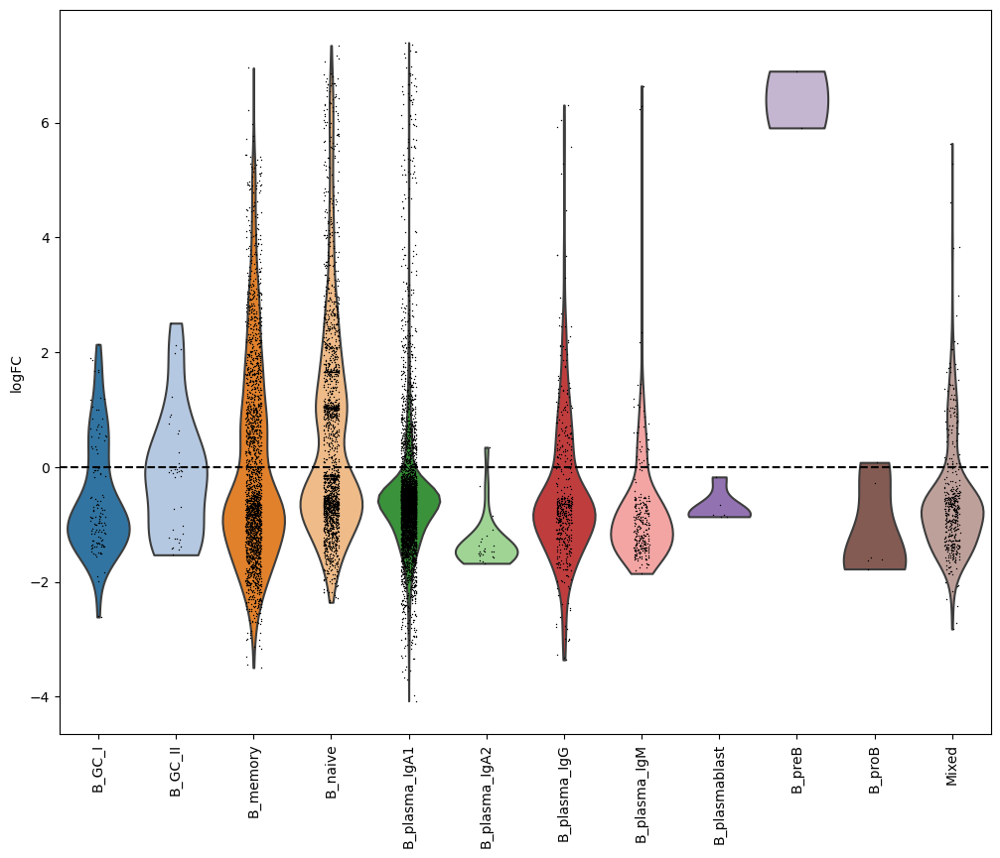

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


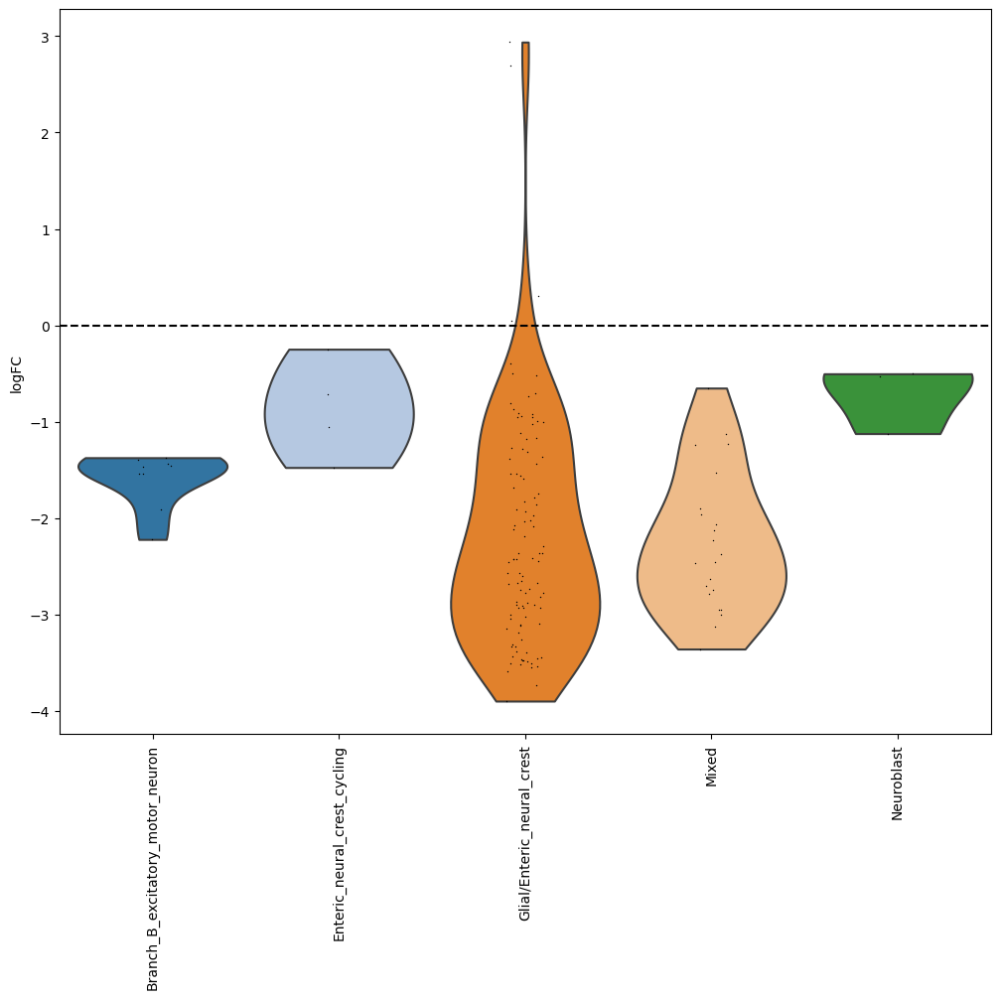

In [23]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [24]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_salivary'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Next! MLN!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


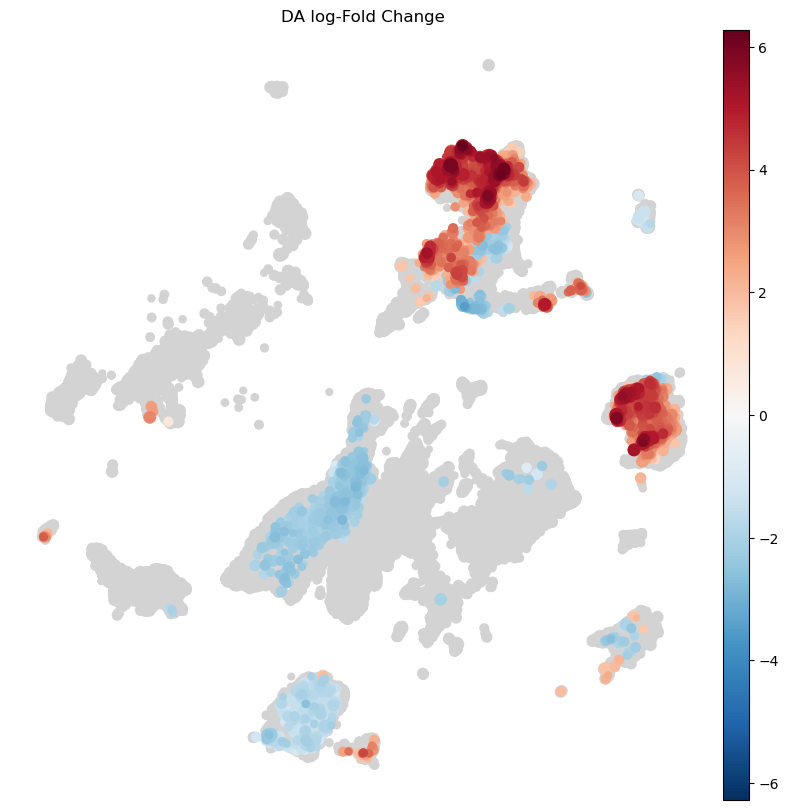

In [25]:
adata.obs['MLN_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   'Oral_mucosa':'rest',
 'Stomach':"rest",
 'Small_intestine':'rest',
 'Salivary_gland':'rest',
 'Large_intestine':'rest',
 #'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ MLN_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='MLN_vs_allMLN-MLN_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


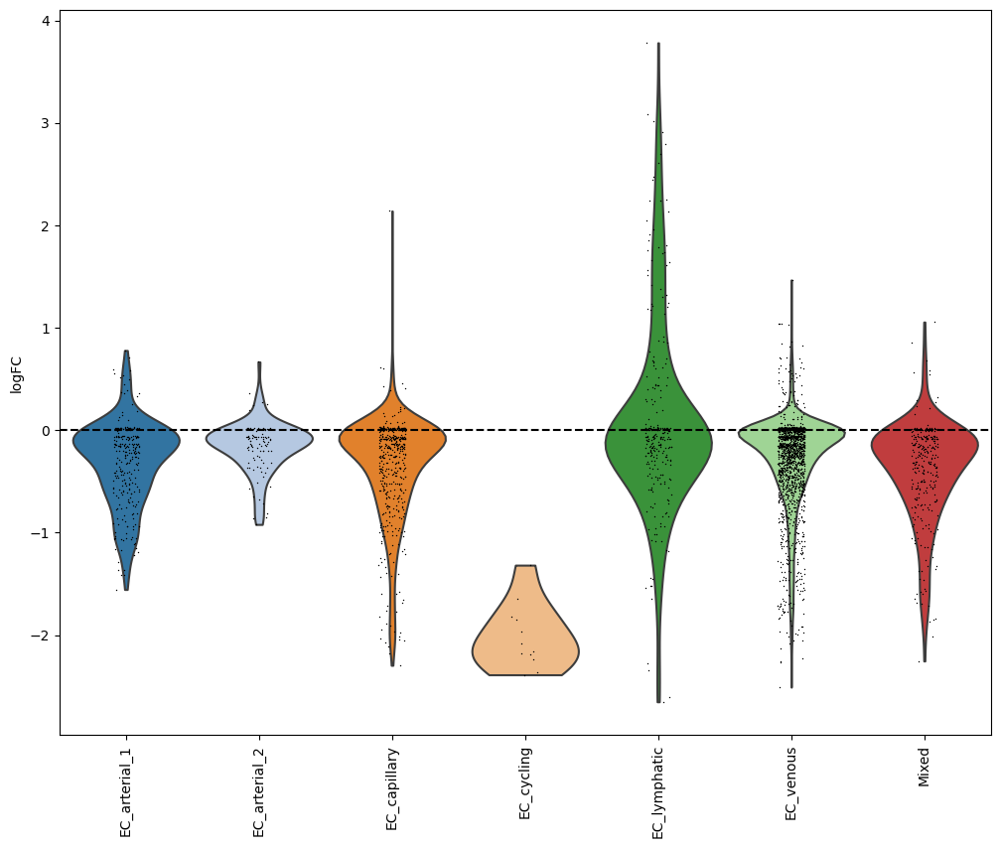

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


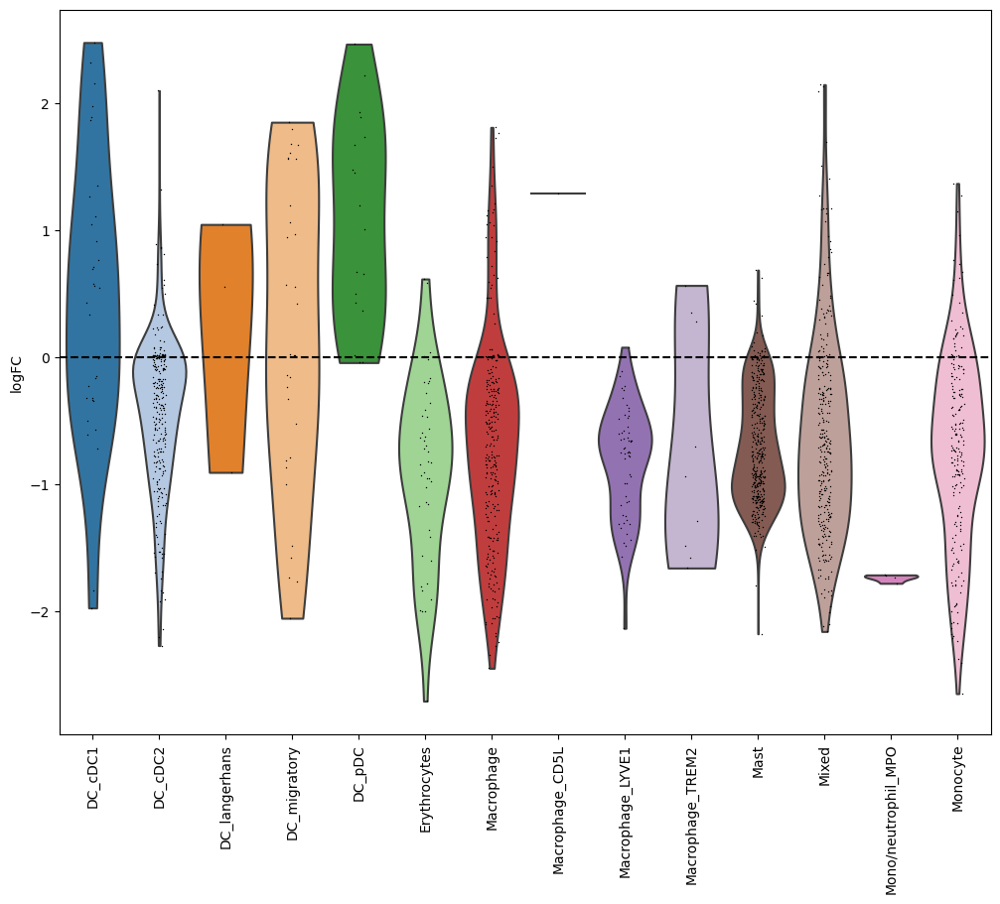

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


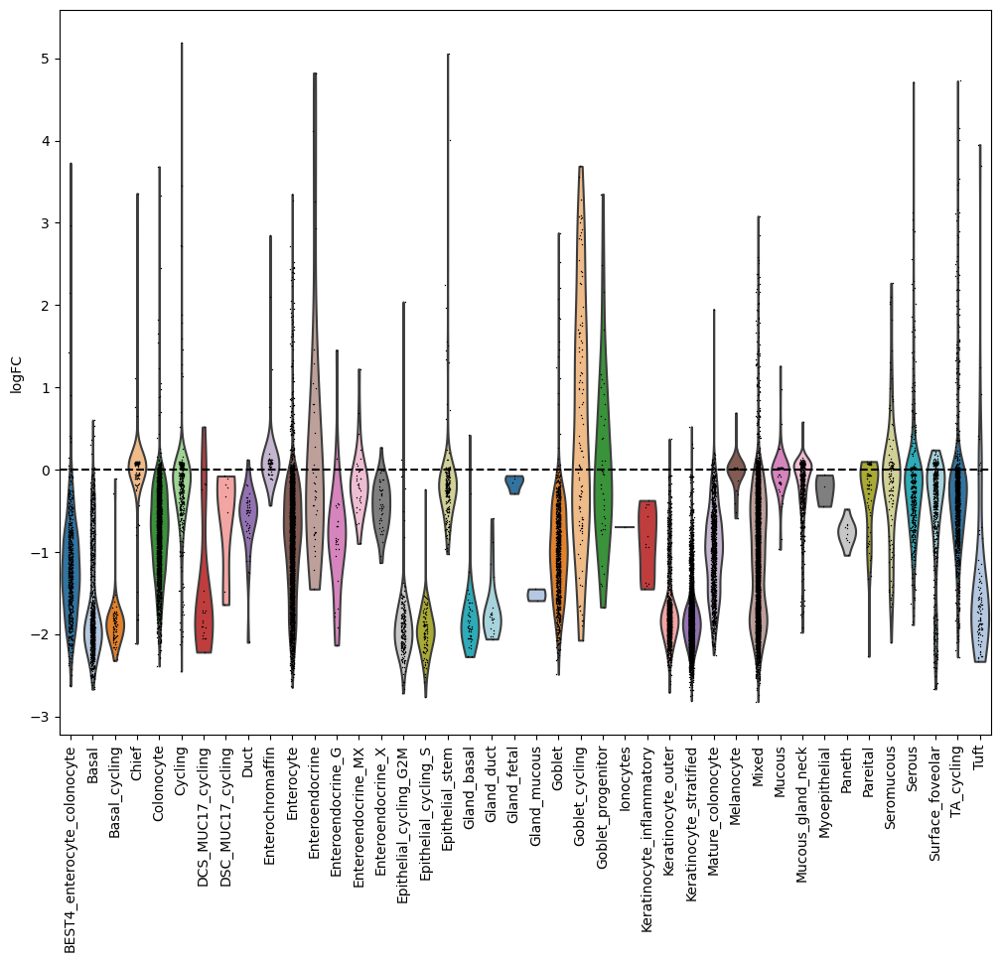

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


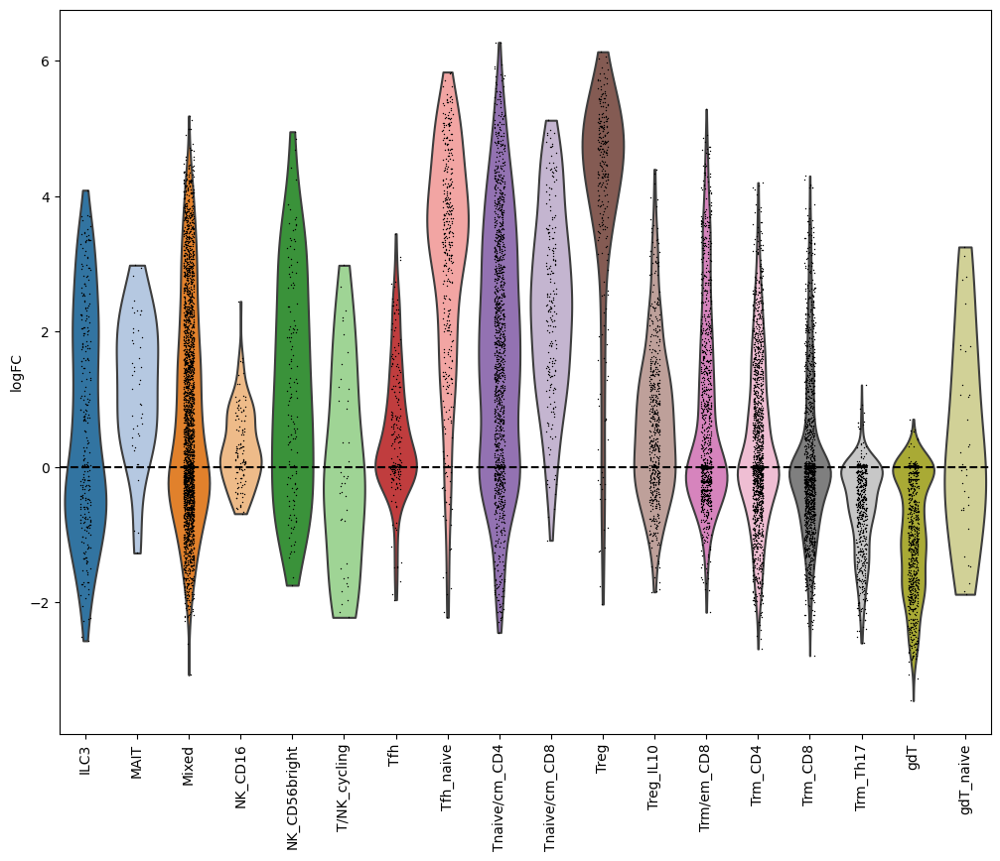

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


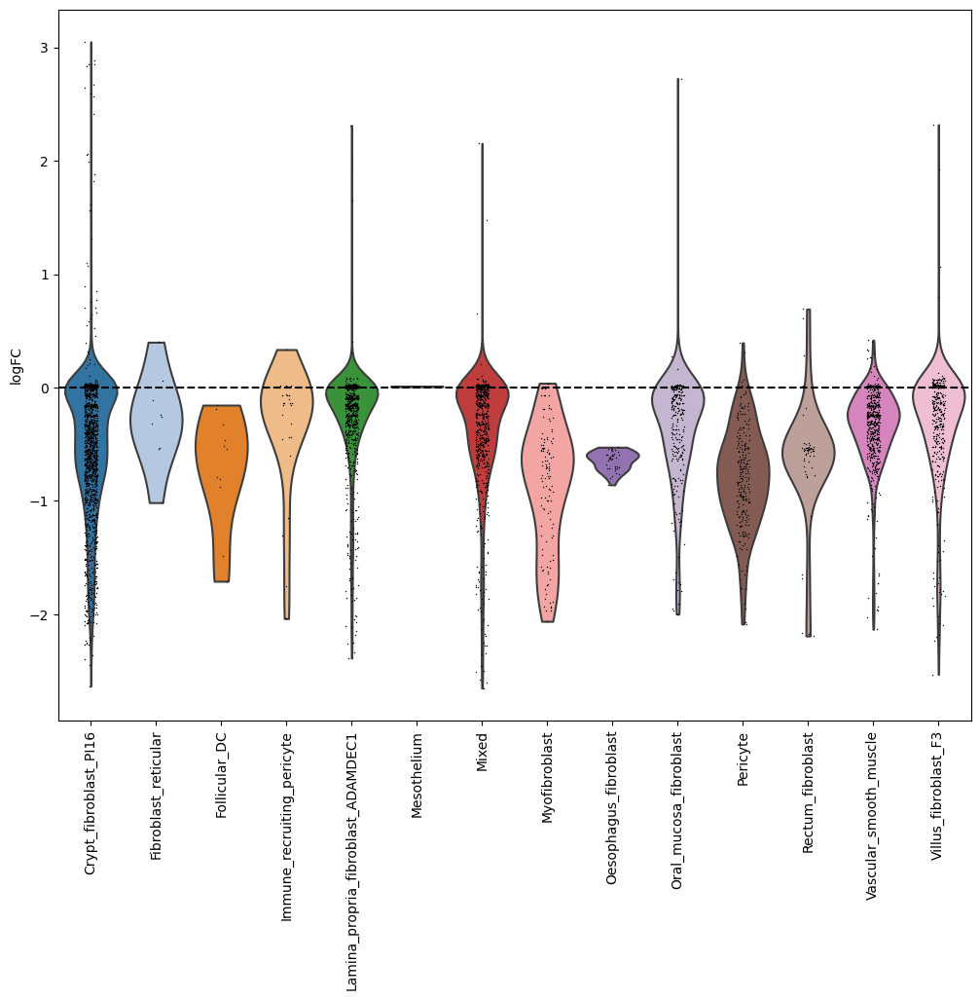

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


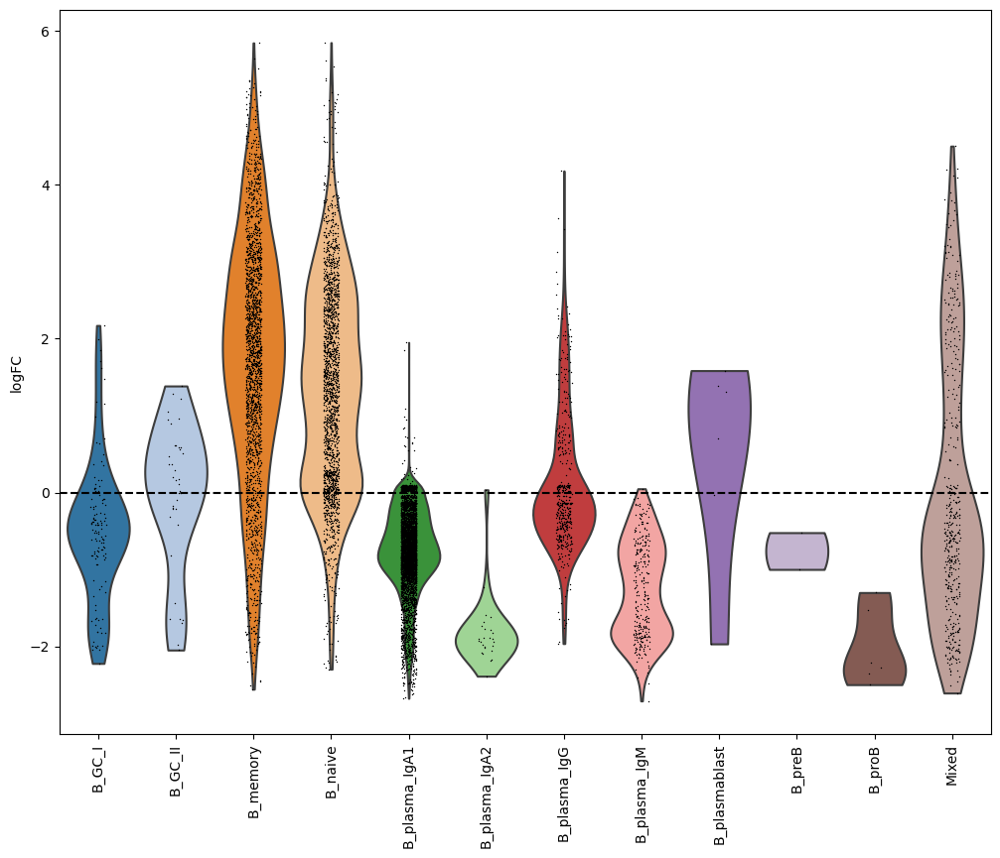

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


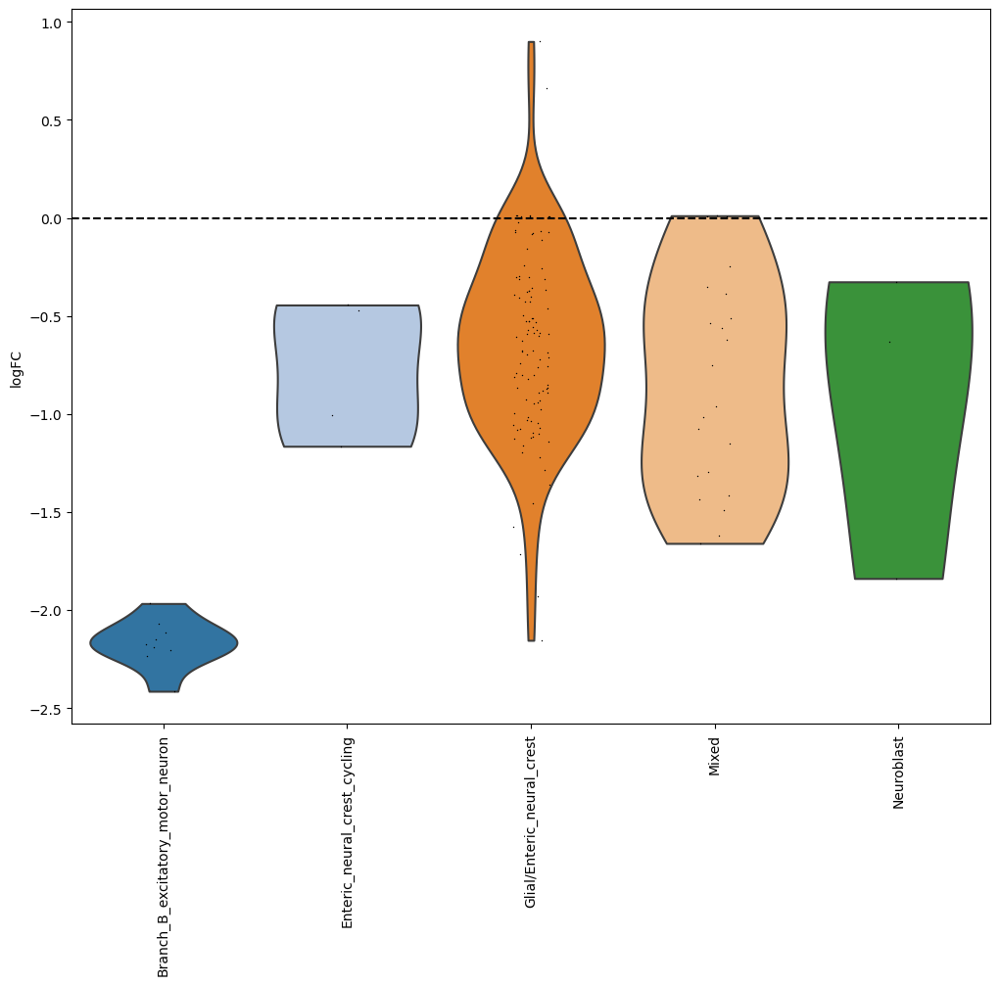

In [26]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [27]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_MLN'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Last one! Oral!

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/milopy/core.py:285: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  nhood_adata.obs = pd.concat([nhood_adata.obs, res], 1)


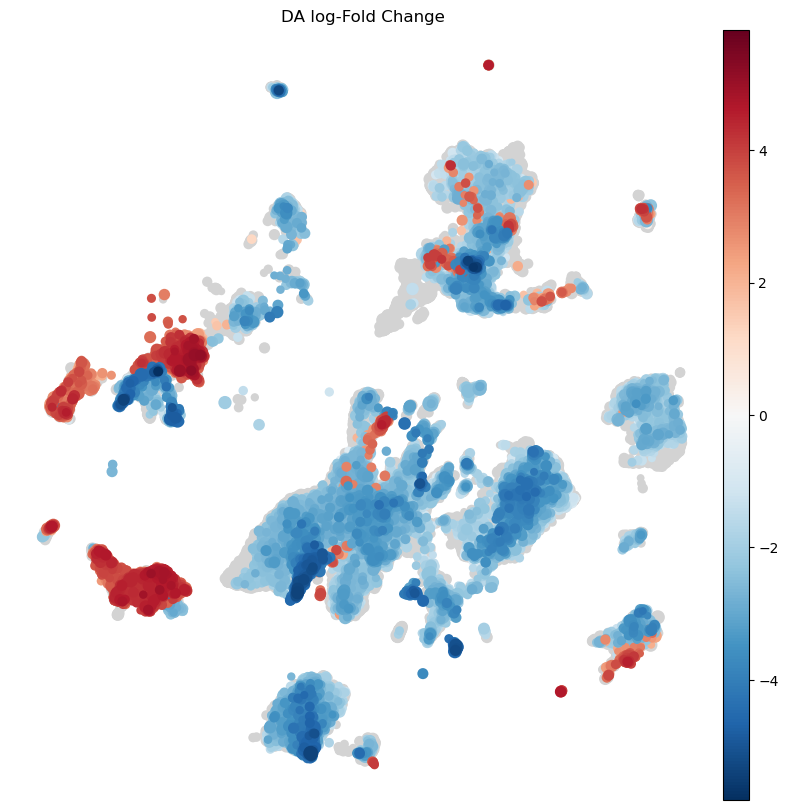

In [28]:
adata.obs['oral_vs_all'] = (
    adata.obs["organ_groups"]
    .map(lambda x: {
   #'Oral_mucosa':'rest',
 'Stomach':"rest",
 'Small_intestine':'rest',
 'Salivary_gland':'rest',
 'Large_intestine':'rest',
 'MLN':'rest',
 'Oesophagus':'rest'
                   }.get(x, x))
    .astype("category")
)

milo.count_nhoods(adata, sample_col="sampleID")
milo.DA_nhoods(adata, design="~ oral_vs_all+tissue_fraction+cell_fraction_unified", model_contrasts='oral_vs_allOral_mucosa-oral_vs_allrest')
milopy.utils.build_nhood_graph(adata)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       )

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


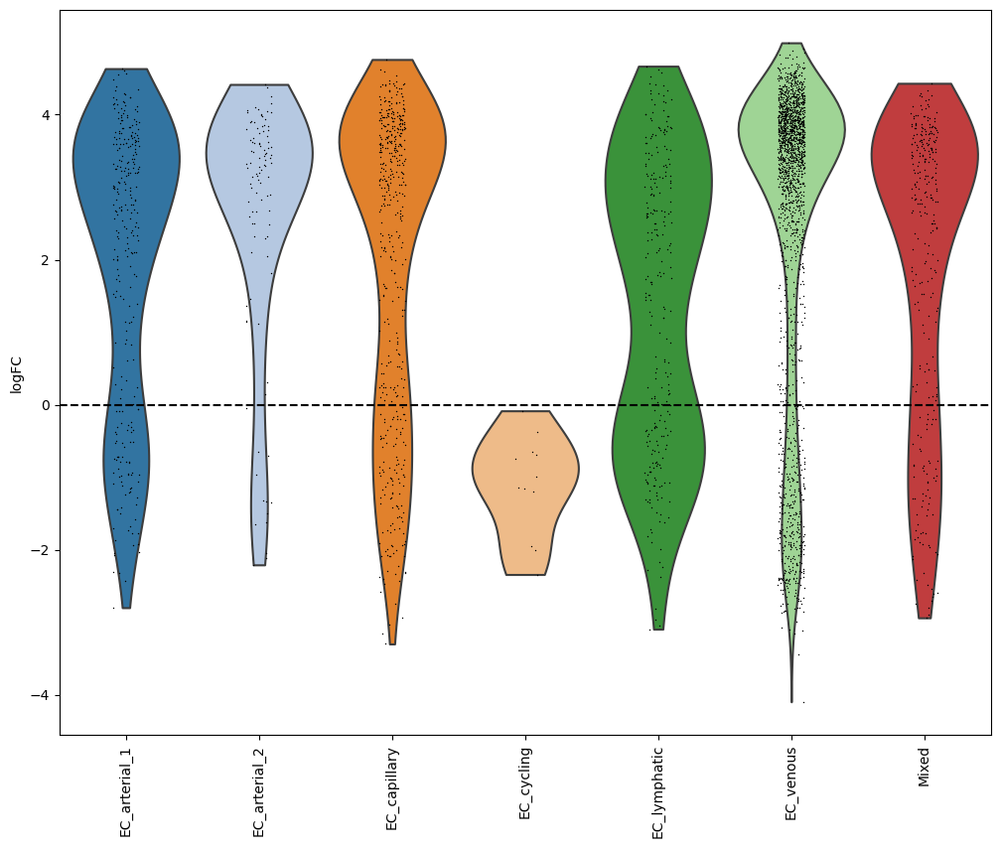

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


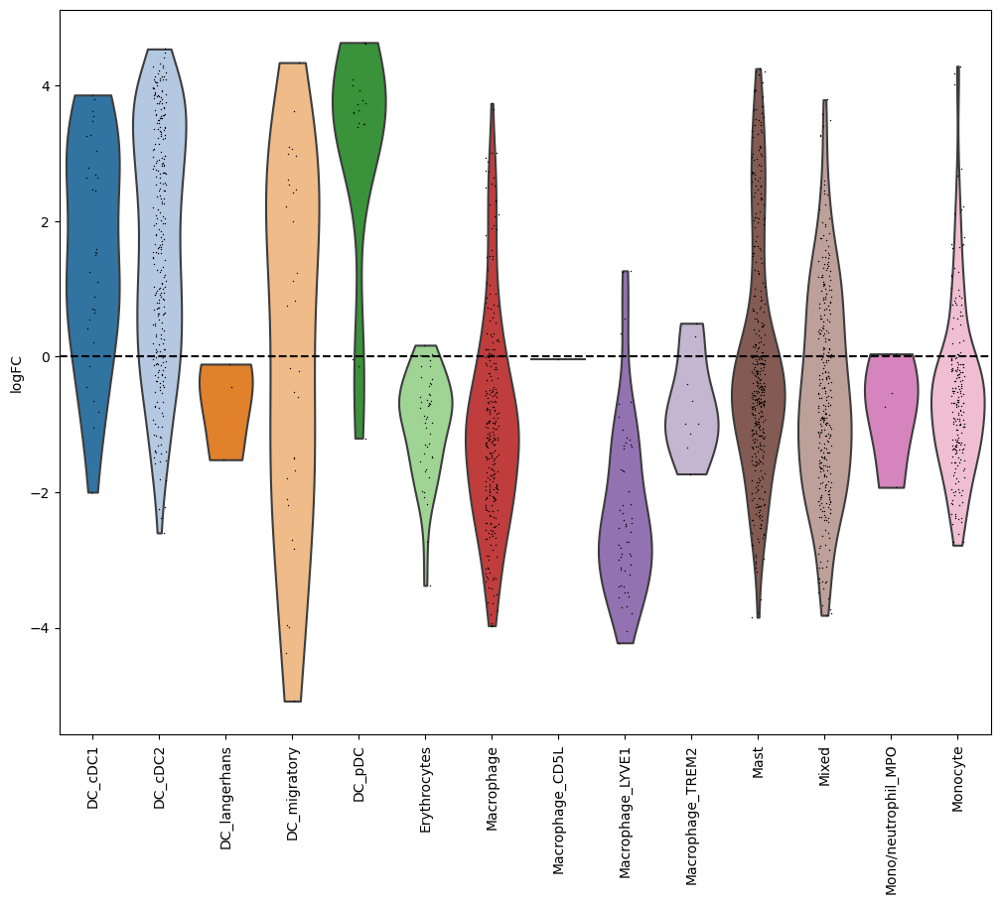

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


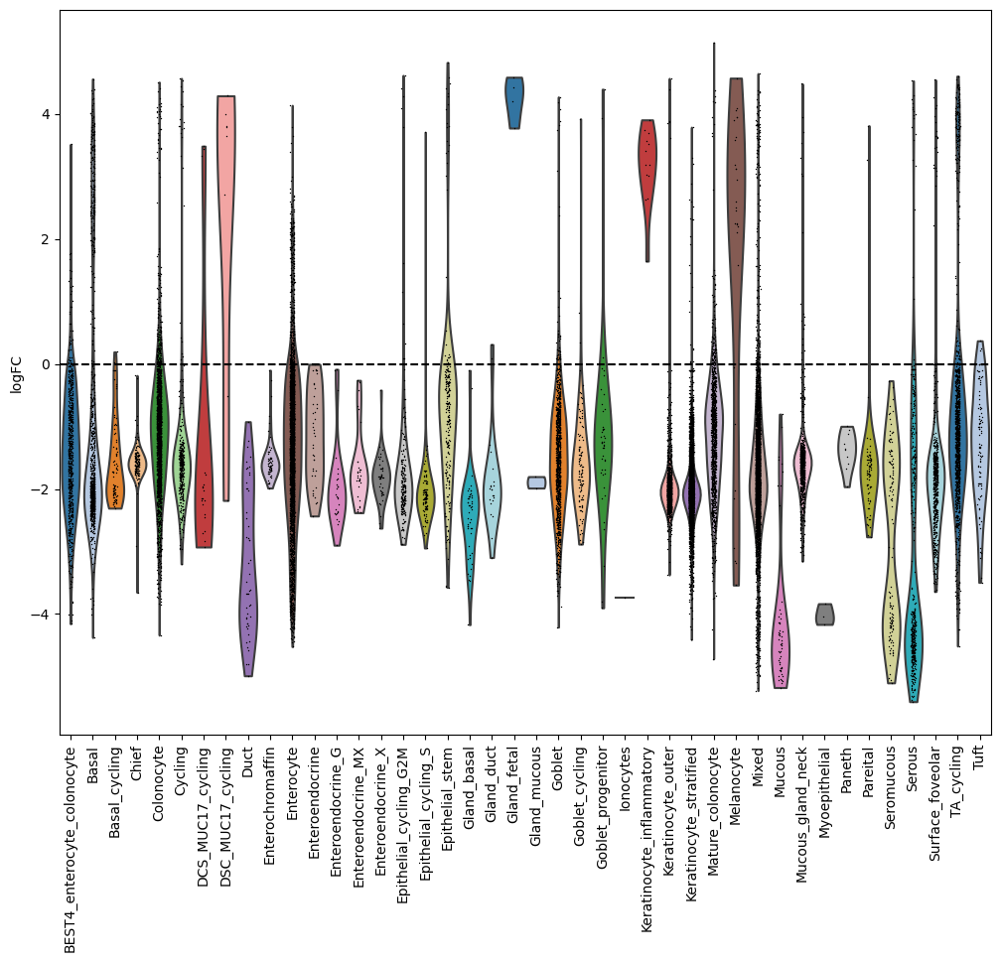

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


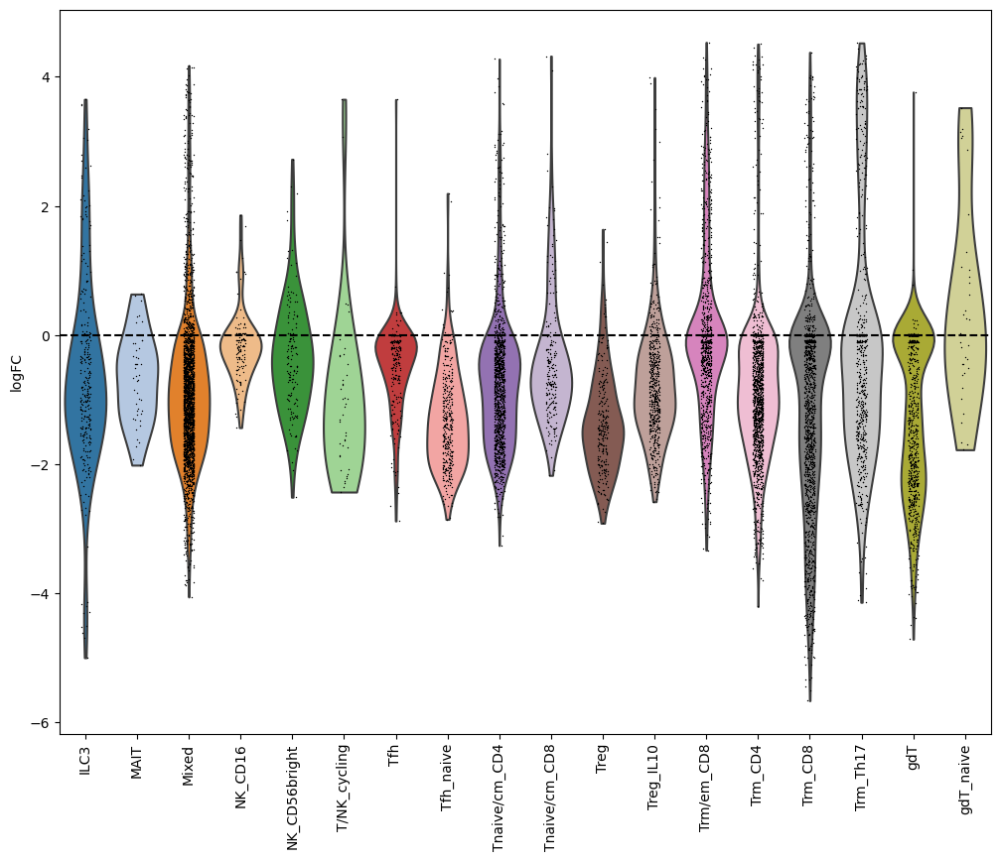

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


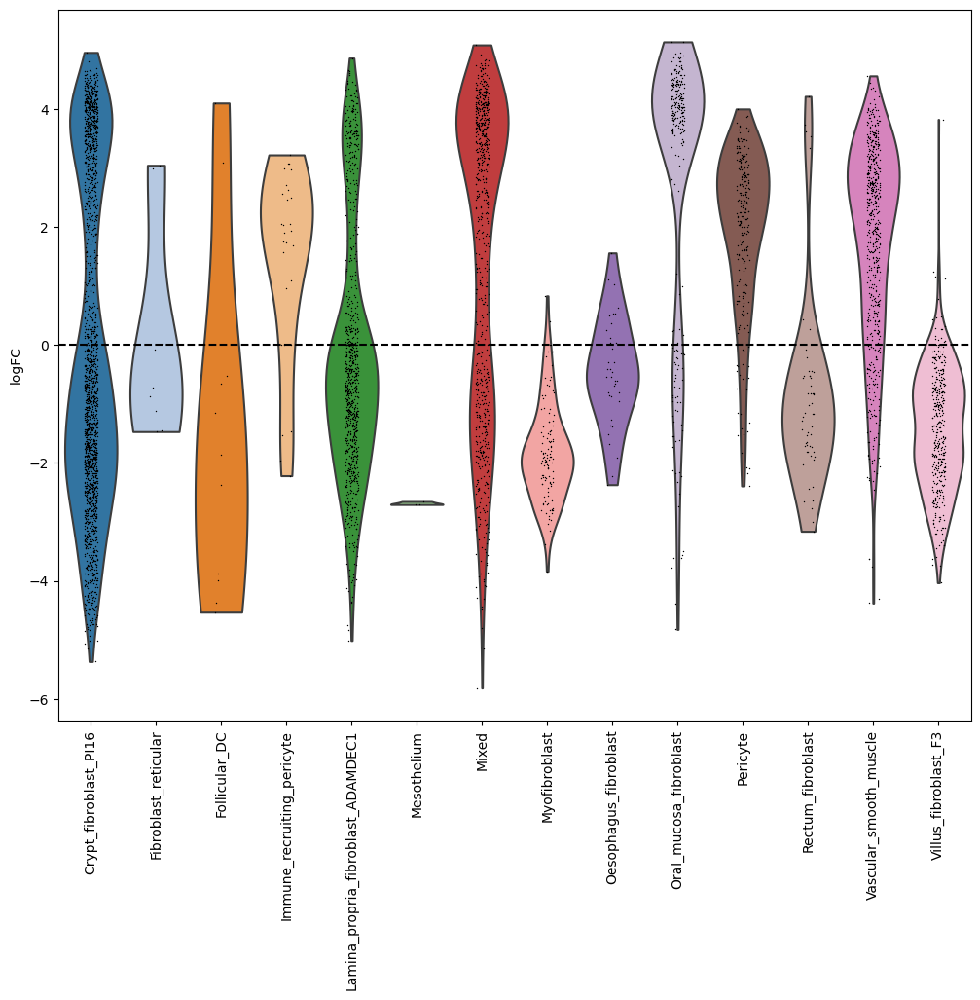

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


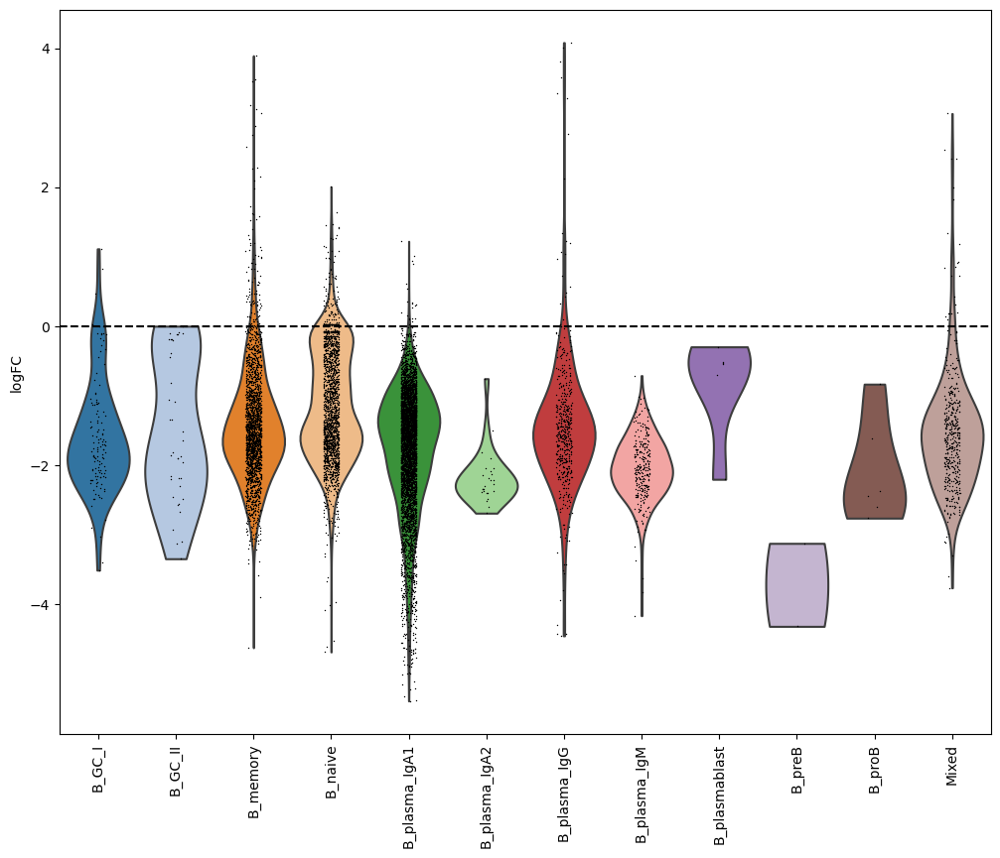

/home/jovyan/my-conda-envs/dandelion-tutorial/lib/python3.9/site-packages/scipy/sparse/_base.py:665: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


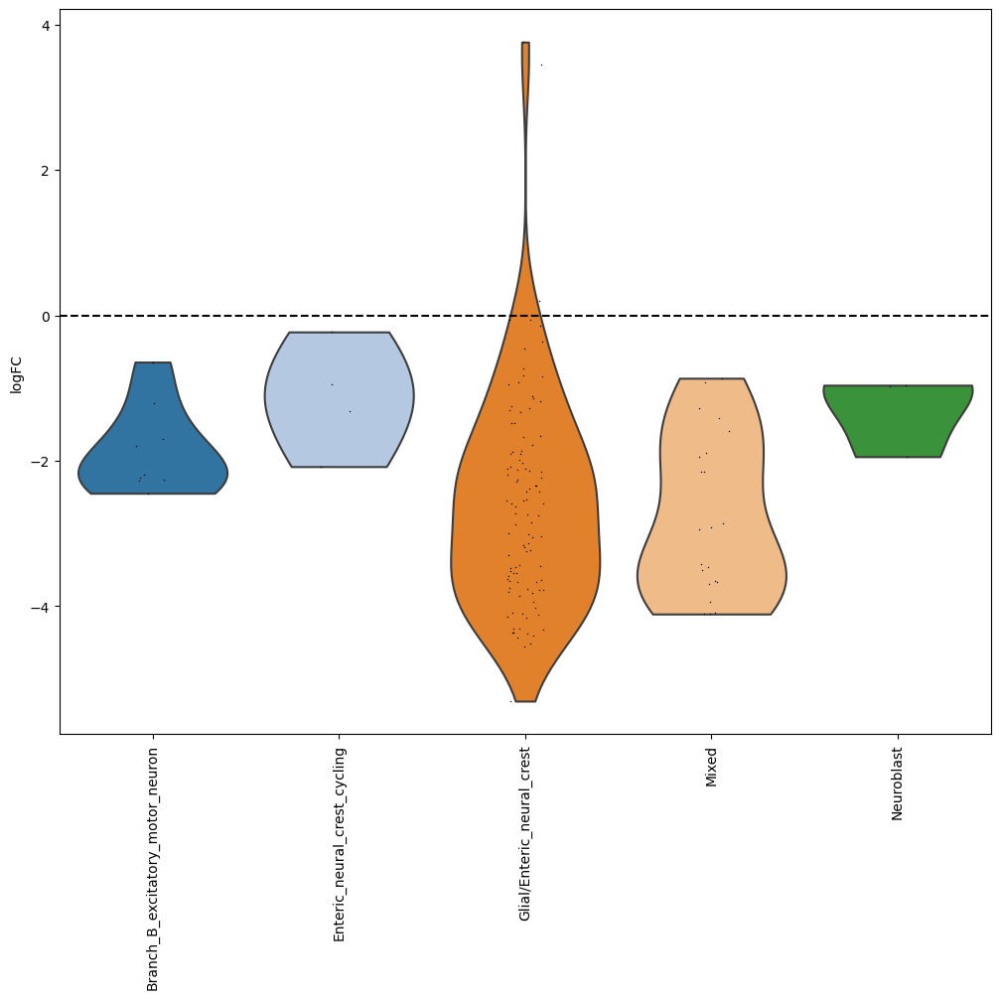

In [29]:
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [30]:
milopy.utils.annotate_nhoods(adata, anno_col='fine_annot')
adata.uns['nhood_adata'].obs.loc[adata.uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
adata.uns['nhood_adata'].uns['annotation_labels'] = adata.uns['nhood_adata'].uns['annotation_labels'].tolist()
adata.uns['nhood_adata_oral'] = adata.uns['nhood_adata'].copy()
del adata.uns['nhood_adata']

Save the object with all the stuff in there. To recap - there are six milo entries in `.uns`:
- `nhood_adata_SI`
- `nhood_adata_LI`
- `nhood_adata_stomach`
- `nhood_adata_oesophagus`
- `nhood_adata_salivary`
- `nhood_adata_MLN`
- `nhood_adata_oral`

If wishing to explore one of the entries, do `adata.uns['nhood_adata'] = adata.uns[select_your_milo].copy()` and the various milo functions should work.

Start naming objects after notebooks.

In [31]:
adata.write("/lustre/scratch126/cellgen/team205/kp9/jupyter/ao15/23-05-16-milopy/milopy_N3.h5ad")

# Plotting the milo outputs for figures
Extended data 3e-g
Amanda Oliver

In [1]:
import scanpy as sc
import numpy as np

import milopy
import milopy.core as milo

In [2]:
sc.logging.print_header()

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.8.1 pandas==1.4.3 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [3]:
adata = sc.read_h5ad("/lustre/scratch126/cellgen/team205/kp9/jupyter/ao15/23-05-16-milopy/milopy_N3.h5ad")

In [4]:
adata

AnnData object with n_obs × n_vars = 682040 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

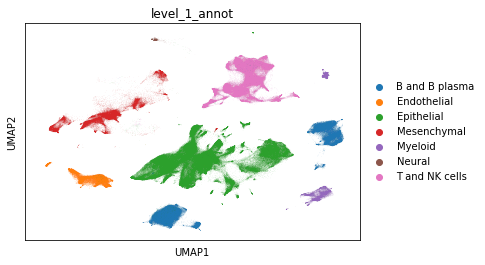

In [5]:
sc.pl.umap(adata,color='level_1_annot')

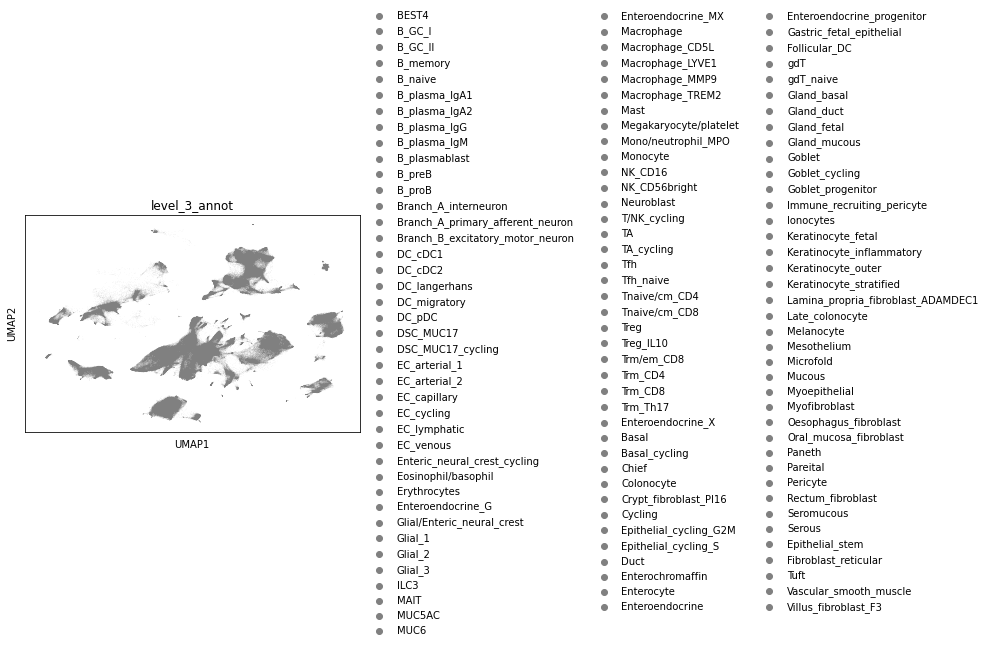

In [6]:
sc.pl.umap(adata,color='level_3_annot')

In [9]:
import matplotlib as plt
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(
    dpi=200,dpi_save=600,
    fontsize=12,
    transparent=True,
)

In [10]:
plt.rcParams["figure.figsize"] = [5, 5]

In [11]:
adata.obs.level_1_annot.value_counts()

Epithelial        296002
T and NK cells    144374
B and B plasma    123524
Mesenchymal        56118
Endothelial        40488
Myeloid            19911
Neural              1623
Name: level_1_annot, dtype: int64

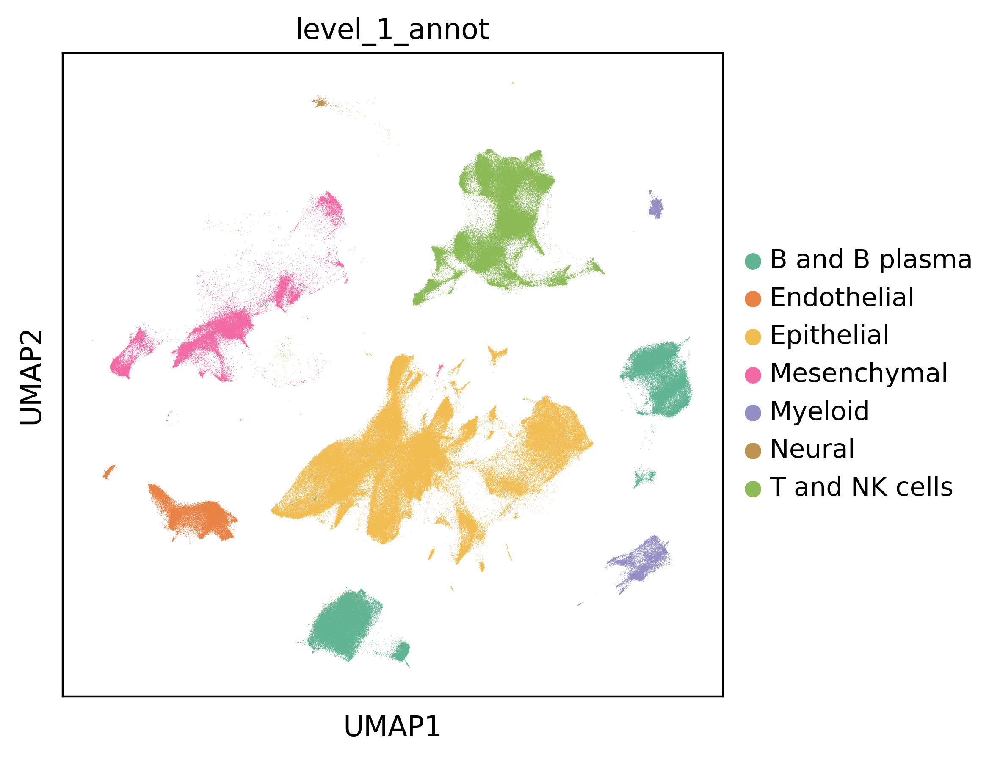

In [12]:
sc.pl.umap(adata,color='level_1_annot',palette={'Epithelial':'#f1bd51',
                                            'Mesenchymal':'#f269a4',
                                              'T and NK cells':'#8bba56',
                                              'B and B plasma':'#60b494',
                                              'Endothelial':'#e98345',
                                              'Myeloid':'#938ec4',
                                              'Neural':'#be9351'
},save='milo_level_1_annot_organ.pdf')

In [13]:
#update fine_annot
adata.obs['fine_annot'] = (adata.obs['fine_annot']
        .map(lambda x:{'TA':'TA_cycling',
                       'BEST4':'BEST4_enterocyte_colonocyte',
                      'DSC_MUC17':'DCS_MUC17',
                      'DSC_MUC17':'DCS_MUC17_cycling',
                      'MUC6':'Mucous_gland_neck',
                      'MUC5AC':'Surface_foveolar',
                      'Late_colonocyte':'Mature_colonocyte'}.get(x,x)).astype('category'))

In [14]:
list(adata.obs['fine_annot'].unique())

['EC_venous',
 'Mast',
 'EC_capillary',
 'DC_cDC1',
 'Monocyte',
 'DC_cDC2',
 'Basal',
 'Treg_IL10',
 'Crypt_fibroblast_PI16',
 'Macrophage',
 'Vascular_smooth_muscle',
 'Lamina_propria_fibroblast_ADAMDEC1',
 'Epithelial_cycling_G2M',
 'Keratinocyte_stratified',
 'Trm/em_CD8',
 'Pericyte',
 'Oral_mucosa_fibroblast',
 'Macrophage_MMP9',
 'EC_lymphatic',
 'Rectum_fibroblast',
 'Trm_Th17',
 'DC_migratory',
 'Epithelial_cycling_S',
 'Trm_CD4',
 'NK_CD16',
 'Macrophage_LYVE1',
 'Trm_CD8',
 'Macrophage_TREM2',
 'Keratinocyte_inflammatory',
 'Tnaive/cm_CD4',
 'DC_pDC',
 'Villus_fibroblast_F3',
 'EC_arterial_2',
 'EC_arterial_1',
 'gdT',
 'B_memory',
 'T/NK_cycling',
 'Immune_recruiting_pericyte',
 'MAIT',
 'ILC3',
 'Melanocyte',
 'Tfh_naive',
 'Keratinocyte_outer',
 'EC_cycling',
 'Tnaive/cm_CD8',
 'NK_CD56bright',
 'B_naive',
 'B_preB',
 'Treg',
 'B_proB',
 'B_plasmablast',
 'B_plasma_IgG',
 'Megakaryocyte/platelet',
 'TA_cycling',
 'Mono/neutrophil_MPO',
 'B_plasma_IgA1',
 'Macrophage_CD5L'

In [15]:
#update fine_annot
adata.obs['fine_annot'] = (adata.obs['fine_annot']
        .map(lambda x:{
                      'DCS_MUC17_cycling':'DCS_MUC17',
                      'DSC_MUC17_cycling':'DCS_MUC17_cycling',
                      }.get(x,x)).astype('category'))

In [16]:
#update fine_annot
adata.obs['fine_annot'] = (adata.obs['fine_annot']
        .map(lambda x:{
                      'TA_cycling':'TA'
                      }.get(x,x)).astype('category'))

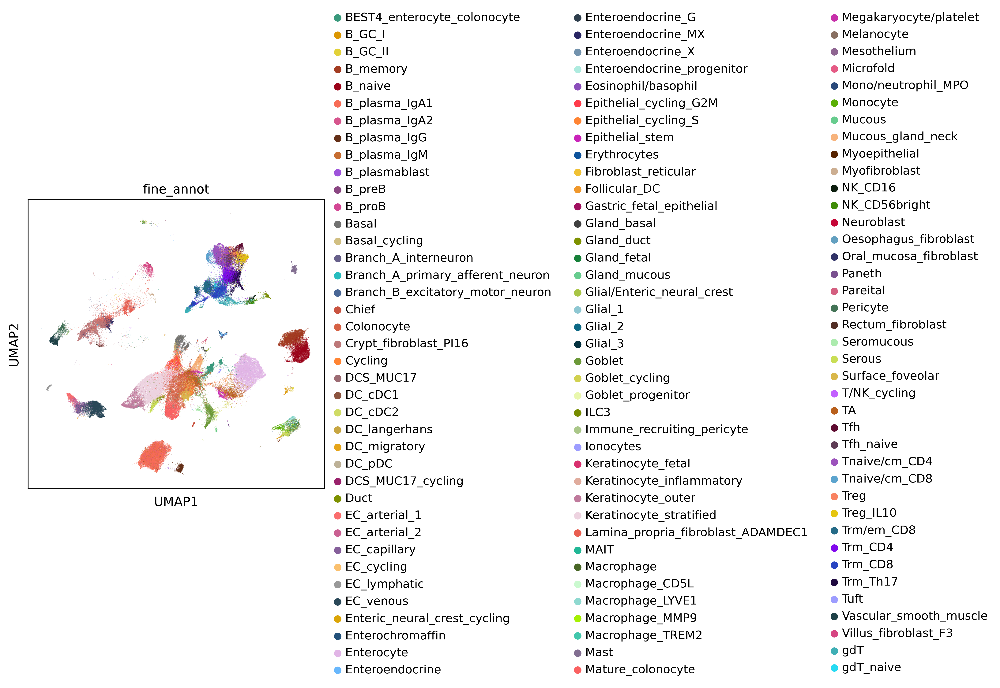

In [17]:
sc.pl.umap(adata,color='fine_annot',palette={'EC_venous': '#2a4858',
  'Mast': '#826e91',
  'EC_capillary': '#855f9a',
  'DC_cDC1': '#8c543f',
  'Monocyte': '#5baf07',
  'DC_cDC2': '#cfdb65',
  'Basal': '#727271',
  'Treg_IL10': '#e5c510',
  'Crypt_fibroblast_PI16': '#bd7879',
  'Macrophage': '#486626',
  'Vascular_smooth_muscle': '#1E4147',
  'Lamina_propria_fibroblast_ADAMDEC1': '#e95e50',
  'Epithelial_cycling_G2M': '#ff3c4b',
  'Keratinocyte_stratified': '#EDD3E0',
  'Trm/em_CD8': '#256b87',
  'Pericyte': '#437356',
  'Oral_mucosa_fibroblast': '#303267',
  'Macrophage_MMP9': '#a5f002',
  'EC_lymphatic': '#999999',
  'Rectum_fibroblast': '#522e25',
  'Trm_Th17': '#1e093f',
  'DC_migratory': '#e6a519',
  'Epithelial_cycling_S': '#ff8433',
  'Trm_CD4': '#8107ed',
  'NK_CD16': '#0c1e0e',
  'Macrophage_LYVE1': '#8fd9d0',
  'Trm_CD8': '#2844c1',
  'Macrophage_TREM2': '#42c7ac',
  'Keratinocyte_inflammatory': '#E0AC9D',
  'Tnaive/cm_CD4': '#9c53bc',
  'DC_pDC': '#bdb197',
  'Villus_fibroblast_F3': '#d64582',
  'EC_arterial_2': '#ca6092',
  'EC_arterial_1': '#fa6e6e',
  'gdT': '#3fafb5',
  'B_memory': '#a33c22',
  'T/NK_cycling': '#c260ff',
  'Immune_recruiting_pericyte': '#AAC789',
  'MAIT': '#21b796',
  'ILC3': '#778c00',
  'Melanocyte': '#886F61',
  'Tfh_naive': '#5e3c55',
  'Keratinocyte_outer': '#BF7A9C',
  'EC_cycling': '#fac06e',
  'Tnaive/cm_CD8': '#5ca4ce',
  'NK_CD56bright': '#3f8c08',
  'B_naive': '#9b0319',
  'B_preB': '#8a4682',
  'Treg': '#f98261',
  'B_proB': '#d34794',
  'B_plasmablast': '#9e53db',
  'B_plasma_IgG': '#632f17',
  'Megakaryocyte/platelet': '#c730aa',
  'TA': '#b85f1c',
  'Mono/neutrophil_MPO': '#2a497a',
  'B_plasma_IgA1': '#f76c56',
  'Macrophage_CD5L': '#caf9cf',
  'Tfh': '#5e0b30',
  'Oesophagus_fibroblast': '#63A0C0',
  'B_plasma_IgA2': '#d6558d',
  'gdT_naive': '#26daf2',
  'B_GC_I': '#db9602',
  'B_plasma_IgM': '#c66d31',
  'DC_langerhans': '#c7a642',
  'Fibroblast_reticular': '#f0c134',
  'B_GC_II': '#e2d138',
  'Follicular_DC': '#f0982c',
  'Microfold': '#e55b85',
  'Enterocyte': '#e1b5e6',
  'Epithelial_stem': '#c924b9',
  'Surface_foveolar': '#d9b74a',
  'Mucous_gland_neck': '#f7b37c',
  'Cycling': '#ff8433',
  'Pareital': '#d45f80',
  'Enteroendocrine_MX': '#292663',
  'Myofibroblast': '#CCAE91',
  'Glial_2': '#0D6986',
  'Enteric_neural_crest_cycling': '#DBA507',
  'Enterochromaffin': '#22517a',
  'Chief': '#c95340',
  'Glial/Enteric_neural_crest': '#a8c545',
  'Enteroendocrine_G': '#2f3f4d',
  'Neuroblast': '#c50637',
  'Goblet_progenitor': '#e9f7ad',
  'Goblet': '#6c9939',
  'Enteroendocrine': '#68b7fc',
  'Erythrocytes': '#0e539c',
  'Enteroendocrine_X': '#7292ad',
  'Glial_3': '#053240',
  'Goblet_cycling': '#d1d14f',
  'BEST4_enterocyte_colonocyte': '#39997c',
  'Tuft': '#9d9dff',
  'Paneth': '#79508f',
  'Serous': '#C9DE55',
  'Mucous': '#67cc8e',
  'Duct': '#7D9100',
  'Seromucous': '#ACEBAE',
  'Myoepithelial': '#572300',
  'Ionocytes': '#9d9dff',
  'Colonocyte': '#d66245',
  'Mature_colonocyte': '#fa6161',
  'Mesoderm_2': '#b4793b',
  'Branch_A_inhibtory_motor_neuron': '#a39bcb',
  'SMC_PPLP2': '#d4d4e8',
  'Cycling_fibroblast': '#d65151',
  'ICC': '#69479b',
  'Branch_B_excitatory_motor_neuron': '#496695',
  'SMC_CAPN3': '#968dc6',
  'Mesoderm_1': '#663818',
  'Branch_B_primary_afferent_neuron': '#909134',
  'Proximal_progenitor_DUO/JEJ': '#fac219',
  'SMC_CAPN3_cycling': '#76738e',
  'Glial_1': '#8EC7D2',
  'Branch_A_primary_afferent_neuron': '#27bdbf',
  'Branch_A_interneuron': '#67608a',
  'NTS': '#baada4',
  'Proximal_progenitor_ILE': '#8f6e0d',
  'Enteroendocrine_progenitor': '#aeebdf',
  'Mesothelium': '#8F6592',
  'Distal_progenitor': '#dbc697',
  'Angiogenic_pericyte': '#308587',
  'Eosinophil/basophil': '#8b4eba',
  'CLDN10': '#706d65',
  'Distal_progenitor_PRAC1': '#8f8161',
  'Immature_pericyte': '#90c496',
  'Mesenchymal_LTO': '#f7eb59',
  'Gastric_fetal_epithelial': '#a01160',
  'DCS_MUC17_cycling': '#99216b',
  'DCS_MUC17': '#9c6b73',
  'Gland_basal': '#404040',
  'Gland_fetal': '#168039',
  'Basal_cycling': '#d1bf82',
  'Keratinocyte_fetal': '#d8306e',
  'Gland_duct': '#7D9100',
  'Gland_mucous': '#67cc8e',
  'Myoblast/myocyte': '#e2798d',
  'Unknown': '#000000'}, save='milo_level_3_annot_organ.pdf')

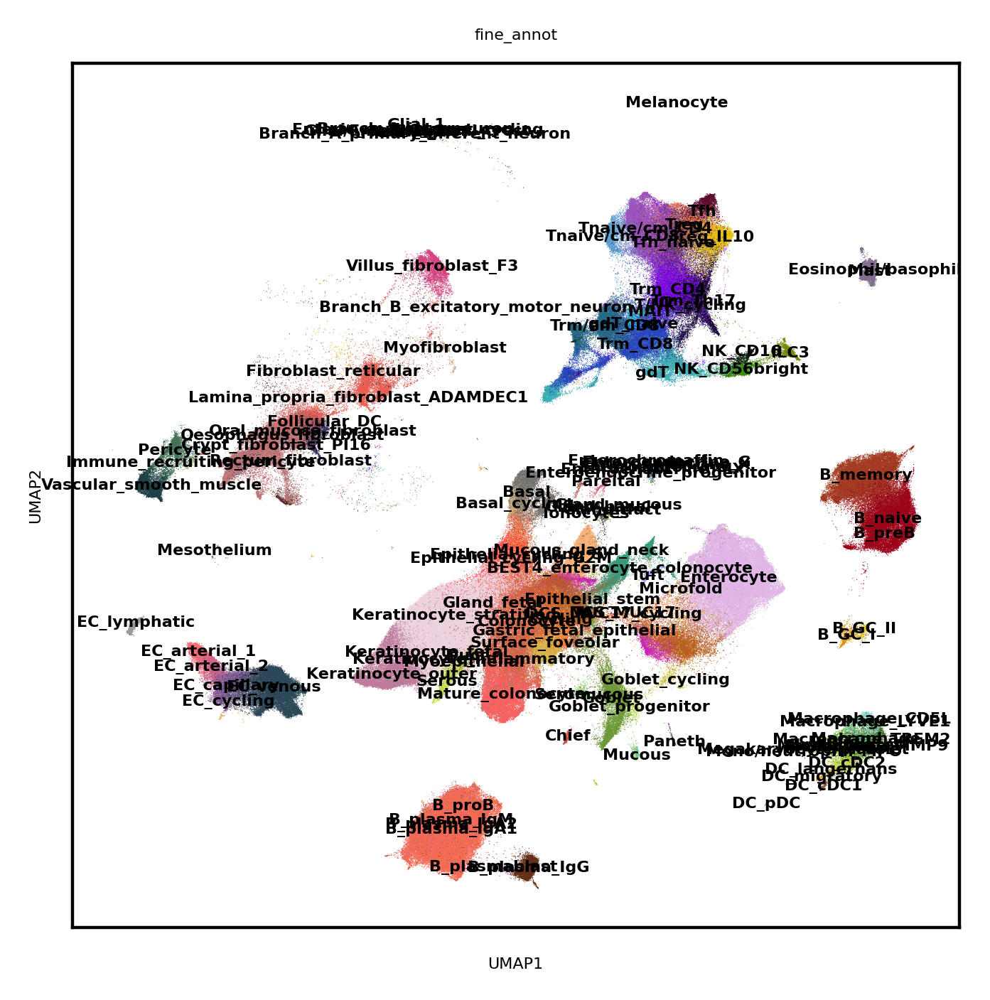

In [18]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=4,
    transparent=True,
)
sc.pl.umap(adata,color='fine_annot',palette={'EC_venous': '#2a4858',
  'Mast': '#826e91',
  'EC_capillary': '#855f9a',
  'DC_cDC1': '#8c543f',
  'Monocyte': '#5baf07',
  'DC_cDC2': '#cfdb65',
  'Basal': '#727271',
  'Treg_IL10': '#e5c510',
  'Crypt_fibroblast_PI16': '#bd7879',
  'Macrophage': '#486626',
  'Vascular_smooth_muscle': '#1E4147',
  'Lamina_propria_fibroblast_ADAMDEC1': '#e95e50',
  'Epithelial_cycling_G2M': '#ff3c4b',
  'Keratinocyte_stratified': '#EDD3E0',
  'Trm/em_CD8': '#256b87',
  'Pericyte': '#437356',
  'Oral_mucosa_fibroblast': '#303267',
  'Macrophage_MMP9': '#a5f002',
  'EC_lymphatic': '#999999',
  'Rectum_fibroblast': '#522e25',
  'Trm_Th17': '#1e093f',
  'DC_migratory': '#e6a519',
  'Epithelial_cycling_S': '#ff8433',
  'Trm_CD4': '#8107ed',
  'NK_CD16': '#0c1e0e',
  'Macrophage_LYVE1': '#8fd9d0',
  'Trm_CD8': '#2844c1',
  'Macrophage_TREM2': '#42c7ac',
  'Keratinocyte_inflammatory': '#E0AC9D',
  'Tnaive/cm_CD4': '#9c53bc',
  'DC_pDC': '#bdb197',
  'Villus_fibroblast_F3': '#d64582',
  'EC_arterial_2': '#ca6092',
  'EC_arterial_1': '#fa6e6e',
  'gdT': '#3fafb5',
  'B_memory': '#a33c22',
  'T/NK_cycling': '#c260ff',
  'Immune_recruiting_pericyte': '#AAC789',
  'MAIT': '#21b796',
  'ILC3': '#778c00',
  'Melanocyte': '#886F61',
  'Tfh_naive': '#5e3c55',
  'Keratinocyte_outer': '#BF7A9C',
  'EC_cycling': '#fac06e',
  'Tnaive/cm_CD8': '#5ca4ce',
  'NK_CD56bright': '#3f8c08',
  'B_naive': '#9b0319',
  'B_preB': '#8a4682',
  'Treg': '#f98261',
  'B_proB': '#d34794',
  'B_plasmablast': '#9e53db',
  'B_plasma_IgG': '#632f17',
  'Megakaryocyte/platelet': '#c730aa',
  'TA': '#b85f1c',
  'Mono/neutrophil_MPO': '#2a497a',
  'B_plasma_IgA1': '#f76c56',
  'Macrophage_CD5L': '#caf9cf',
  'Tfh': '#5e0b30',
  'Oesophagus_fibroblast': '#63A0C0',
  'B_plasma_IgA2': '#d6558d',
  'gdT_naive': '#26daf2',
  'B_GC_I': '#db9602',
  'B_plasma_IgM': '#c66d31',
  'DC_langerhans': '#c7a642',
  'Fibroblast_reticular': '#f0c134',
  'B_GC_II': '#e2d138',
  'Follicular_DC': '#f0982c',
  'Microfold': '#e55b85',
  'Enterocyte': '#e1b5e6',
  'Epithelial_stem': '#c924b9',
  'Surface_foveolar': '#d9b74a',
  'Mucous_gland_neck': '#f7b37c',
  'Cycling': '#ff8433',
  'Pareital': '#d45f80',
  'Enteroendocrine_MX': '#292663',
  'Myofibroblast': '#CCAE91',
  'Glial_2': '#0D6986',
  'Enteric_neural_crest_cycling': '#DBA507',
  'Enterochromaffin': '#22517a',
  'Chief': '#c95340',
  'Glial/Enteric_neural_crest': '#a8c545',
  'Enteroendocrine_G': '#2f3f4d',
  'Neuroblast': '#c50637',
  'Goblet_progenitor': '#e9f7ad',
  'Goblet': '#6c9939',
  'Enteroendocrine': '#68b7fc',
  'Erythrocytes': '#0e539c',
  'Enteroendocrine_X': '#7292ad',
  'Glial_3': '#053240',
  'Goblet_cycling': '#d1d14f',
  'BEST4_enterocyte_colonocyte': '#39997c',
  'Tuft': '#9d9dff',
  'Paneth': '#79508f',
  'Serous': '#C9DE55',
  'Mucous': '#67cc8e',
  'Duct': '#7D9100',
  'Seromucous': '#ACEBAE',
  'Myoepithelial': '#572300',
  'Ionocytes': '#9d9dff',
  'Colonocyte': '#d66245',
  'Mature_colonocyte': '#fa6161',
  'Mesoderm_2': '#b4793b',
  'Branch_A_inhibtory_motor_neuron': '#a39bcb',
  'SMC_PPLP2': '#d4d4e8',
  'Cycling_fibroblast': '#d65151',
  'ICC': '#69479b',
  'Branch_B_excitatory_motor_neuron': '#496695',
  'SMC_CAPN3': '#968dc6',
  'Mesoderm_1': '#663818',
  'Branch_B_primary_afferent_neuron': '#909134',
  'Proximal_progenitor_DUO/JEJ': '#fac219',
  'SMC_CAPN3_cycling': '#76738e',
  'Glial_1': '#8EC7D2',
  'Branch_A_primary_afferent_neuron': '#27bdbf',
  'Branch_A_interneuron': '#67608a',
  'NTS': '#baada4',
  'Proximal_progenitor_ILE': '#8f6e0d',
  'Enteroendocrine_progenitor': '#aeebdf',
  'Mesothelium': '#8F6592',
  'Distal_progenitor': '#dbc697',
  'Angiogenic_pericyte': '#308587',
  'Eosinophil/basophil': '#8b4eba',
  'CLDN10': '#706d65',
  'Distal_progenitor_PRAC1': '#8f8161',
  'Immature_pericyte': '#90c496',
  'Mesenchymal_LTO': '#f7eb59',
  'Gastric_fetal_epithelial': '#a01160',
  'DCS_MUC17_cycling': '#99216b',
  'DCS_MUC17': '#9c6b73',
  'Gland_basal': '#404040',
  'Gland_fetal': '#168039',
  'Basal_cycling': '#d1bf82',
  'Keratinocyte_fetal': '#d8306e',
  'Gland_duct': '#7D9100',
  'Gland_mucous': '#67cc8e',
  'Myoblast/myocyte': '#e2798d',
  'Unknown': '#000000'}, legend_loc='on data',save='milo_level_3_annot_organ_legendon.pdf')

### plot oesophagus B cells

In [76]:
adata.uns['nhood_adata'] = adata.uns['nhood_adata_oesophagus'].copy()

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


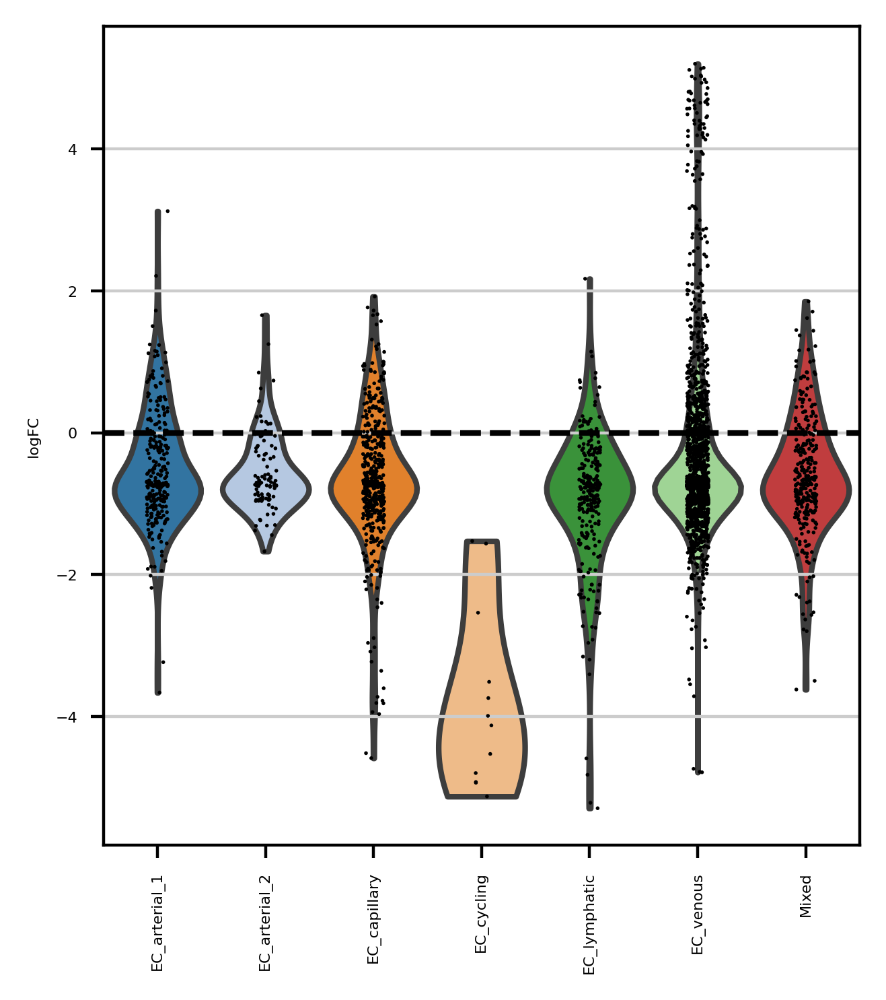

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


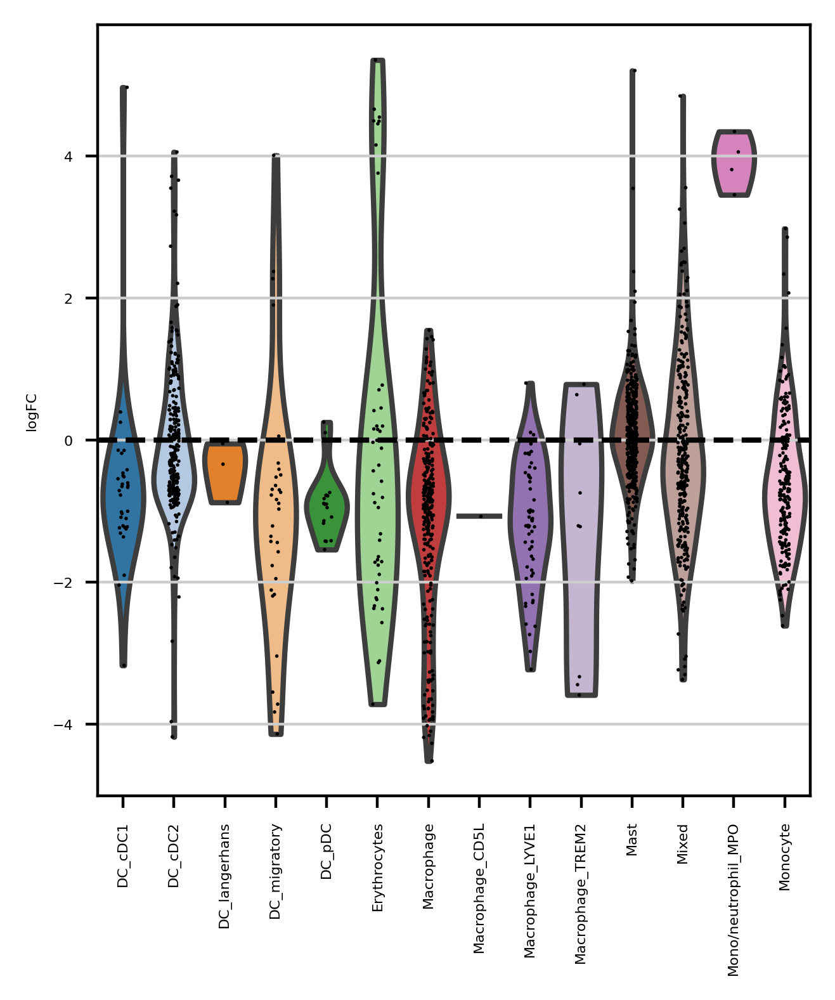

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


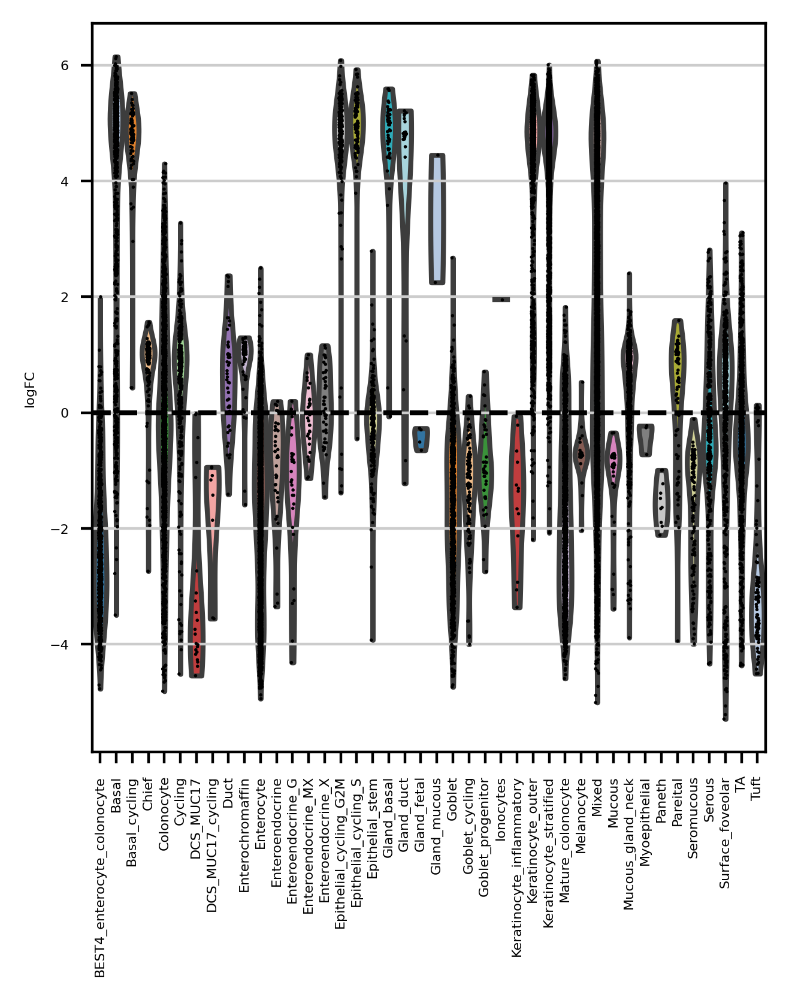

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


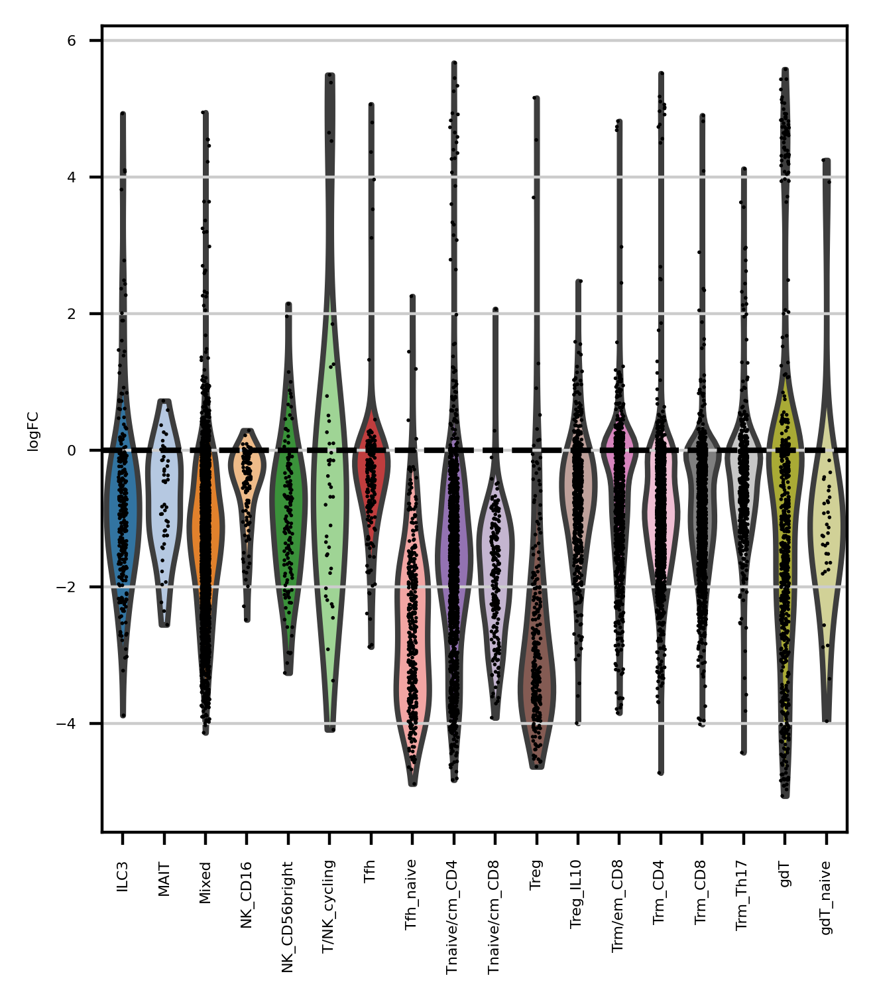

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


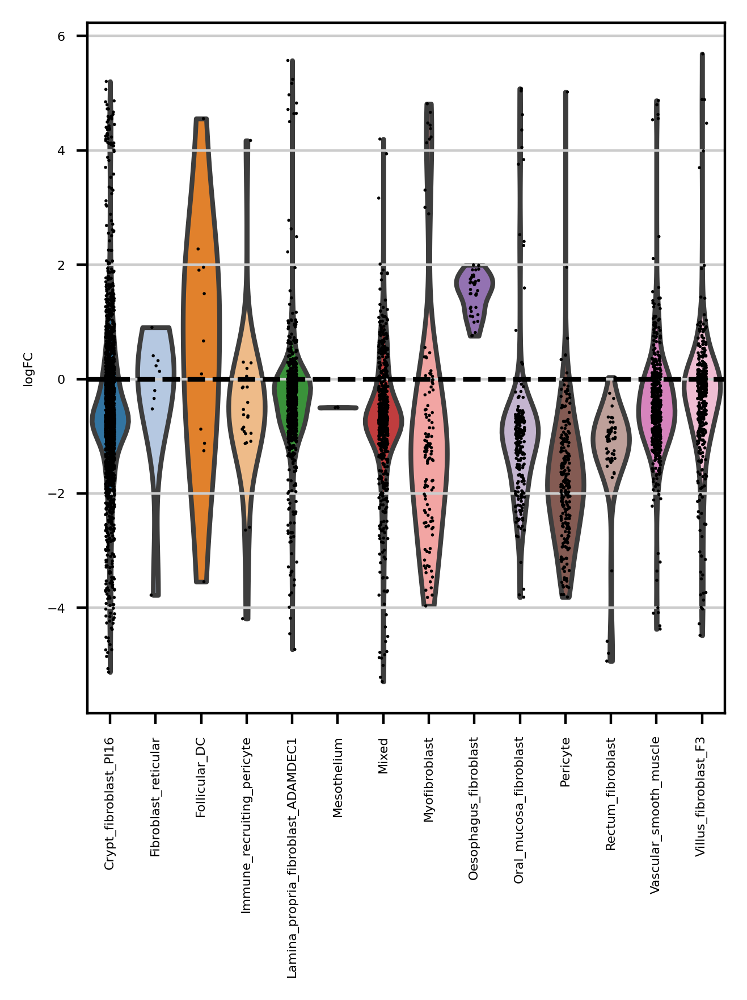

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


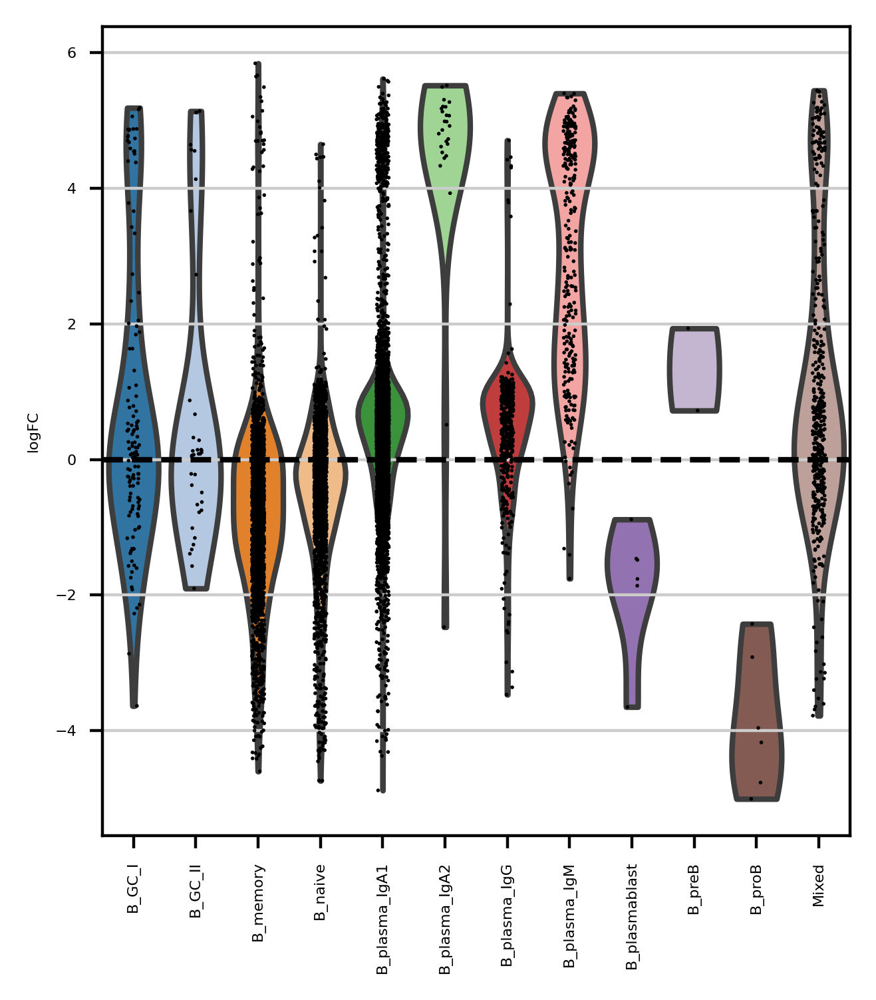

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


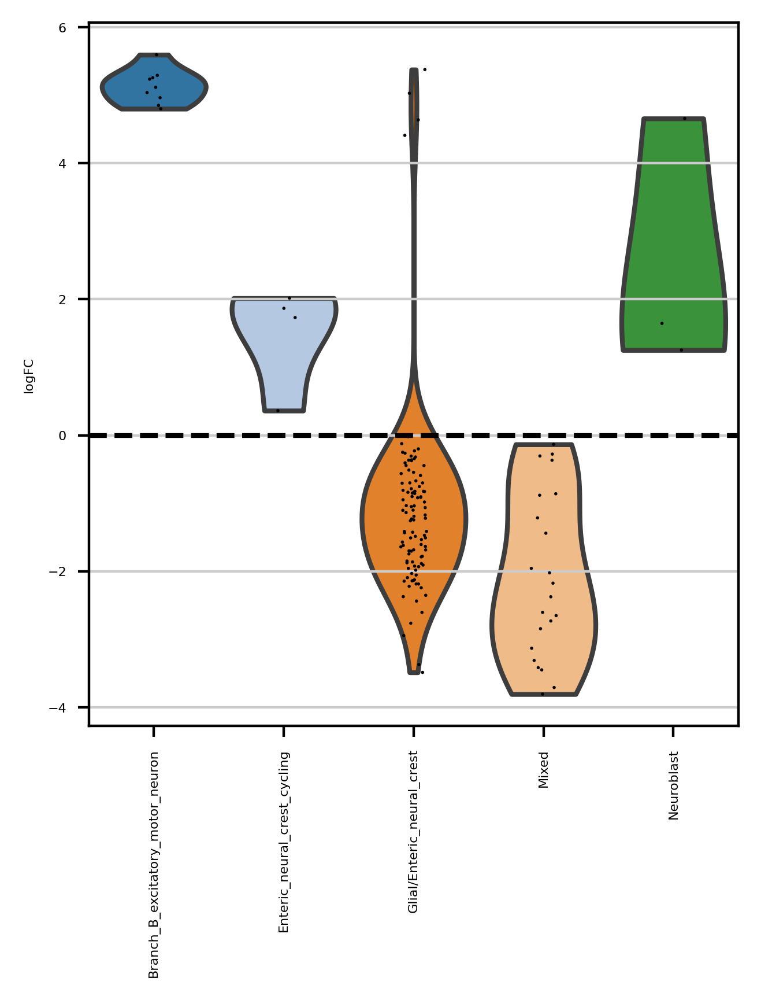

In [20]:
import matplotlib.pyplot as plt
for ct in adata.obs.level_1_annot.unique():
    milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == ct], anno_col='fine_annot')
    adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
    sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette='tab20');
    plt.axhline(y=0, color='black', linestyle='--');
    plt.show();

In [21]:
import seaborn as sns
sns.set_style(style="white")
sns.set_context(context="paper")

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


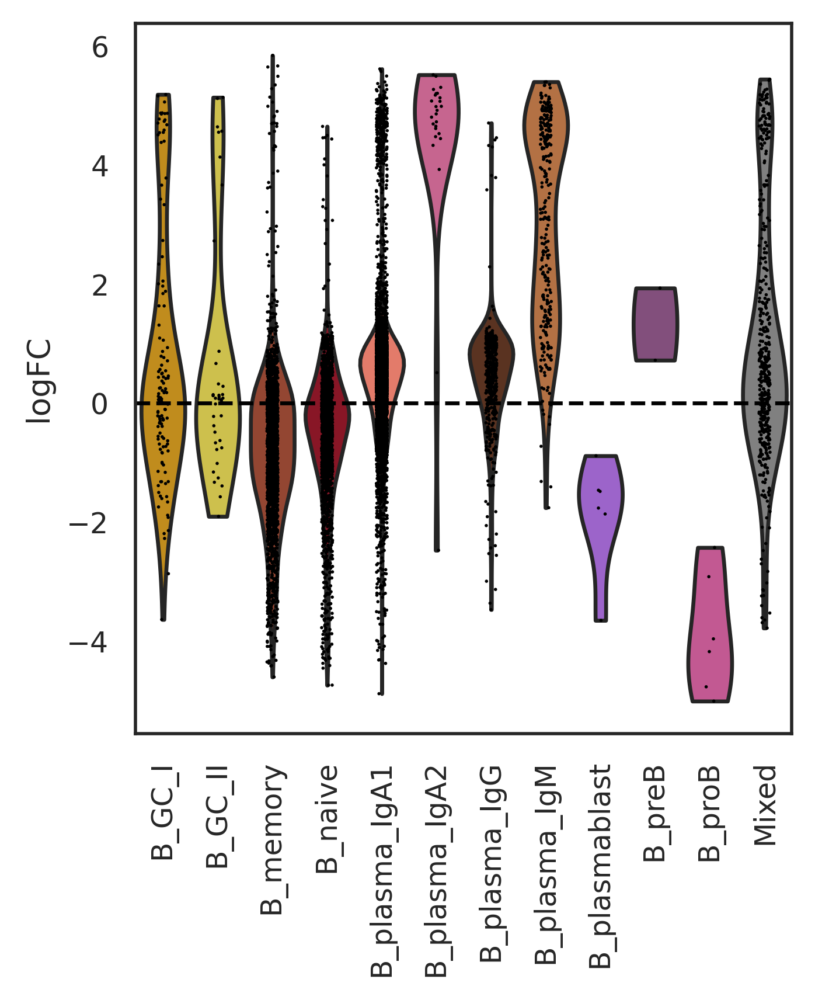

In [22]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'B and B plasma'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={'B_GC_I': '#db9602',
  'B_GC_II': '#e2d138',
  'B_memory': '#a33c22',
  'B_naive': '#9b0319',
  'B_plasma_IgA1': '#f76c56',
  'B_plasma_IgA2': '#d6558d',
  'B_plasma_IgG': '#632f17',
  'B_plasma_IgM': '#c66d31',
  'B_plasmablast': '#9e53db',
  'B_preB': '#8a4682',
  'B_proB': '#d34794',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oesophagus_BandBplasma_violin.pdf')
plt.show()

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


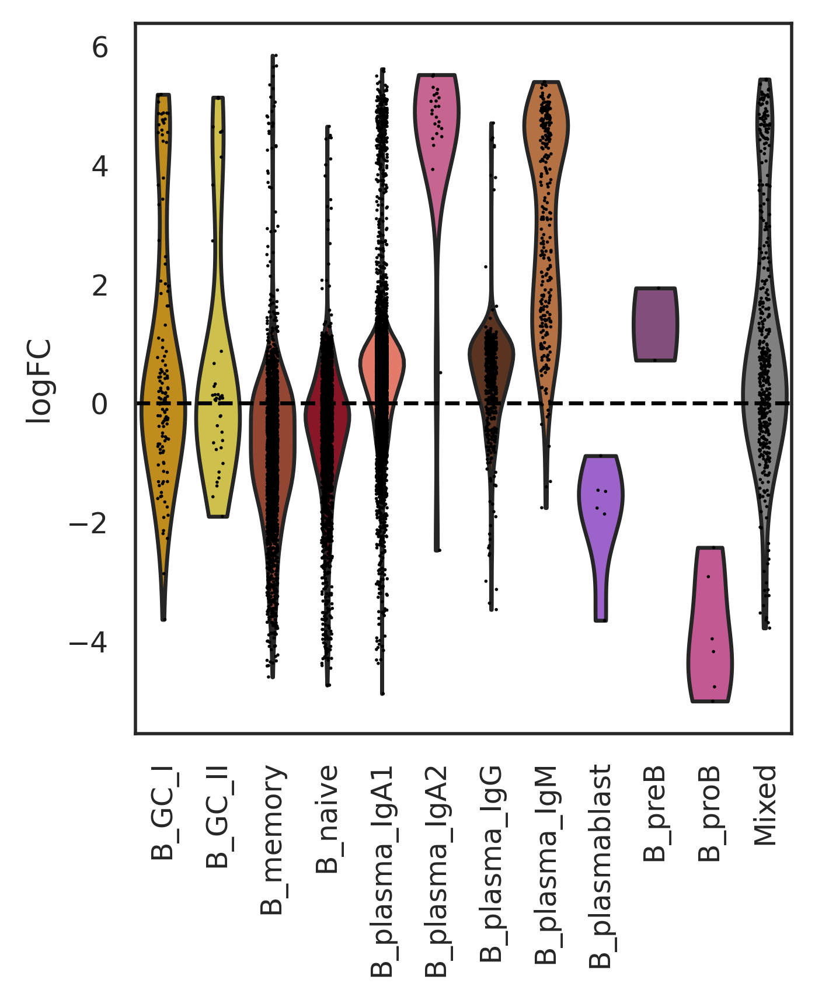

In [23]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'B and B plasma'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={'B_GC_I': '#db9602',
  'B_GC_II': '#e2d138',
  'B_memory': '#a33c22',
  'B_naive': '#9b0319',
  'B_plasma_IgA1': '#f76c56',
  'B_plasma_IgA2': '#d6558d',
  'B_plasma_IgG': '#632f17',
  'B_plasma_IgM': '#c66d31',
  'B_plasmablast': '#9e53db',
  'B_preB': '#8a4682',
  'B_proB': '#d34794',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oesophagus_BandBplasma_violin.png')
plt.show()

In [58]:
plt.rcParams["figure.figsize"] = [5, 3]

In [61]:
import seaborn as sns
sns.set_style(style="white")
sns.set_context(context="paper")

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


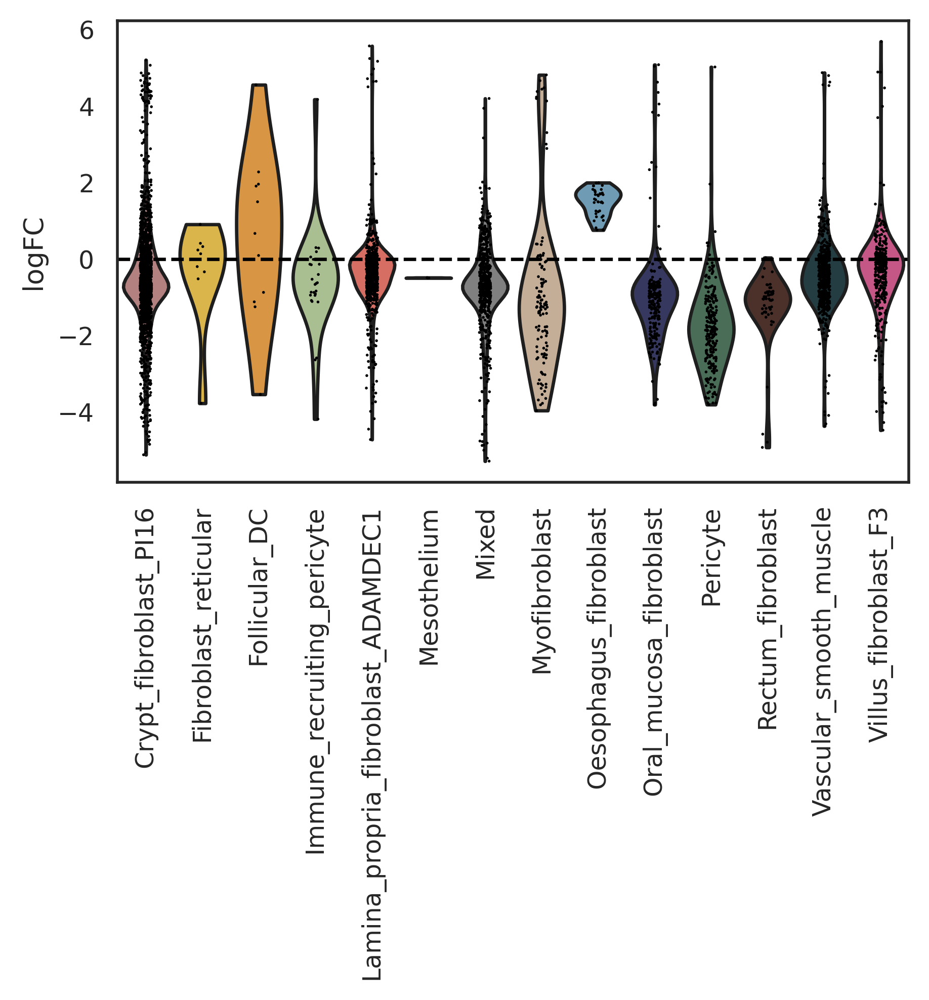

In [77]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oesophagus_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


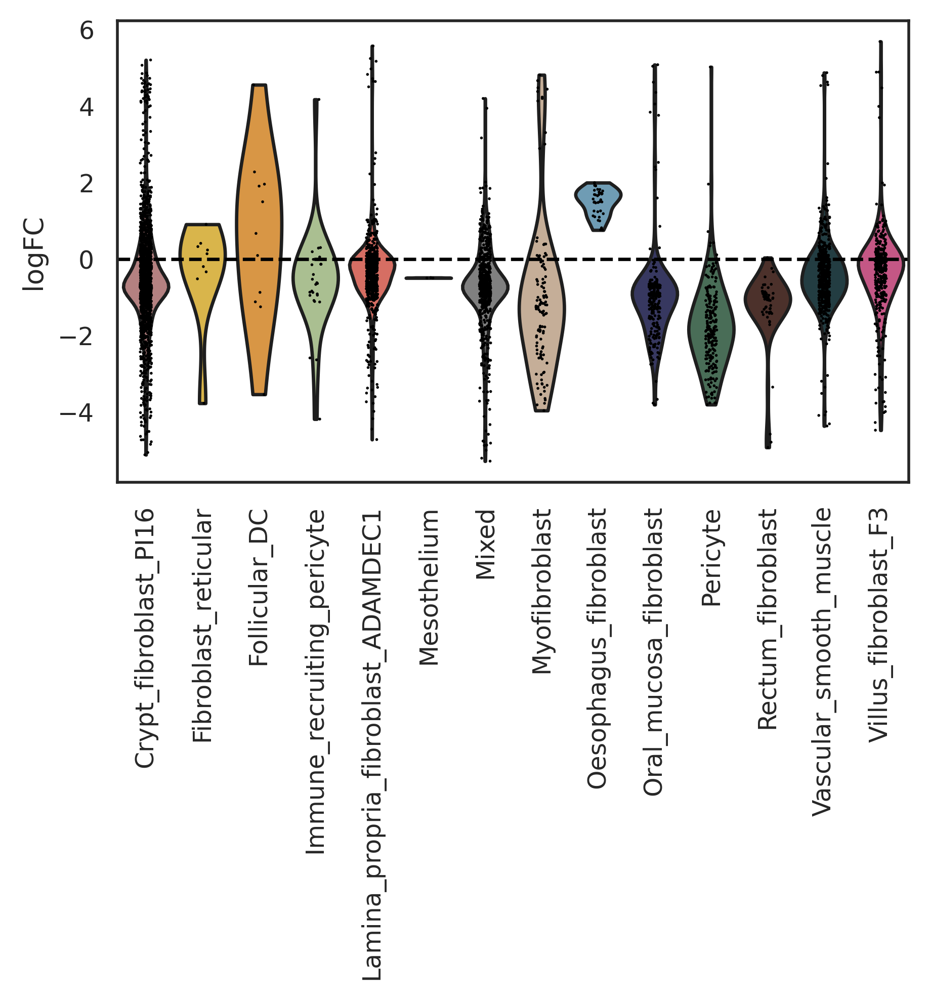

In [78]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oesophagus_Mes_violin.png')
plt.show()



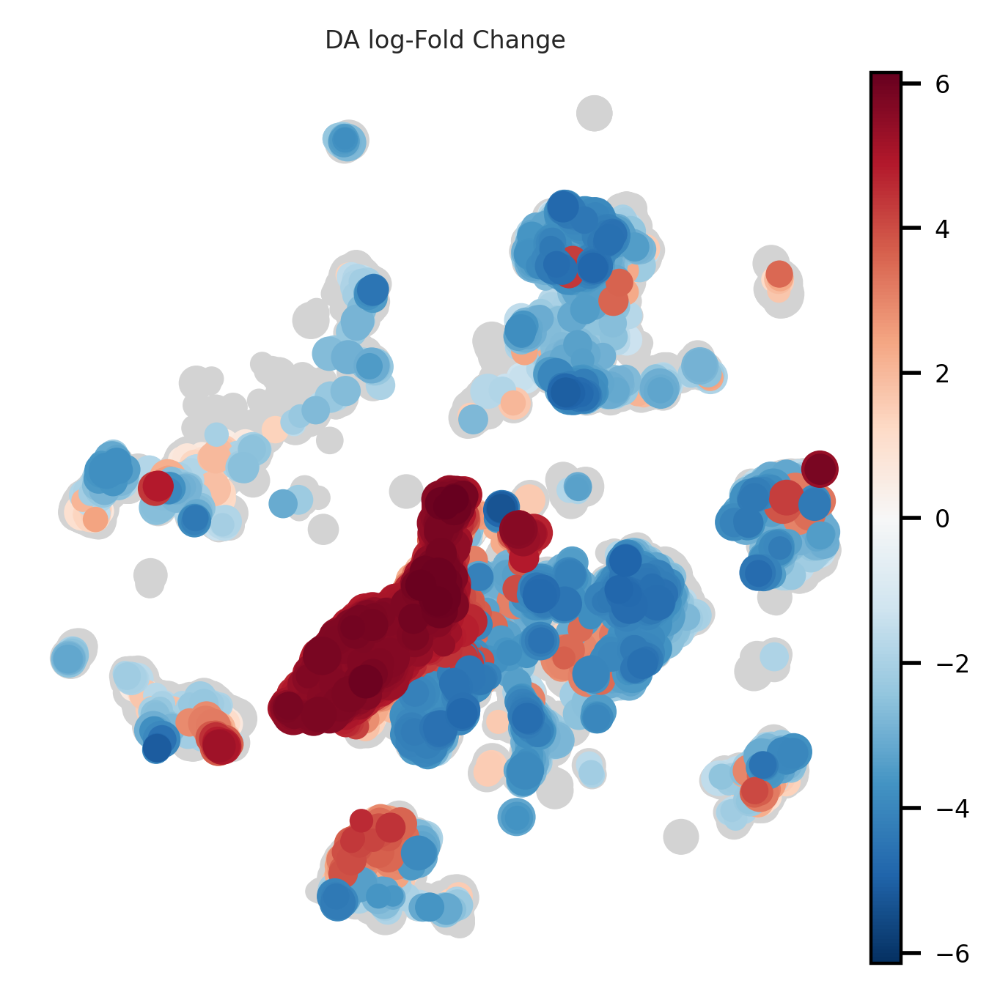

In [28]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=6,
    transparent=True,
)
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_oesophagus.pdf')

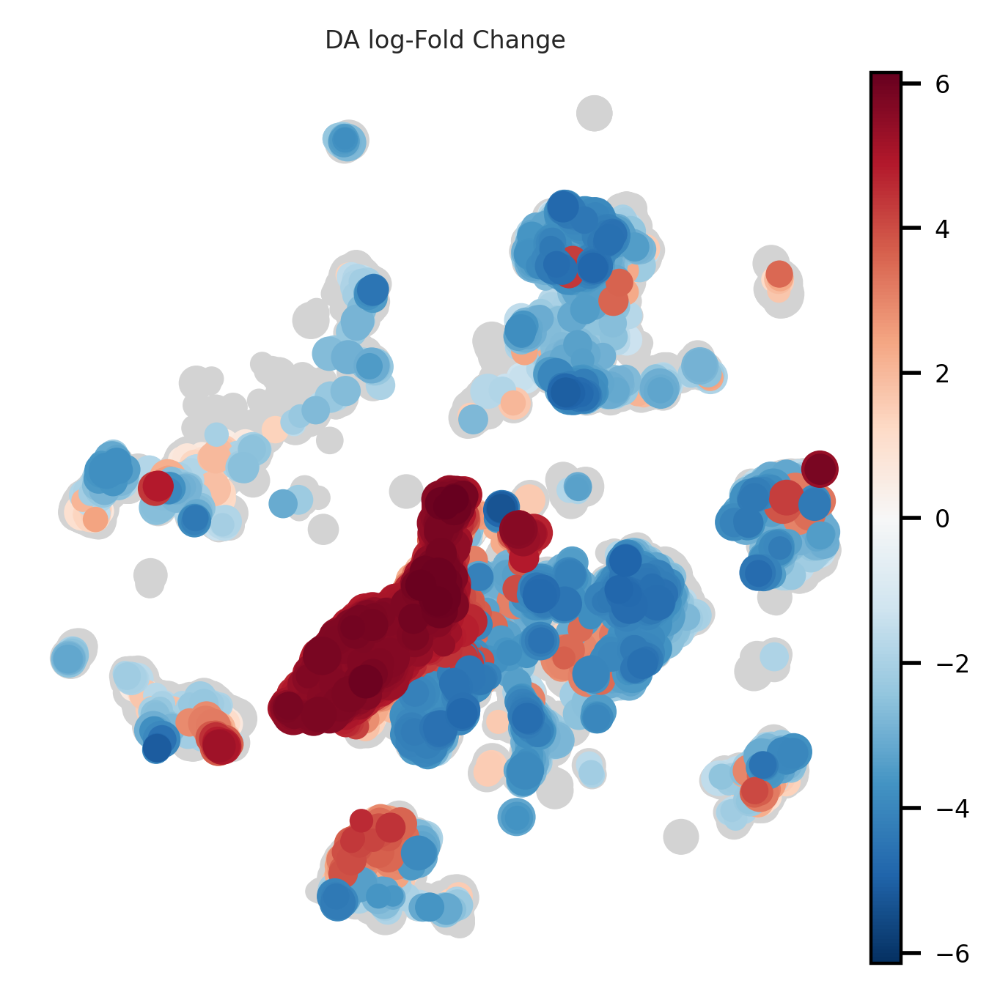

In [29]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_oesophagus.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


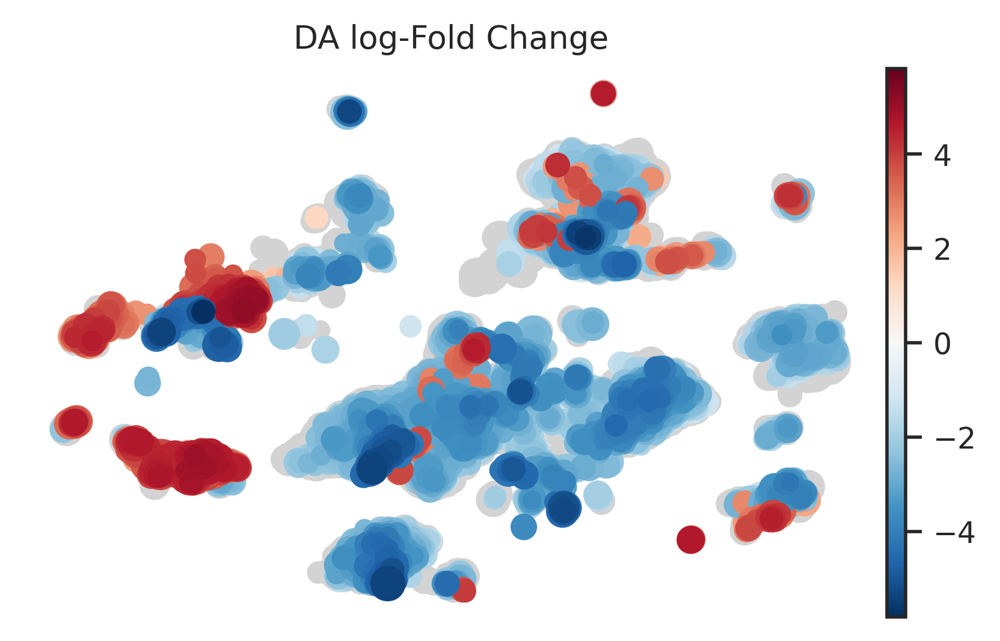

In [79]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_oral'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_oral.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


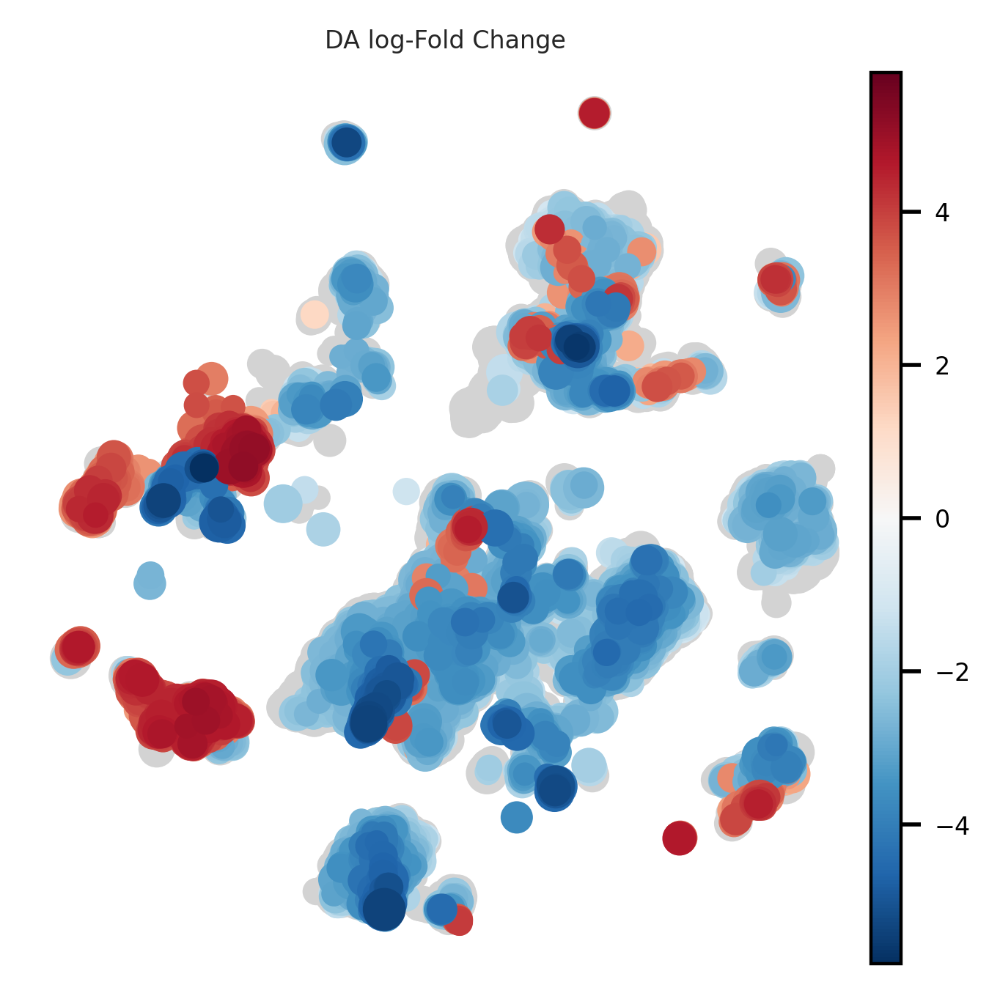

In [31]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_oral.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


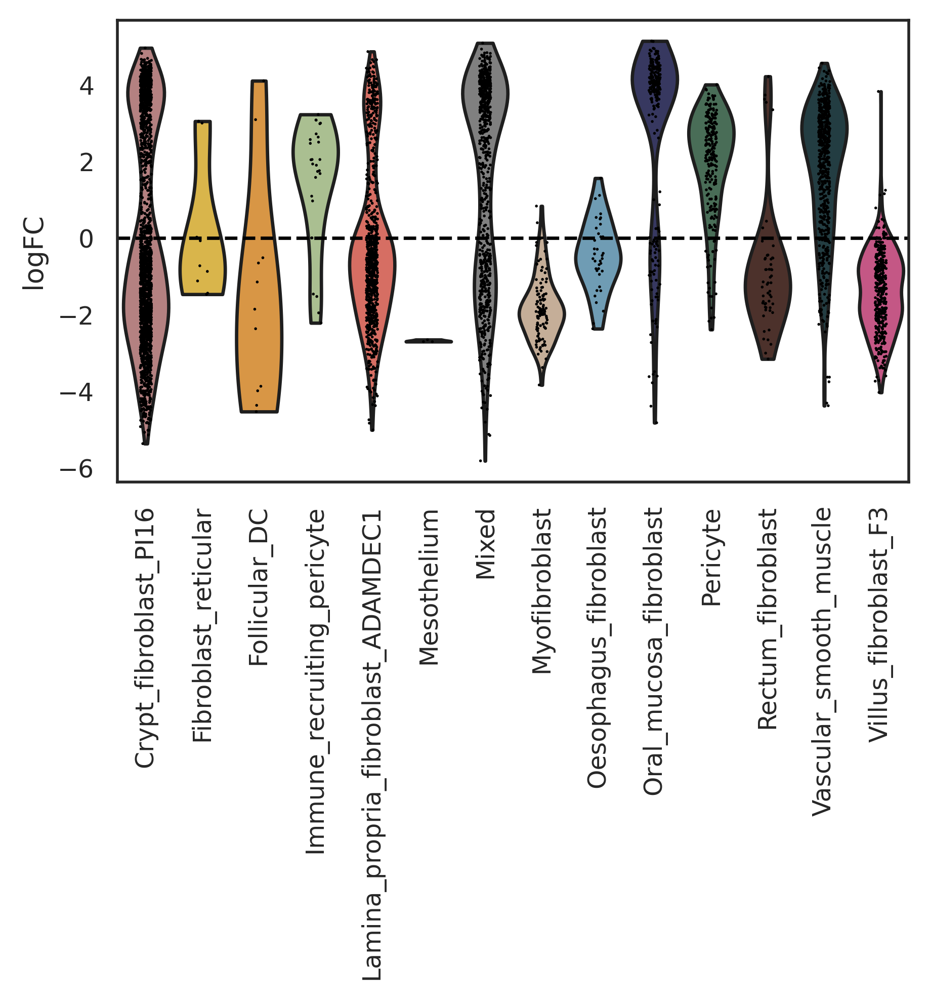

In [80]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oral_Mes_violin.pdf')
plt.show()

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


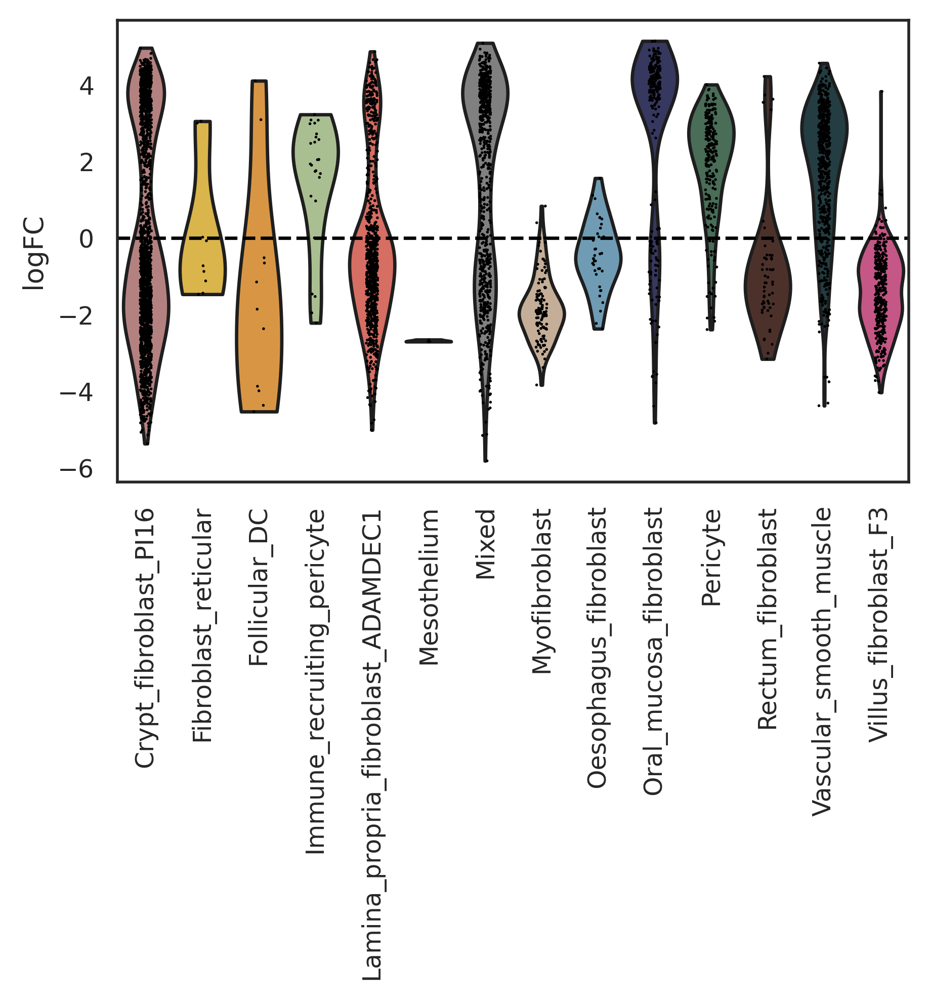

In [81]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_oral_Mes_violin.png')
plt.show()

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


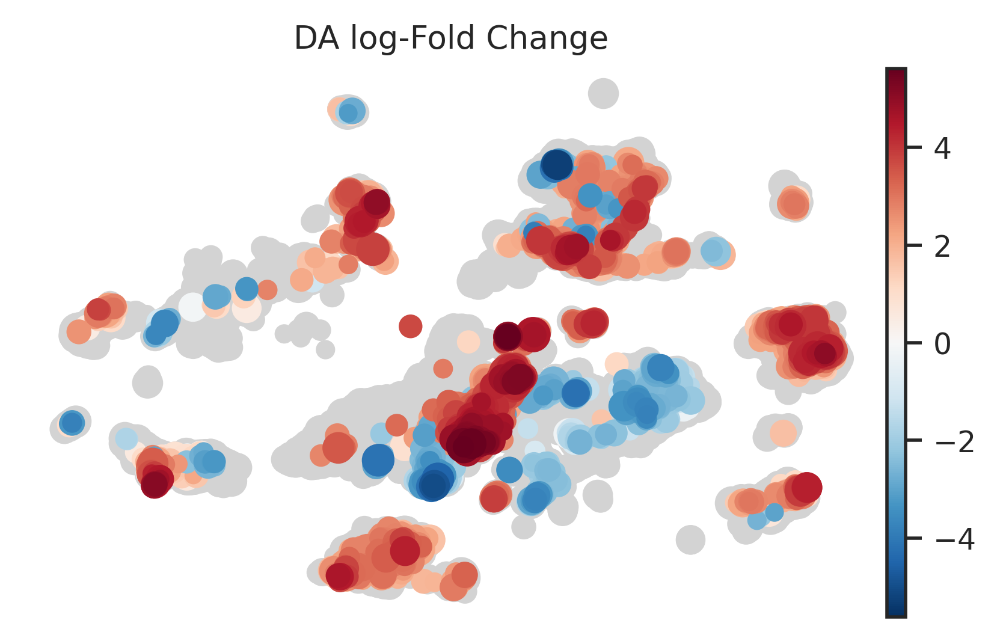

In [82]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_stomach'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_stomach.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


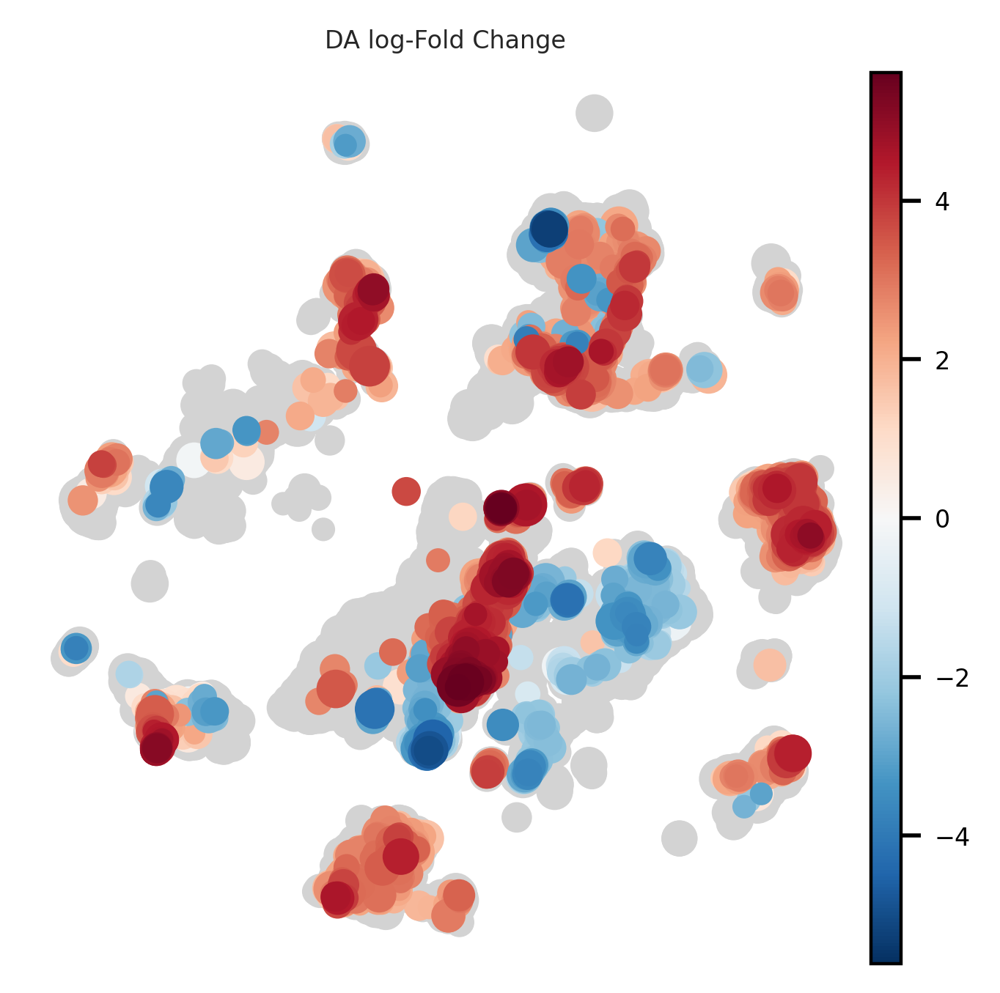

In [35]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_stomach.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


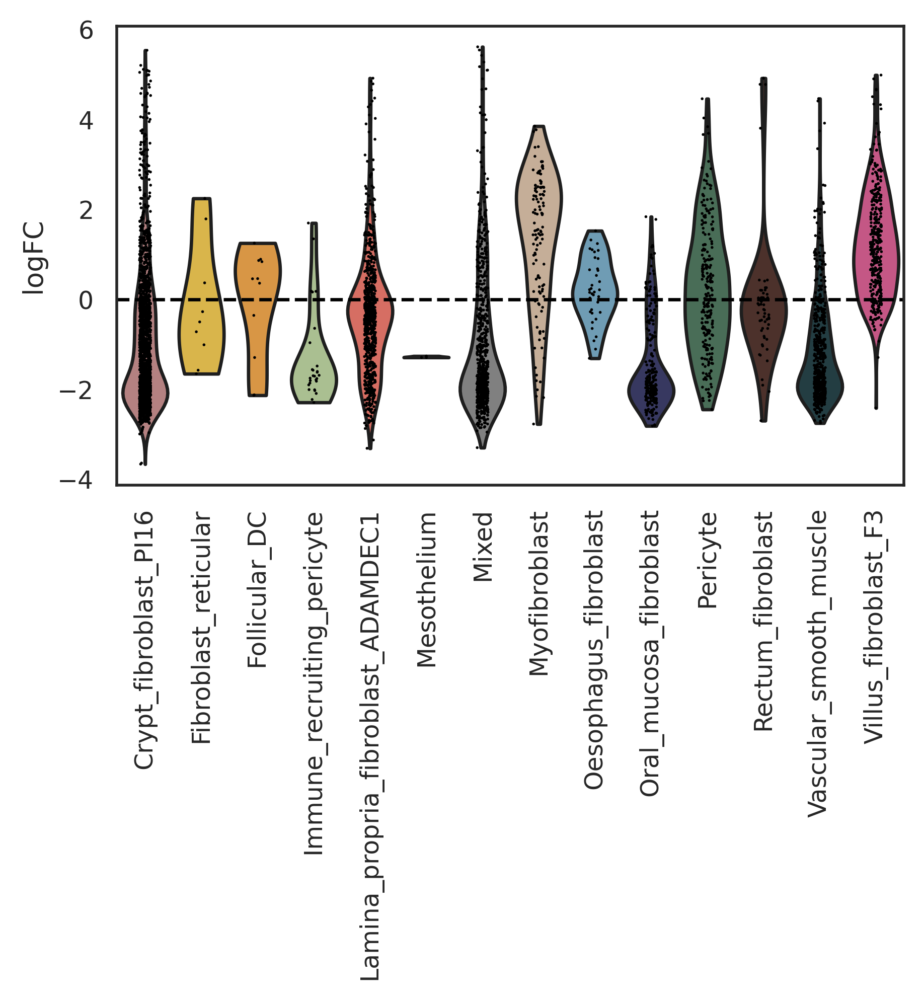

In [83]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_stomach_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


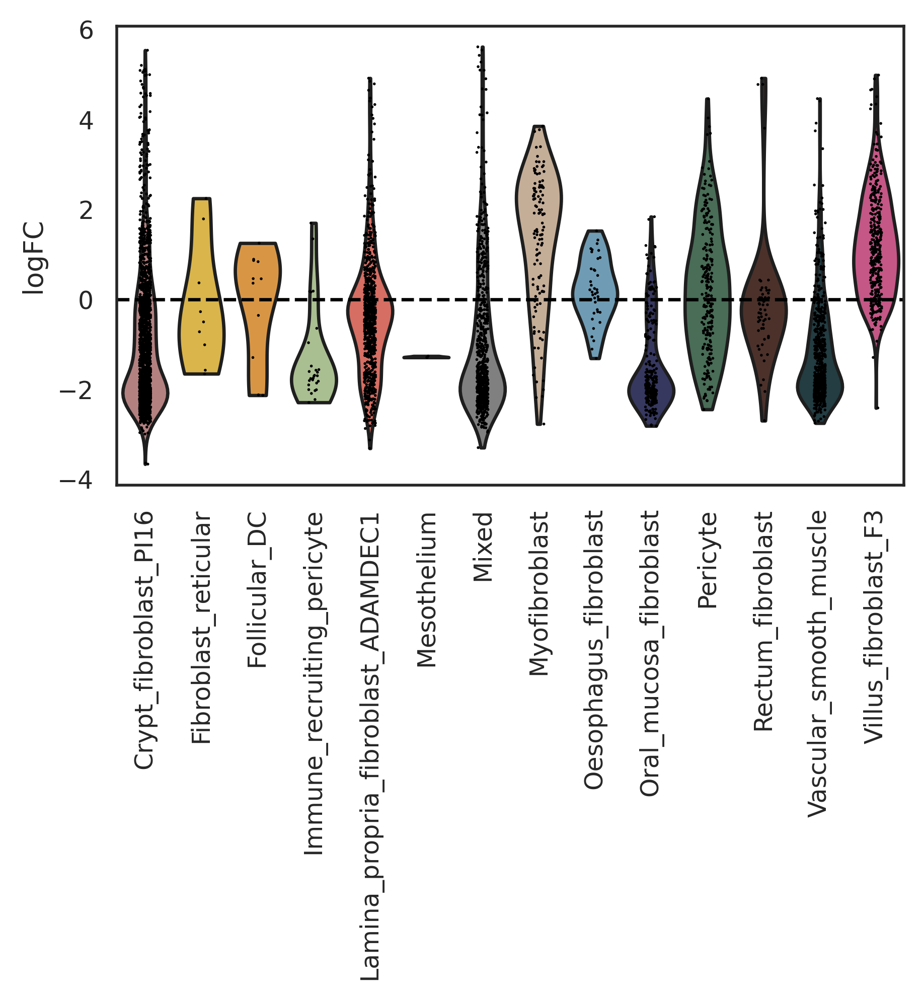

In [84]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_stomach_Mes_violin.png')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


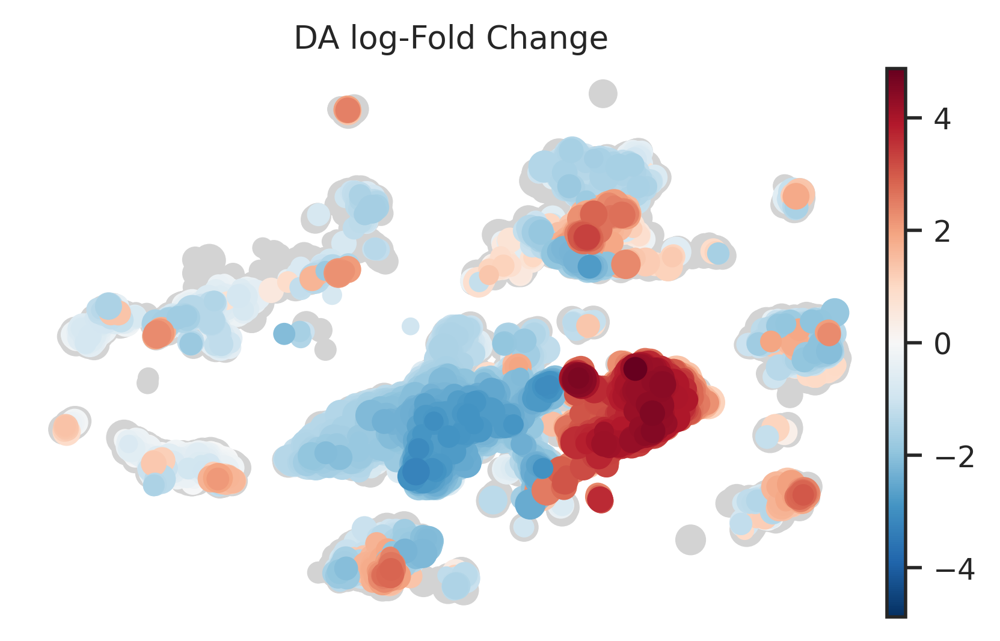

In [85]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_SI'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_SI.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


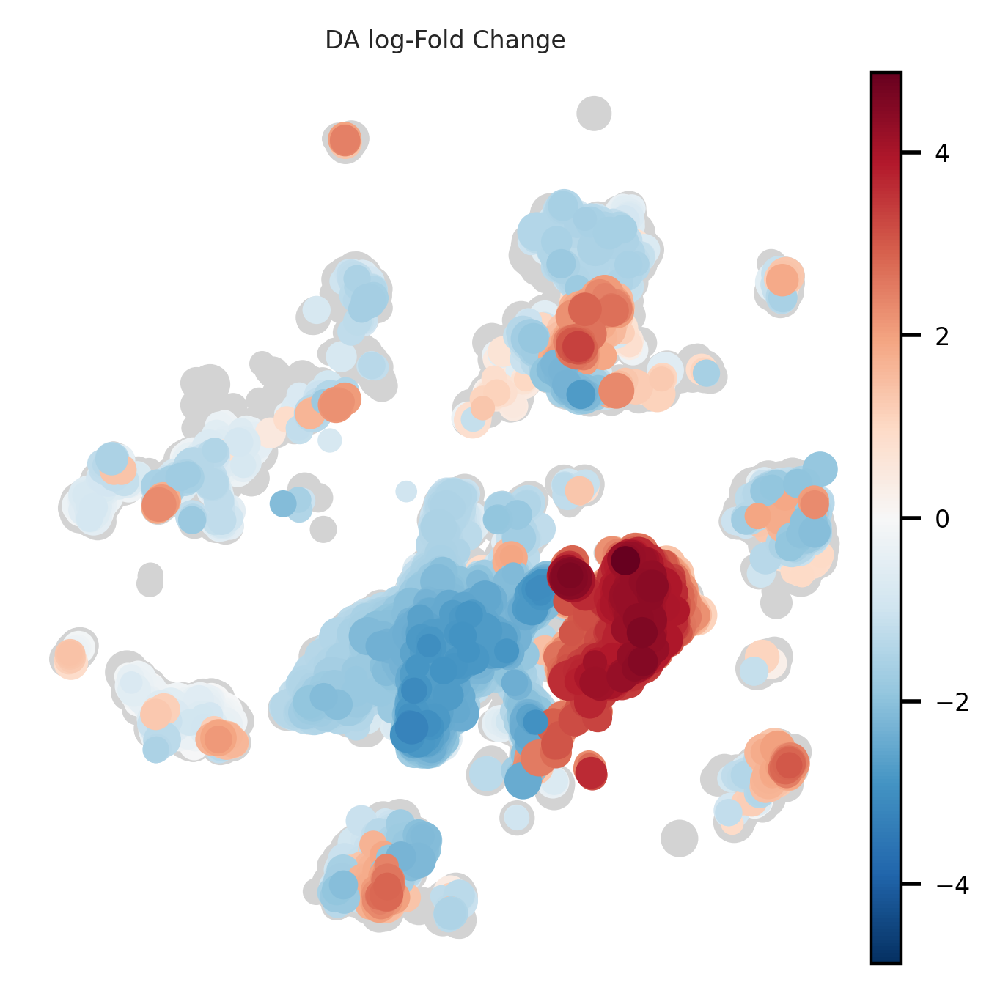

In [39]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_SI.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


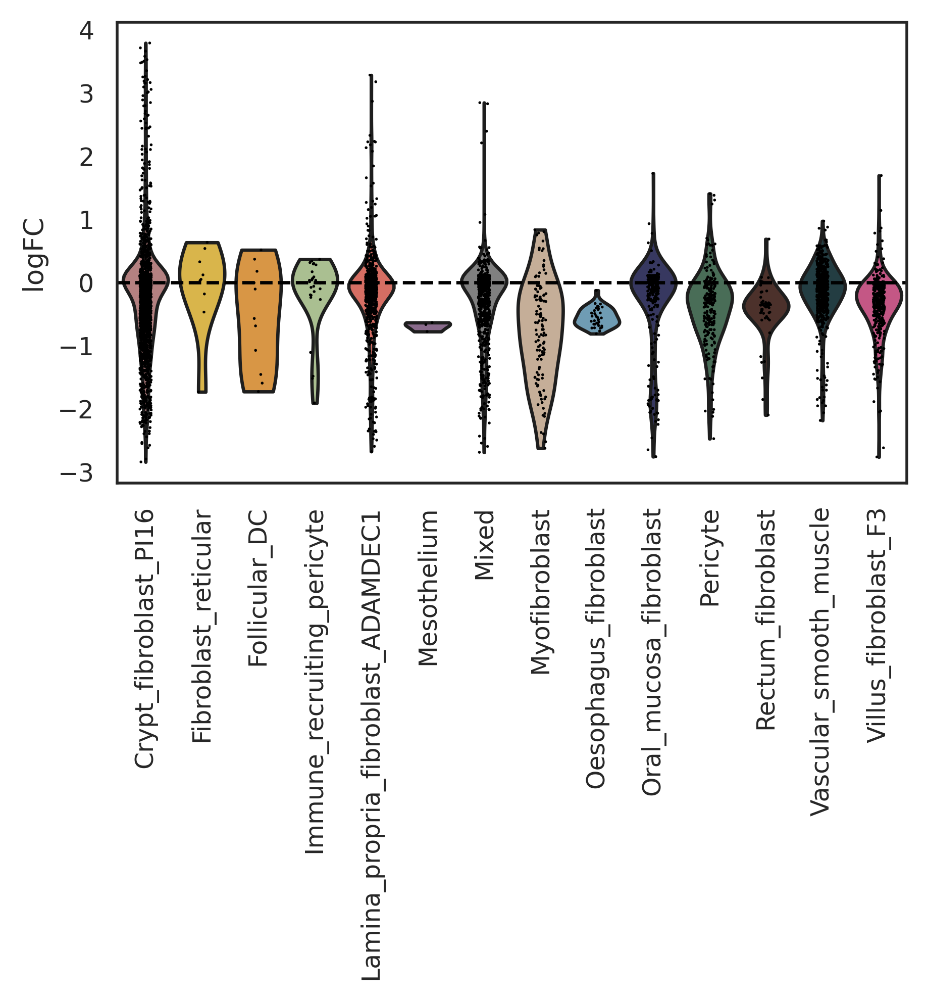

In [86]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_SI_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


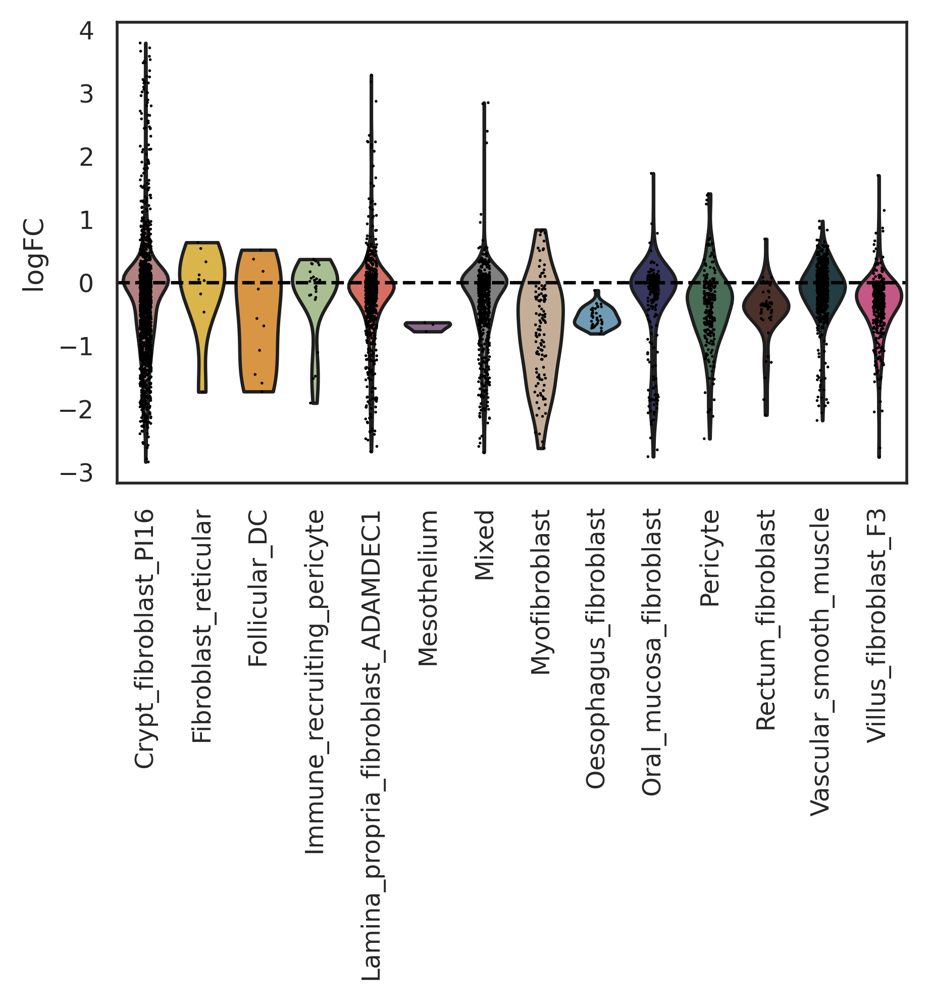

In [87]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_SI_Mes_violin.png')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


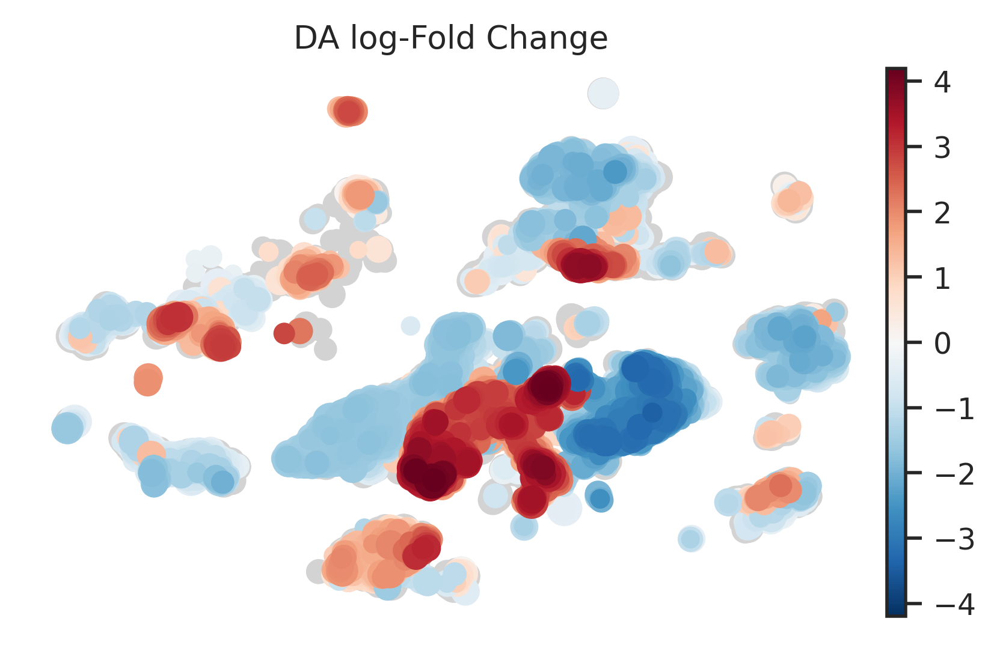

In [88]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_LI'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_LI.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


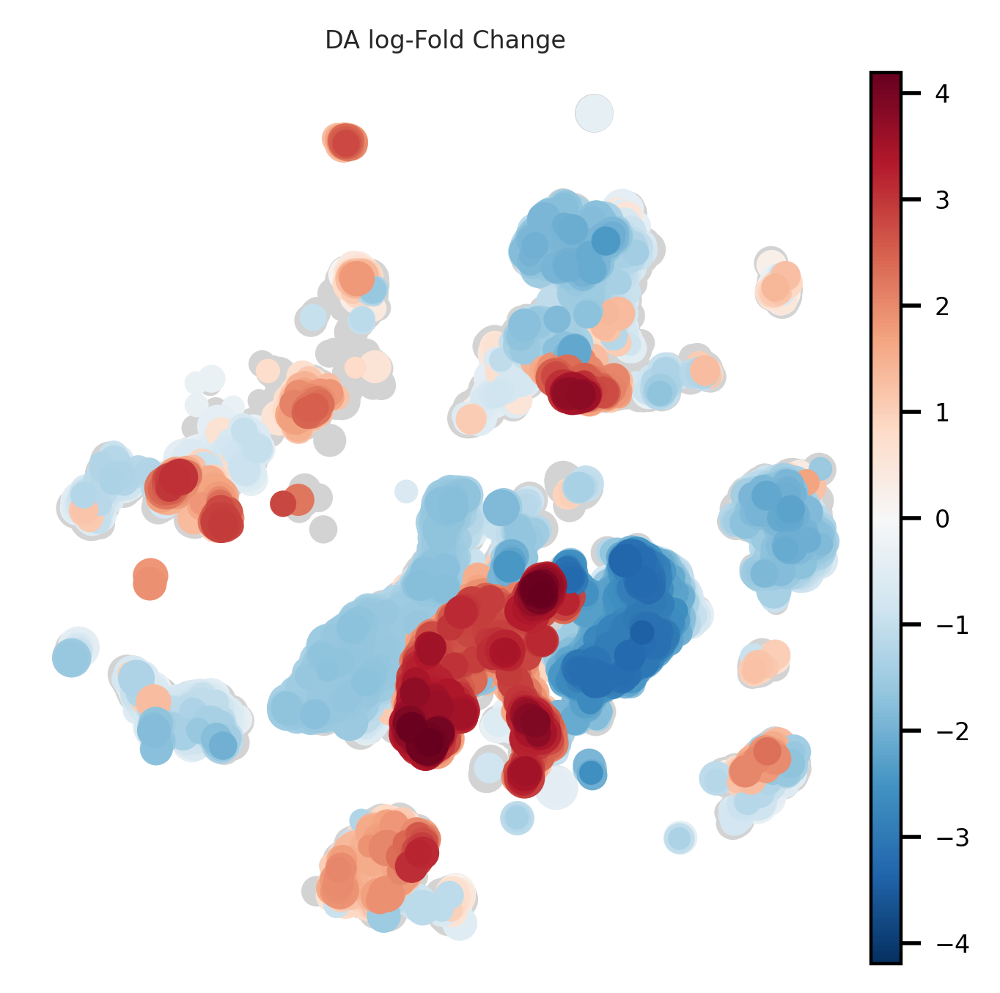

In [43]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_LI.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


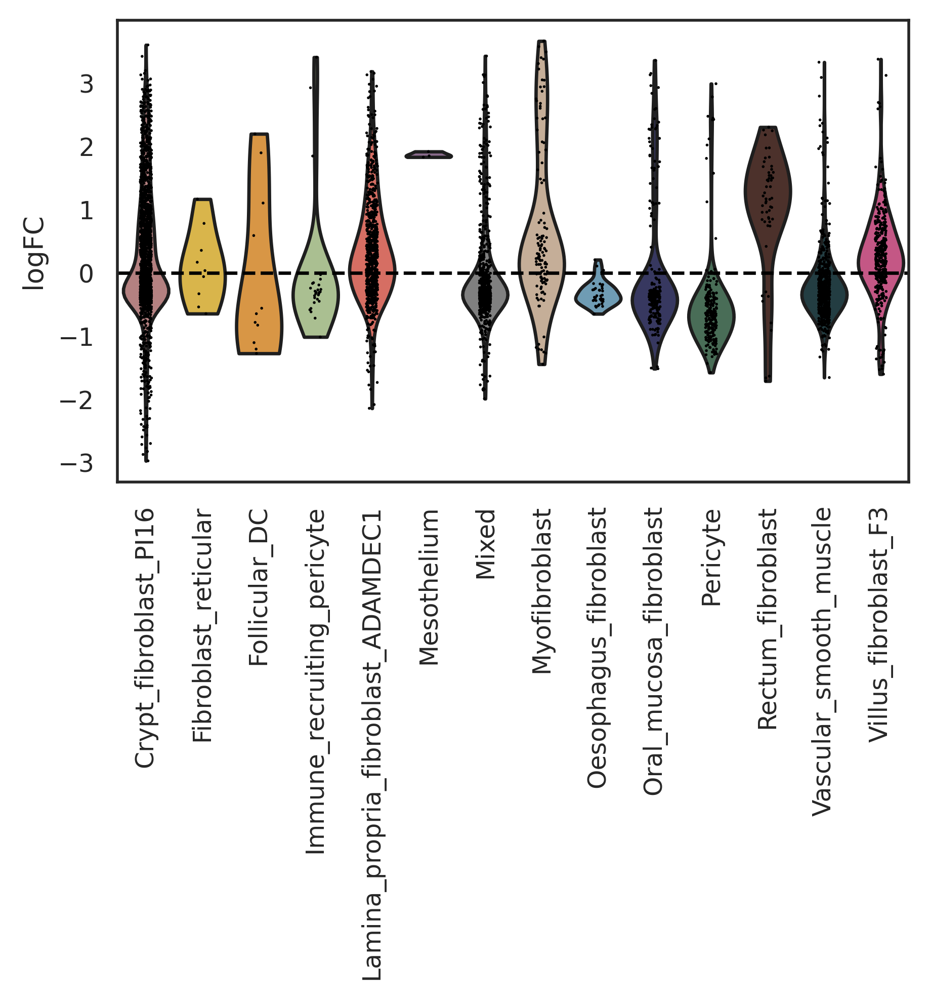

In [89]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_LI_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


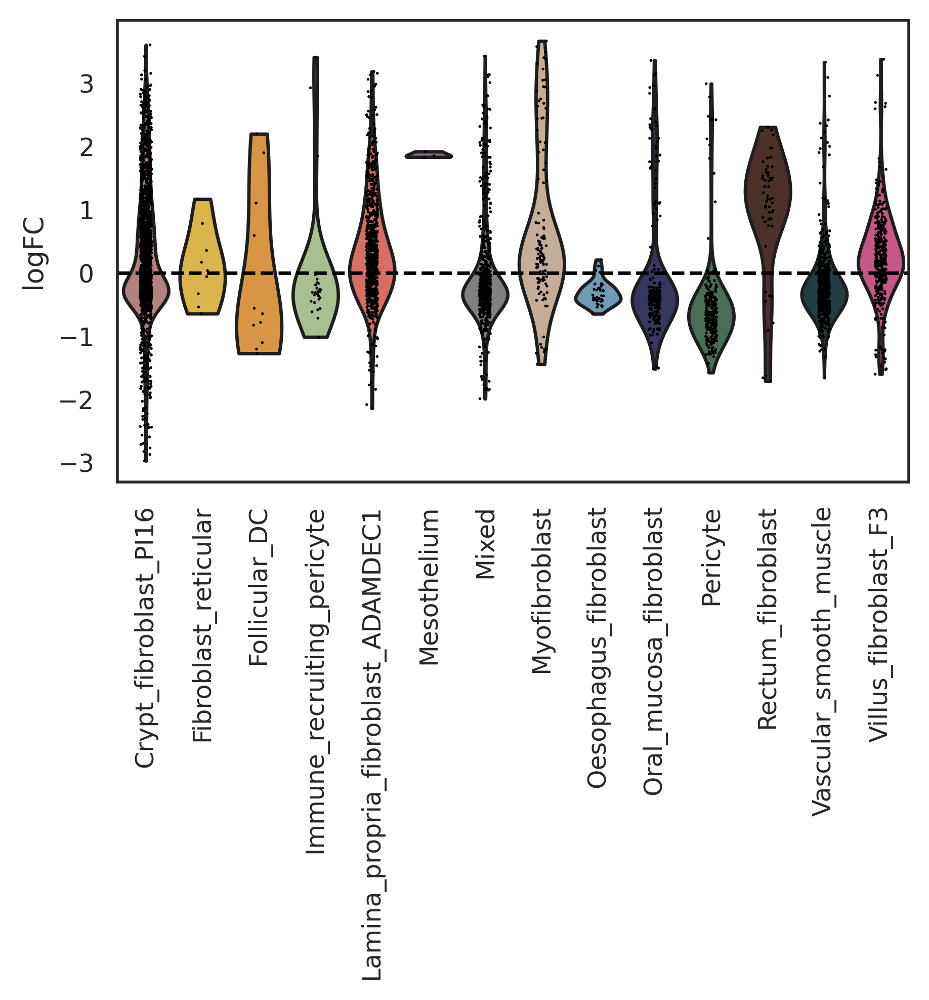

In [90]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_LI_Mes_violin.png')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


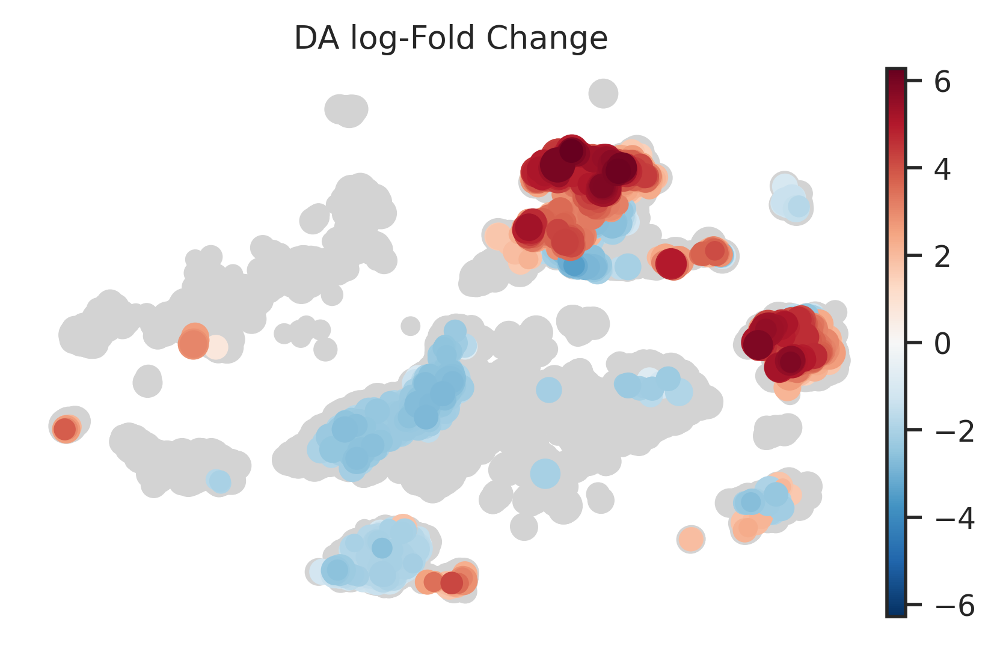

In [91]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_MLN'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_MLN.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


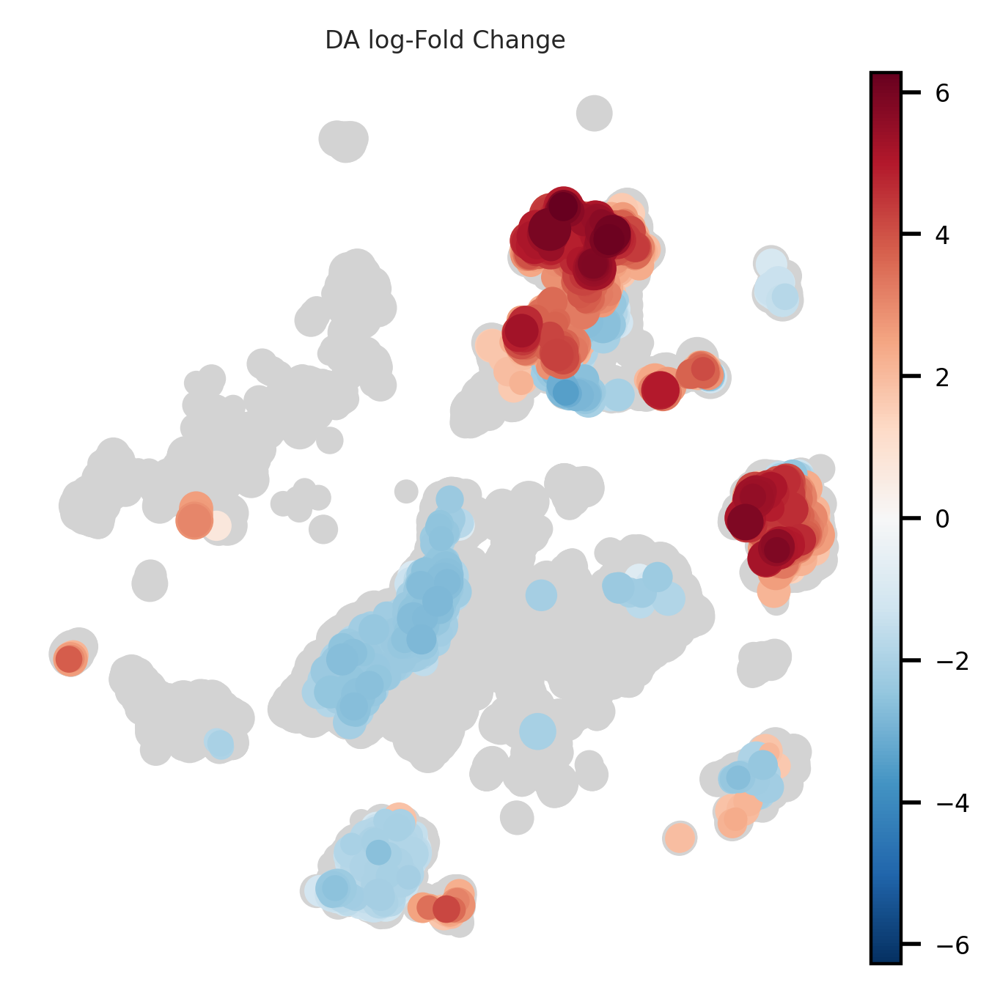

In [49]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_MLN.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


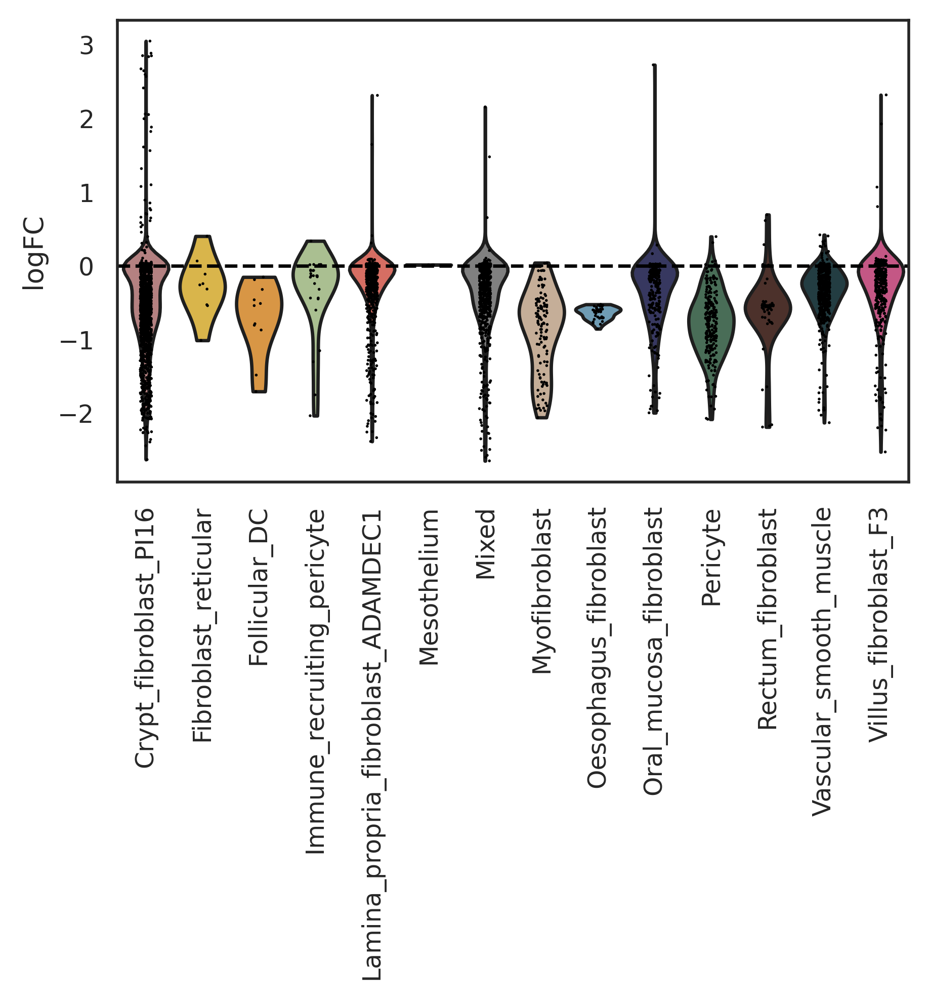

In [92]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_MLN_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


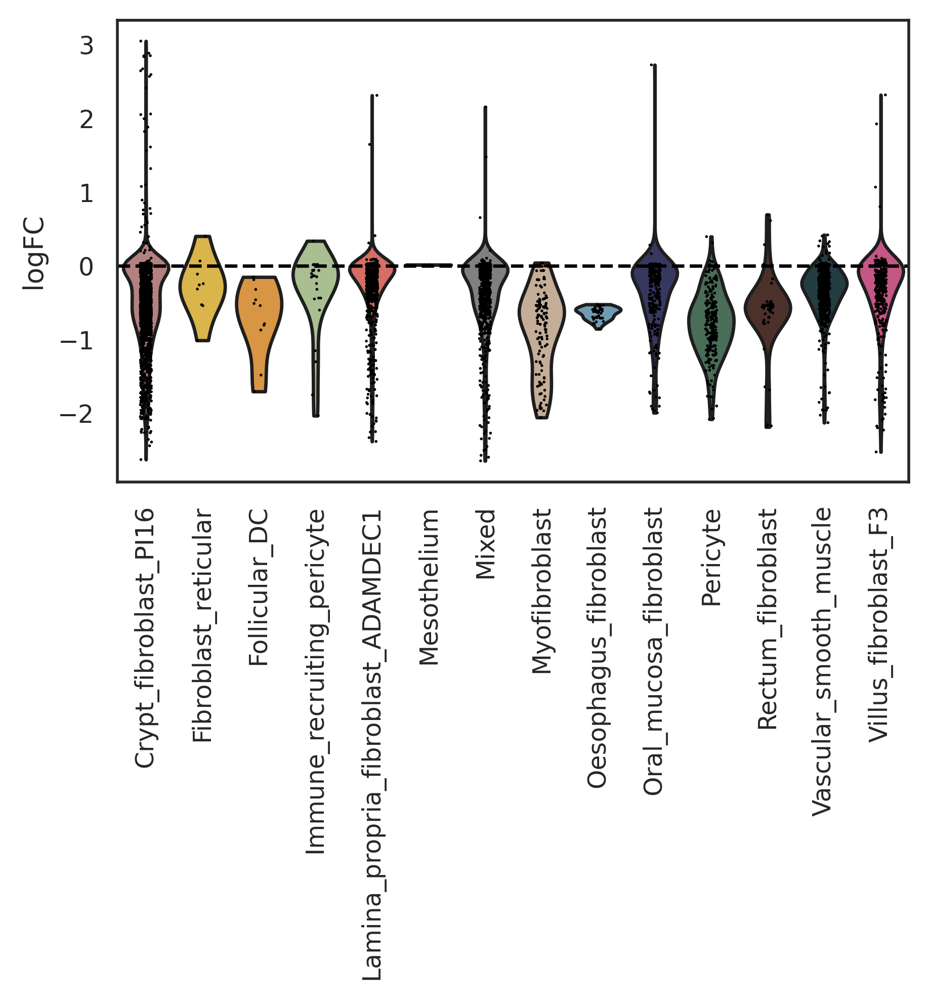

In [93]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_MLN_Mes_violin.png')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


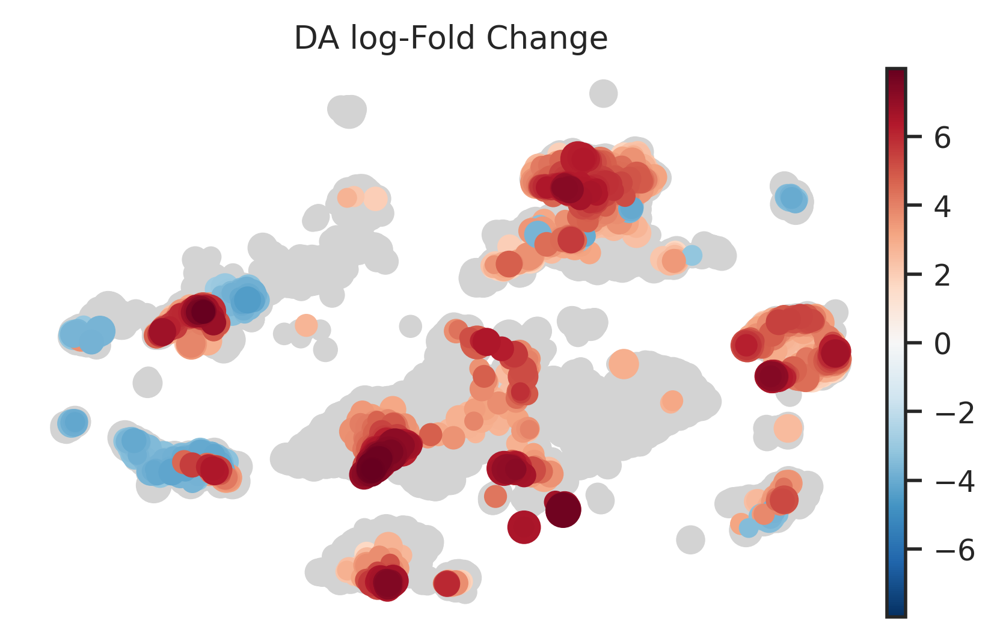

In [94]:
del adata.uns['nhood_adata'] 
adata.uns['nhood_adata'] = adata.uns['nhood_adata_salivary'].copy()
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_salivary.pdf')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


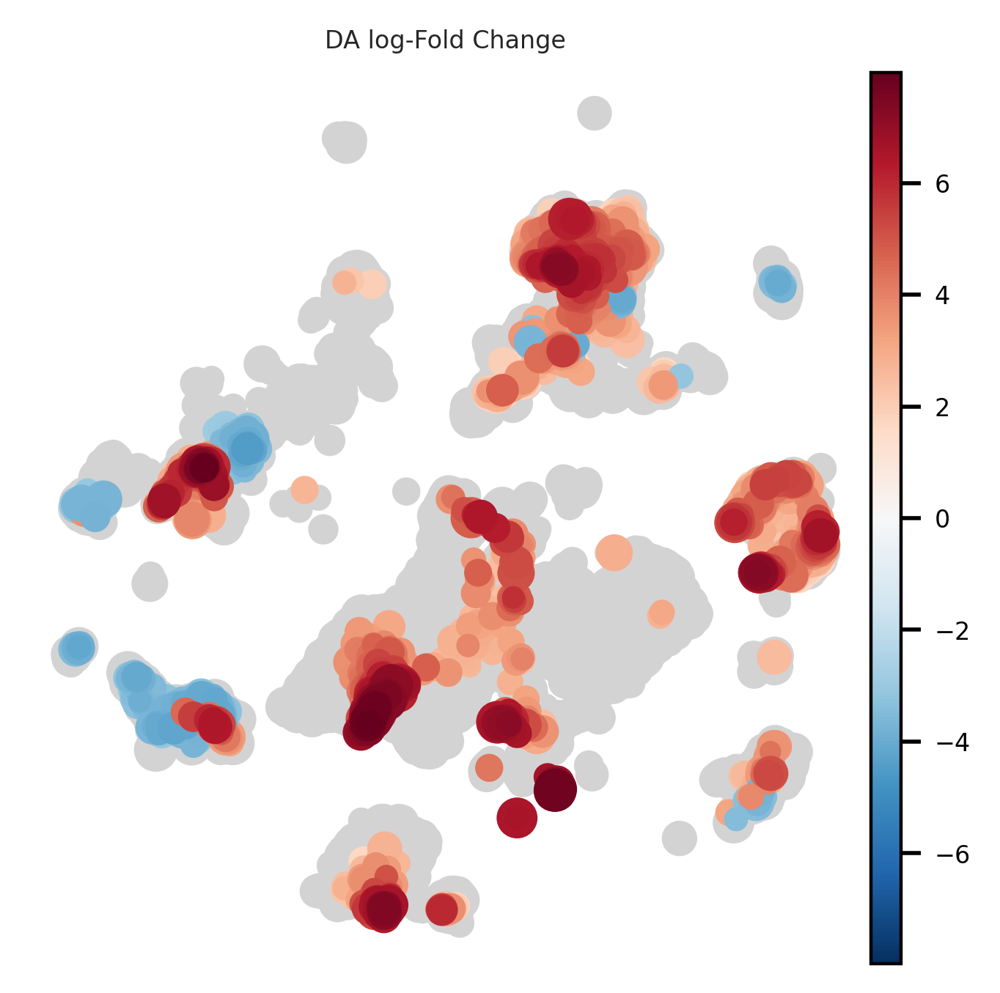

In [53]:
milopl.plot_nhood_graph(adata, 
                        alpha=0.01, ## SpatialFDR level (1%) 
                        min_size=2 ## Size of smallest dot
                       ,save='milo_DA_salivary.png')

/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


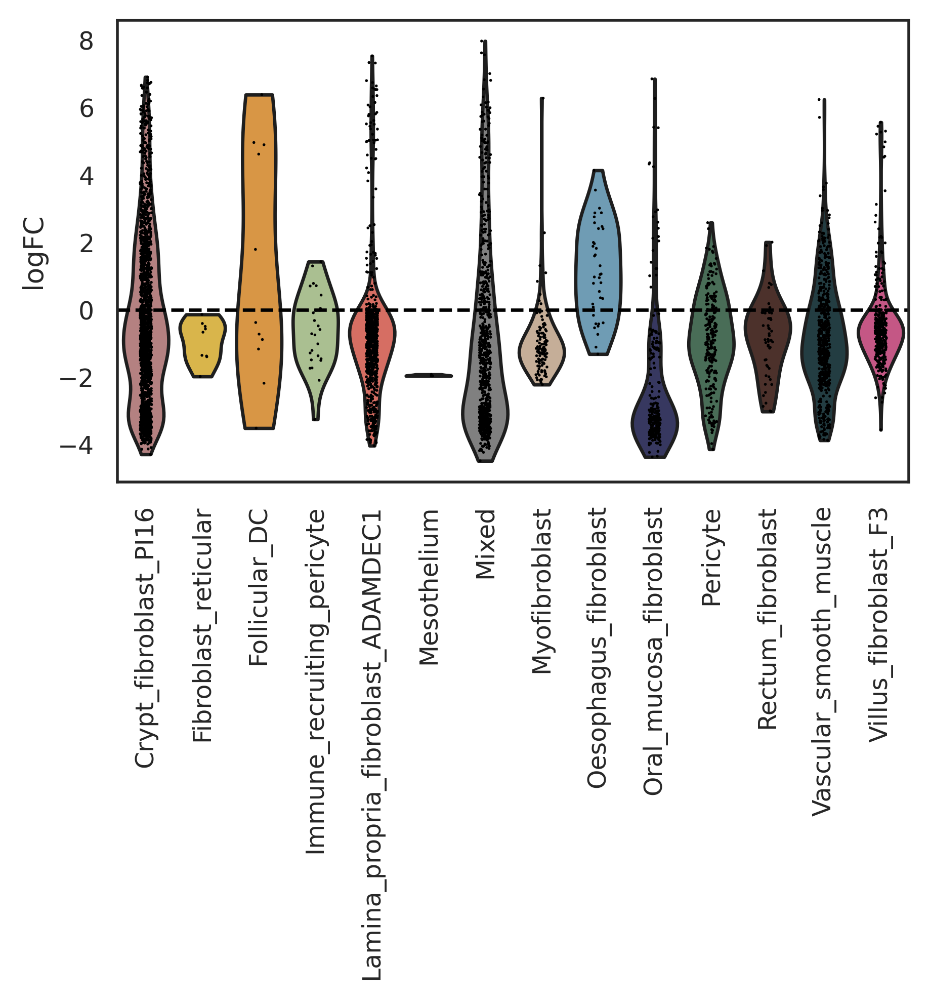

In [95]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_salivary_Mes_violin.pdf')
plt.show()



/home/jovyan/my-conda-envs/milo_clone/lib/python3.10/site-packages/scipy/sparse/_base.py:658: RuntimeWarning: invalid value encountered in true_divide
  return np.true_divide(self.todense(), other)


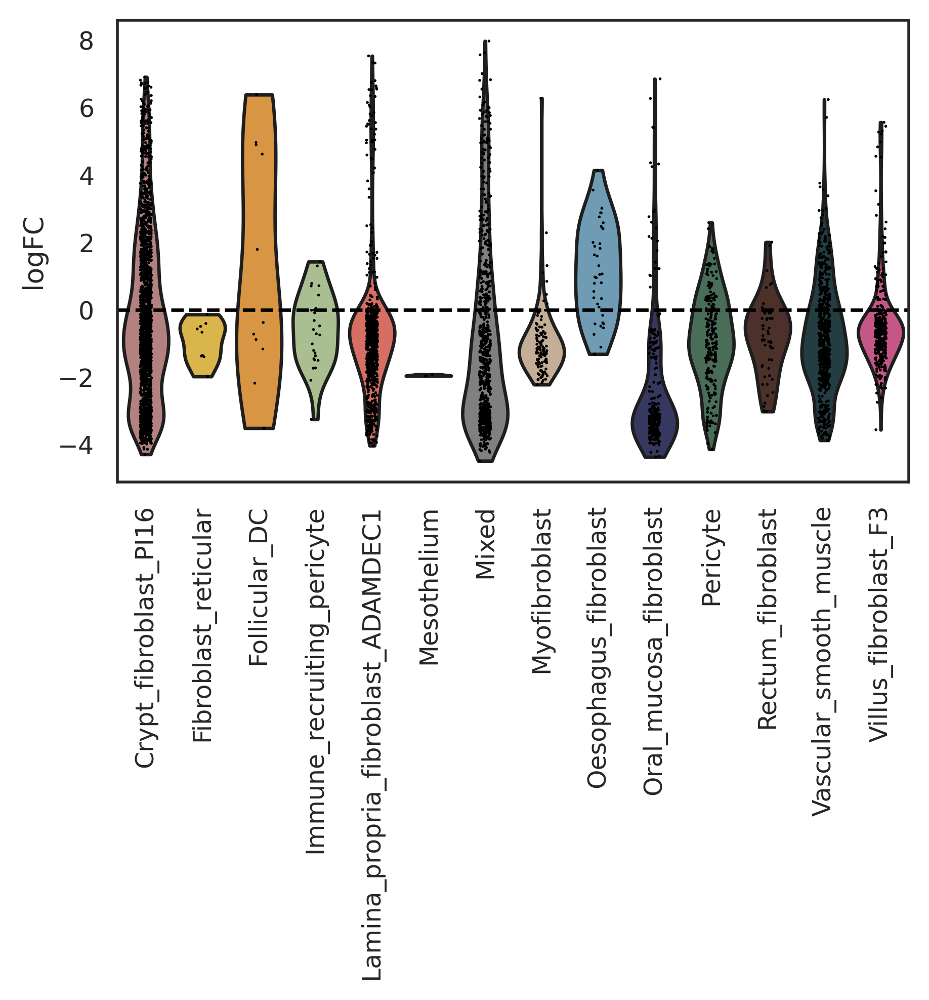

In [96]:
milopy.utils.annotate_nhoods(adata[adata.obs.level_1_annot == 'Mesenchymal'], anno_col='fine_annot')
adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs.loc[adata[adata.obs.level_1_annot == ct].uns['nhood_adata'].obs["nhood_annotation_frac"] < 0.6, "nhood_annotation"] = "Mixed"
sc.pl.violin(adata[adata.obs.level_1_annot == ct].uns['nhood_adata'], "logFC", groupby="nhood_annotation", rotation=90, show=False,palette={
  'Crypt_fibroblast_PI16': '#bd7879',
           'Follicular_DC':'#f0982c',
           'Immune_recruiting_pericyte':'#AAC789',
           'Lamina_propria_fibroblast_ADAMDEC1':'#e95e50',
           'Mesothelium':'#8F6592',
           'Myofibroblast':'#CCAE91',
           'Oesophagus_fibroblast':'#63A0C0',
           'Oral_mucosa_fibroblast':'#303267',
          'Pericyte':'#437356',
           'Rectum_fibroblast':'#522e25',
          'Fibroblast_reticular':'#f0c134',
           'Vascular_smooth_muscle':'#1E4147',
           'Villus_fibroblast_F3':'#d64582',
 'Mixed':'#808080'
})
plt.axhline(y=0, color='black', linestyle='--')
plt.savefig('milo_salivary_Mes_violin.png')
plt.show()

